# Data Prep

In [1]:
import pandas as pd
import numpy as np
import random
import ast
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.cluster import SpectralClustering
from sklearn.metrics.cluster import adjusted_rand_score, rand_score

random.seed(42)

df = pd.read_csv("data.csv")
df

,author,prompt,response,bert,roberta,opt,llama,common,function
0,reddit,Killing Hitler has become a sport amongst time...,* Magnificient work ! Truly inspiring ! * Hein...,"[-0.006725453305989504, 0.23576399683952332, -...","[-0.04180792719125748, 0.040072135627269745, -...","[-0.7724277377128601, -1.4468441009521484, -3....","[2.265625, 0.82666015625, 0.69775390625, 0.782...","[4, 3, 5, 1, 4, 3, 6, 0, 0, 0, 0, 1, 0, 1, 1, ...","[4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
1,reddit,Killing Hitler has become a sport amongst time...,Even by my standards this one took some work ....,"[0.07968071103096008, -0.020308567211031914, 0...","[-0.02620106004178524, 0.02632817253470421, -0...","[-0.11295819282531738, -1.027052640914917, -2....","[0.9736328125, -2.439453125, 1.4921875, -0.757...","[8, 6, 6, 2, 4, 3, 7, 0, 0, 1, 0, 1, 0, 4, 2, ...","[4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
2,reddit,Killing Hitler has become a sport amongst time...,"So , we can now time travel into the future . ...","[-0.12700289487838745, 0.3927253186702728, -0....","[-0.04244694486260414, 0.010937012732028961, -...","[-5.222697734832764, -2.8652701377868652, -3.3...","[0.06005859375, -1.708984375, -0.457275390625,...","[8, 5, 2, 2, 1, 3, 5, 2, 0, 2, 0, 0, 0, 3, 1, ...","[1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, ..."
3,reddit,Killing Hitler has become a sport amongst time...,"Dear POTUS , The future is amazing . After pea...","[0.3432272970676422, -0.2167324721813202, 0.15...","[-0.025556232780218124, 0.06068963184952736, -...","[2.4253904819488525, -4.577791690826416, -3.37...","[1.6201171875, -3.439453125, -1.546875, -1.0, ...","[5, 5, 5, 3, 3, 1, 4, 1, 0, 1, 0, 0, 0, 2, 1, ...","[3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, ..."
4,reddit,Killing Hitler has become a sport amongst time...,"When doing this kind of stuff , it 's good to ...","[-0.2912406027317047, 0.12030187994241714, 0.0...","[-0.029593346640467644, 0.066276416182518, -0....","[-1.9841090440750122, 0.004299342632293701, -2...","[0.305908203125, 1.208984375, 3.591796875, -0....","[7, 9, 3, 0, 5, 3, 6, 2, 0, 0, 0, 0, 1, 1, 3, ...","[5, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, ..."
...,...,...,...,...,...,...,...,...,...
6195,gemini,"To get in Heaven, you have to confront the per...",In the hushed tranquility of the celestial rea...,"[-0.16426882147789001, 0.16457293927669525, -0...","[-0.016211245208978653, 0.06866081804037094, -...","[-1.8663527965545654, -3.4808688163757324, -2....","[0.7861328125, -1.6962890625, 2.23828125, -0.7...","[23, 11, 14, 9, 9, 6, 21, 7, 0, 5, 0, 4, 0, 6,...","[9, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, ..."
6196,gemini,"To get in Heaven, you have to confront the per...","As I arrived at the pearly gates of Heaven , m...","[-0.11653857678174973, 0.3063790202140808, -0....","[-0.025263268500566483, 0.057814307510852814, ...","[-0.4610805809497833, -4.71753454208374, -3.81...","[0.57470703125, -2.1953125, 0.9580078125, 0.04...","[23, 16, 14, 7, 12, 6, 36, 3, 2, 3, 0, 2, 1, 5...","[12, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,..."
6197,gemini,"To get in Heaven, you have to confront the per...","In the ethereal realm , where clouds caressed ...","[-0.1640430986881256, 0.024861453101038933, -0...","[-0.024055898189544678, 0.08036021888256073, -...","[-0.8870304822921753, -4.3331685066223145, 0.1...","[0.7978515625, -2.126953125, 1.701171875, -1.2...","[24, 8, 8, 16, 7, 11, 27, 13, 0, 4, 0, 4, 1, 8...","[7, 3, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, ..."
6198,gemini,"To get in Heaven, you have to confront the per...","In the ethereal realm of the afterlife , I sto...","[-0.22200319170951843, 0.1660720556974411, -0....","[-0.032017629593610764, 0.0817214846611023, -0...","[-2.0494422912597656, -2.7628235816955566, -3....","[0.80859375, -1.21875, 2.259765625, -2.2792968...","[23, 10, 25, 14, 10, 12, 35, 10, 0, 3, 0, 4, 1...","[10, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 2, 0,..."


In [2]:
def subset(df, authors):
    max_samples = min(df.author.value_counts()[authors])
    df_authors = pd.concat(
        [df[df["author"] == author].sample(max_samples) for author in authors]
    ).reset_index(drop=True)
    return df_authors

def safe_literal_eval(x):
    try:
        return ast.literal_eval(x)
    except (ValueError, SyntaxError) as e:
        print("Error evaluating expression:", x)
        return []

def expand_df(df, vector_names):
    df_columns = []
    for column in vector_names:
        # Apply safe_literal_eval to handle malformed strings
        df_column = df[column].apply(safe_literal_eval).apply(pd.Series)
        df_columns.append(df_column)
    return pd.concat(df_columns, axis=1)

def standardize_cols(df):
    standardizer = StandardScaler()
    return standardizer.fit_transform(df)

def cluster_graph(authors, vector_names):
    df_authors = subset(df, authors)
    df_expanded = expand_df(df_authors, vector_names)
    data = standardize_cols(df_expanded)
    
    # PCA
    pca = PCA(n_components=25)
    data_pca = pca.fit_transform(data)
    
    # Spectral Clusters
    clusterer = SpectralClustering(n_clusters = len(authors), affinity = 'nearest_neighbors', gamma = 0.5)
    spectral_labels = clusterer.fit_predict(data)
    
    # KMeans
    kmeans = KMeans(n_clusters=len(authors), n_init=10)
    kmeans.fit(data)
    labels_kmeans = kmeans.labels_
    
    # Prints Rand Indexes and Adjusted Rand Indexes
    print(f"{vector_names} scores:")
    
    Kmeans_ari = adjusted_rand_score(df_authors["author"], labels_kmeans)
    Kmeans_ri = rand_score(df_authors["author"], labels_kmeans)
    print(f'KMeans Adjusted Rand Index: {Kmeans_ari}')
    print(f'KMeans Rand Index: {Kmeans_ri}')

    Spectral_ari = adjusted_rand_score(df_authors["author"], spectral_labels)
    Spectral_ri = rand_score(df_authors["author"], spectral_labels)
    print(f'Spectral Clustering Adjusted Rand Index: {Spectral_ari}')
    print(f'Spectral Clustering Rand Index: {Spectral_ri}')
    

    # Plot PCA
    plt.figure(figsize=(8, 8))
    sns.scatterplot(x=data_pca[:, 0], y=data_pca[:, 1], hue=df_authors["author"], palette="viridis")
    plt.title(f"Authors: {authors}, Vectors: {vector_names} - PCA")
    plt.xlabel("Principal Component 1")
    plt.ylabel("Principal Component 2")
    plt.legend(title="Author")
    plt.show()
    
    # PCA Elbow Plot
    plt.figure(figsize=(8, 8))
    cumulative_variance_ratio = np.cumsum(pca.explained_variance_ratio_)
    plt.plot(range(1, len(cumulative_variance_ratio) + 1), cumulative_variance_ratio, marker='o')
    plt.title(f"Authors: {authors}, Vectors: {vector_names} - PCA Elbow Plot")
    plt.xlabel('Number of Principal Components')
    plt.ylabel('Cumulative Explained Variance Ratio')
    plt.show()

    # Plot Spectral
    plt.figure(figsize=(8, 8))
    plt.scatter(data_pca[:, 0], data_pca[:, 1], c=spectral_labels, cmap="viridis")
    plt.title(f"Authors: {authors}, Vectors: {vector_names} - Spectral Clustering")
    plt.xlabel("X")
    plt.ylabel("Y")
    plt.show()
    
    # Plot KMeans
    plt.figure(figsize=(8, 8))
    plt.scatter(data_pca[:, 0], data_pca[:, 1], c=labels_kmeans, cmap="viridis")
    plt.title(f"Authors: {authors}, Vectors: {vector_names} - KMeans Clustering")
    plt.xlabel("X")
    plt.ylabel("Y")    
    plt.show()
    
    return Kmeans_ari, Kmeans_ri, Spectral_ari, Spectral_ri

def cluster(authors, vector_names):
    df_authors = subset(df, authors)
    df_expanded = expand_df(df_authors, vector_names)
    data = standardize_cols(df_expanded)
    
    # Spectral Clusters
    clusterer = SpectralClustering(n_clusters = 2, affinity = 'nearest_neighbors', gamma = 0.5)
    spectral_labels = clusterer.fit_predict(data)
    
    # KMeans
    kmeans = KMeans(n_clusters=len(authors), n_init=10)
    kmeans.fit(data)
    labels_kmeans = kmeans.labels_
    
    # Calculate ari and ri
    Kmeans_ari = adjusted_rand_score(df_authors["author"], labels_kmeans)
    Kmeans_ri = rand_score(df_authors["author"], labels_kmeans)
    Spectral_ari = adjusted_rand_score(df_authors["author"], spectral_labels)
    Spectral_ri = rand_score(df_authors["author"], spectral_labels)
    
    return Kmeans_ari, Kmeans_ri, Spectral_ari, Spectral_ri

def various_temps(auth_to_compare):
    Kmeans_ari_list = []
    Spectral_ari_list = []
    for vector_names in list_of_vector_names:
        vector_Kmeans = []
        vector_Spectral = []
        for temp in temps:
            Kmeans_ari, Kmeans_ri, Spectral_ari, Spectral_ri = cluster([auth_to_compare, temp], vector_names)
            vector_Kmeans.append(Kmeans_ari)
            vector_Spectral.append(Spectral_ari)
        Kmeans_ari_list.append(vector_Kmeans)
        Spectral_ari_list.append(vector_Spectral)
        
    # Kmeans data
    Kmeans_df = pd.DataFrame(Kmeans_ari_list)
    Kmeans_df.columns = temps
    index = [str(name) for name in list_of_vector_names]
    Kmeans_df.index = index

    Kmeans_df.T.plot(kind='line', marker='o')
    plt.xlabel('GPT Temp')
    plt.ylabel('Kmeans Adjusted Rand Index')
    plt.title(f"{auth_to_compare}: Kmeans Adjusted Rand Index vs. GPT Temp by Vector")
    plt.legend(title='Vectors')
    plt.grid(True)
    plt.show()
    
    # Spectral data
    Spectral_df = pd.DataFrame(Spectral_ari_list)
    Spectral_df.columns = temps
    index = [str(name) for name in list_of_vector_names]
    Spectral_df.index = index

    Spectral_df.T.plot(kind='line', marker='o')
    plt.xlabel('GPT Temp')
    plt.ylabel('Spectral Adjusted Rand Index')
    plt.title(f"{auth_to_compare}: Spectral Adjusted Rand Index vs. GPT Temp by Vector")
    plt.legend(title='Vectors')
    plt.grid(True)
    plt.show()
    

In [3]:
results_table = []

In [4]:
list_of_vector_names = [["common"],
                        ["function"],
                        ["common", "function"],
                        ["bert"],
                        ["common", "function", "bert"]]

# Reddit vs. GPT (temp 1.0)

['common'] scores:
KMeans Adjusted Rand Index: 0.08280302848575827
KMeans Rand Index: 0.5414016572858036
Spectral Clustering Adjusted Rand Index: 0.016546815606907236
Spectral Clustering Rand Index: 0.5081425891181989


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


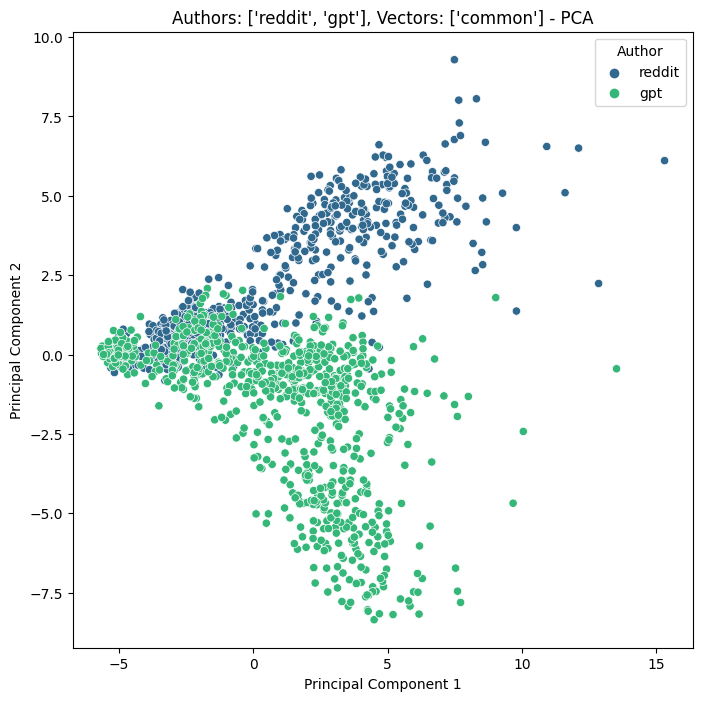

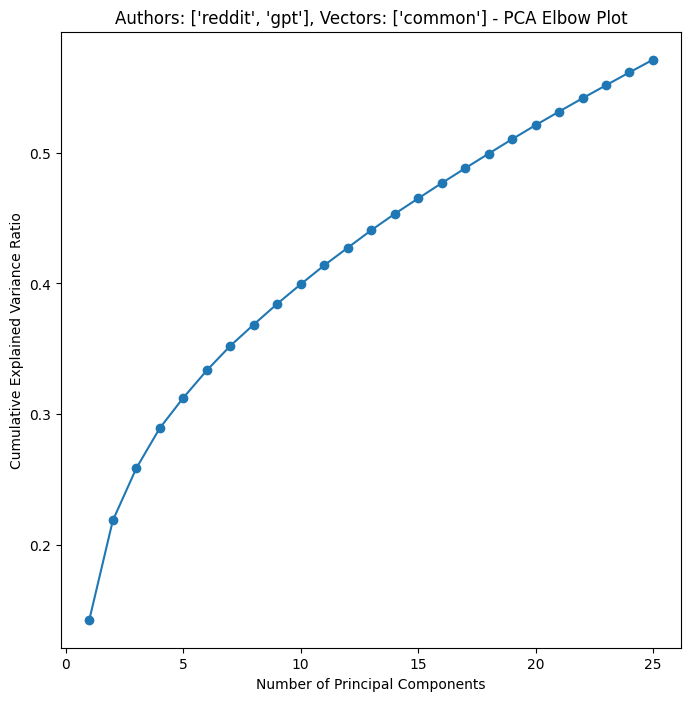

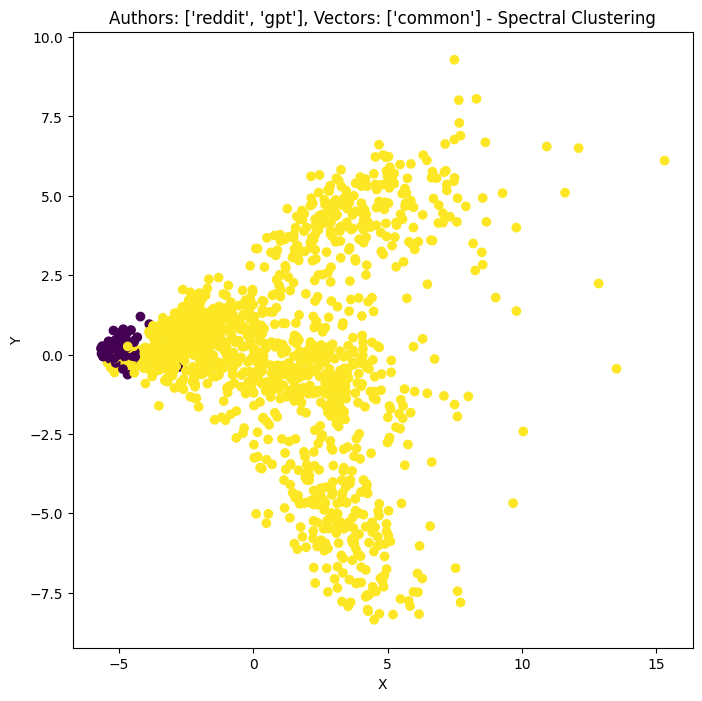

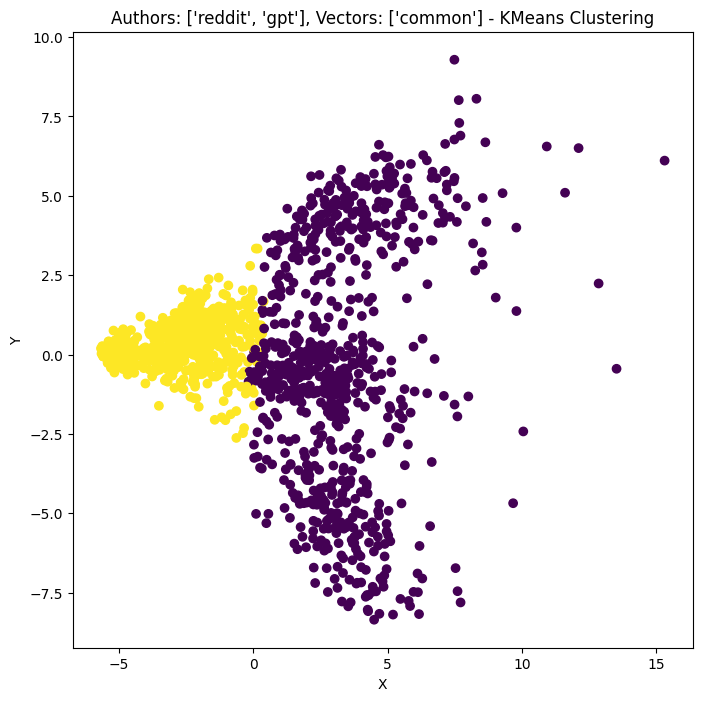

['function'] scores:
KMeans Adjusted Rand Index: 0.08597885210378932
KMeans Rand Index: 0.542858818011257
Spectral Clustering Adjusted Rand Index: 0.0012398903908984306
Spectral Clustering Rand Index: 0.5003447467166979


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


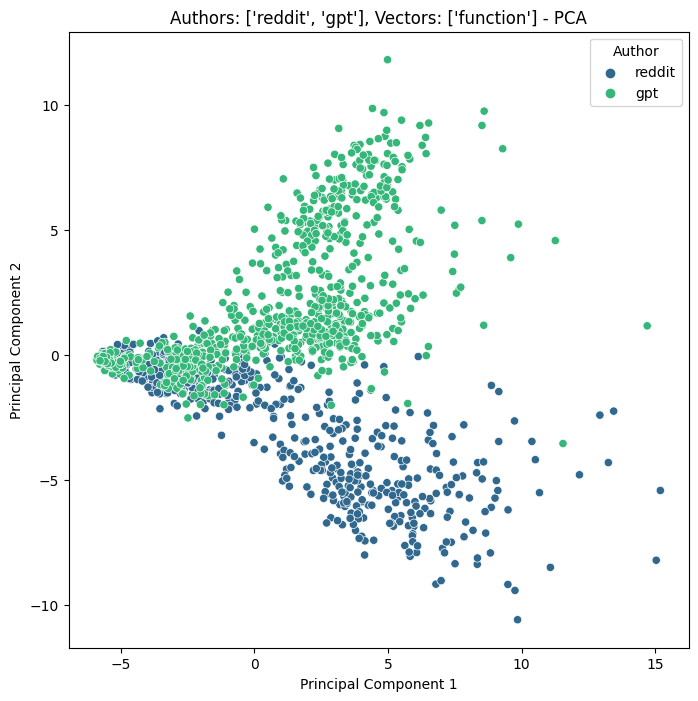

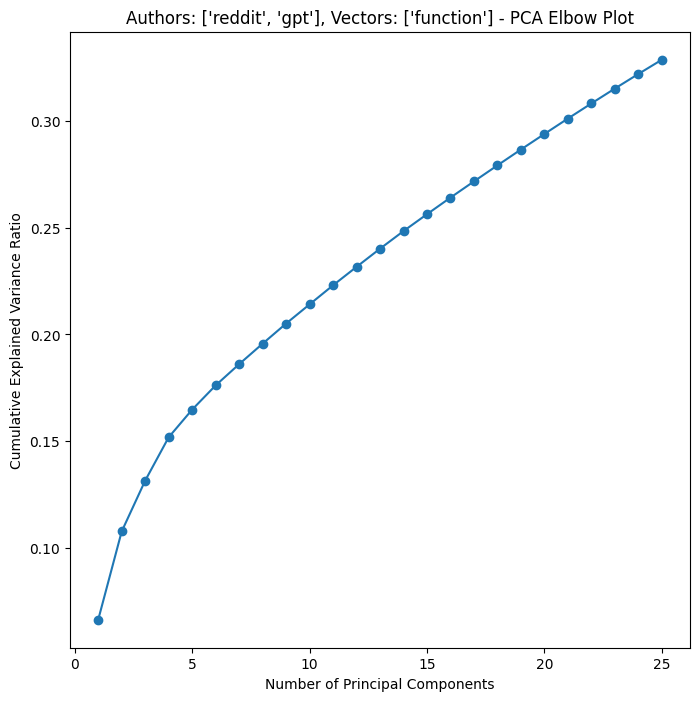

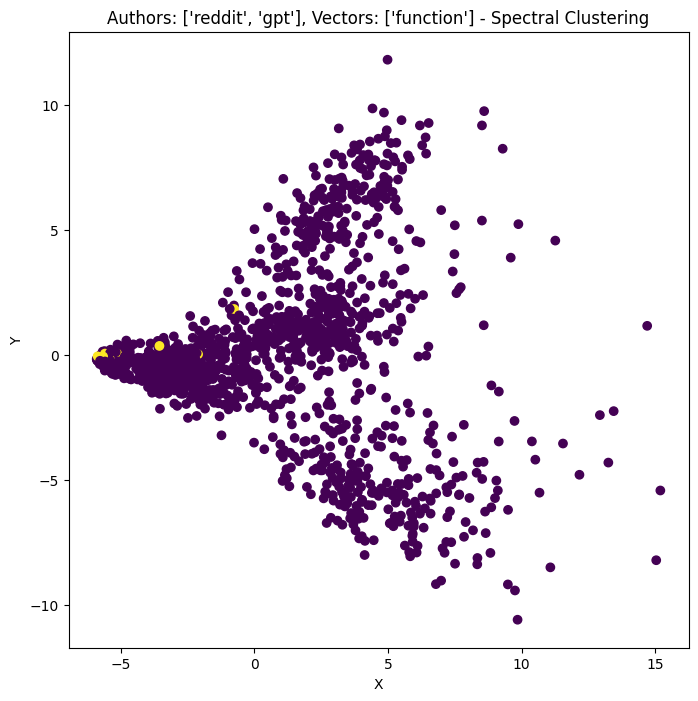

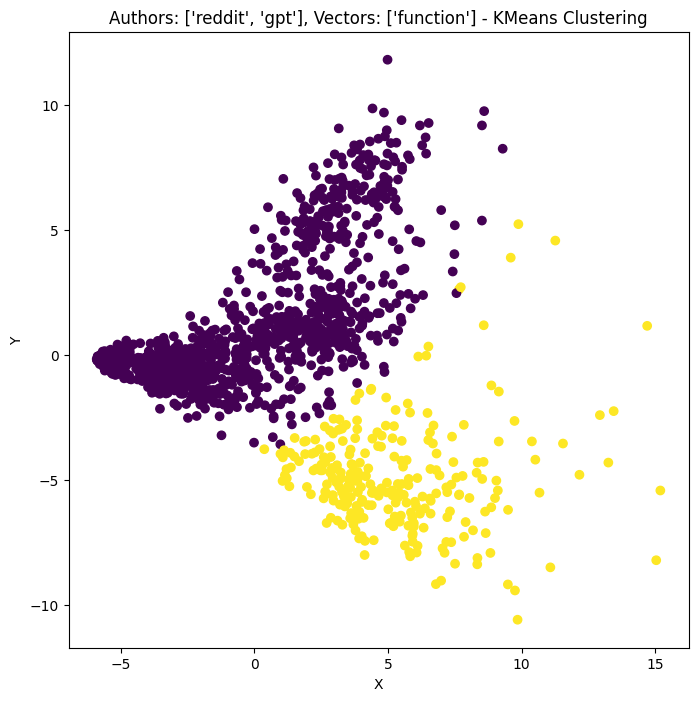

['common', 'function'] scores:
KMeans Adjusted Rand Index: 0.08136470808174705
KMeans Rand Index: 0.5406824577861163
Spectral Clustering Adjusted Rand Index: 0.0016303539332824658
Spectral Clustering Rand Index: 0.5005386178861788


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


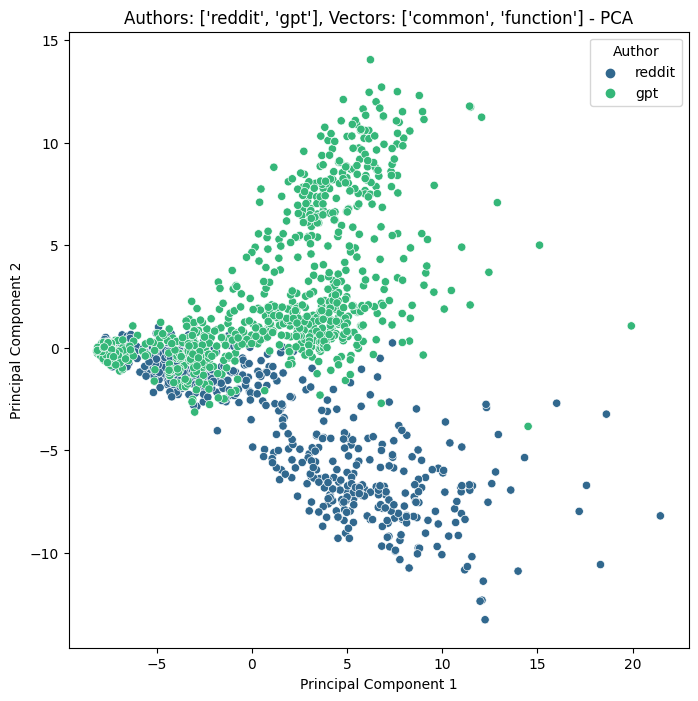

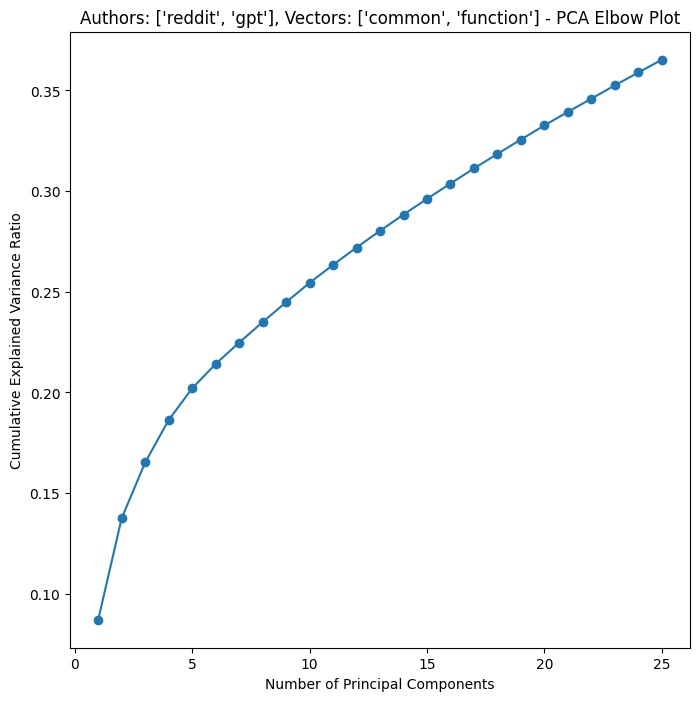

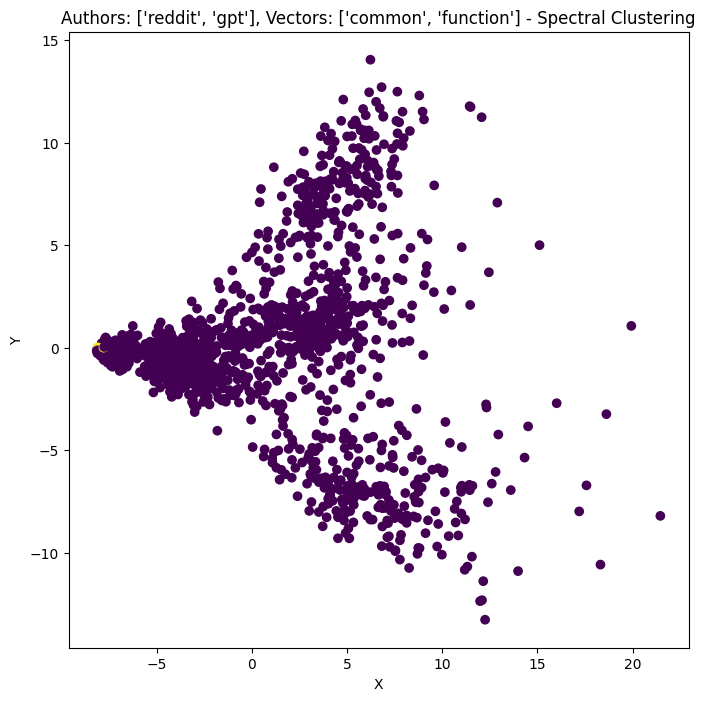

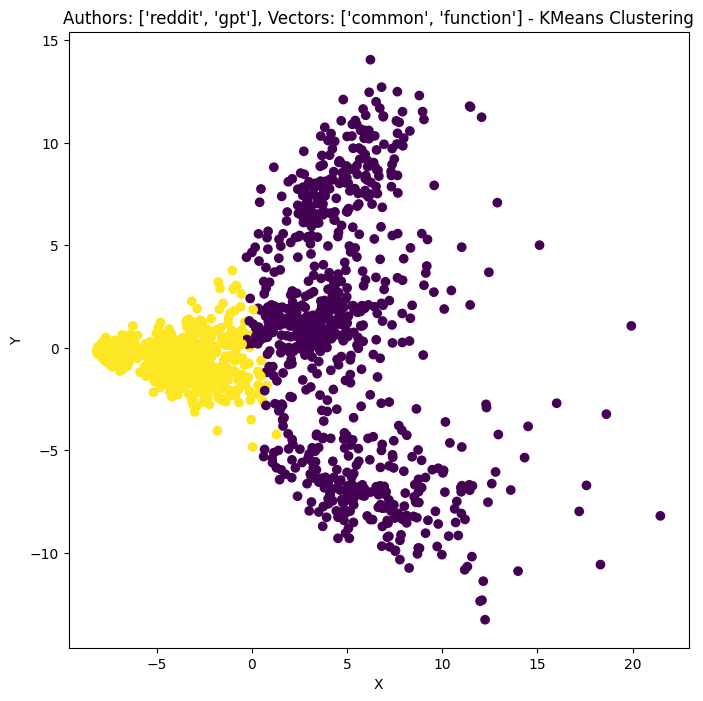

['bert'] scores:
KMeans Adjusted Rand Index: 0.8394136346656732
KMeans Rand Index: 0.9197068480300188
Spectral Clustering Adjusted Rand Index: 0.0492687901645228
Spectral Clustering Rand Index: 0.5244559099437148


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


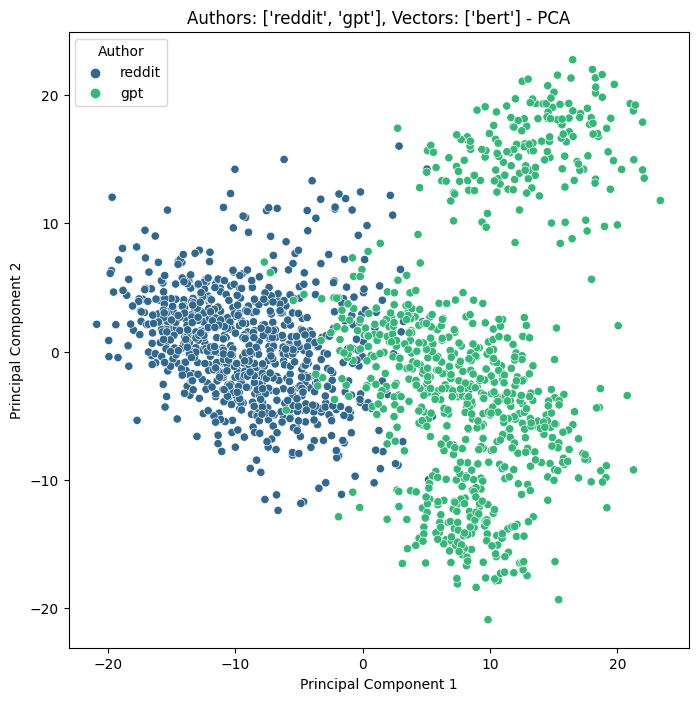

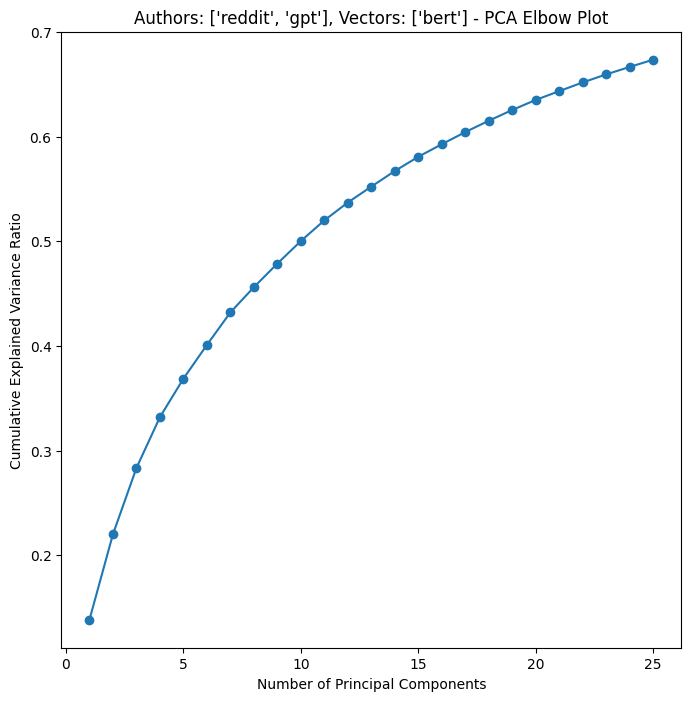

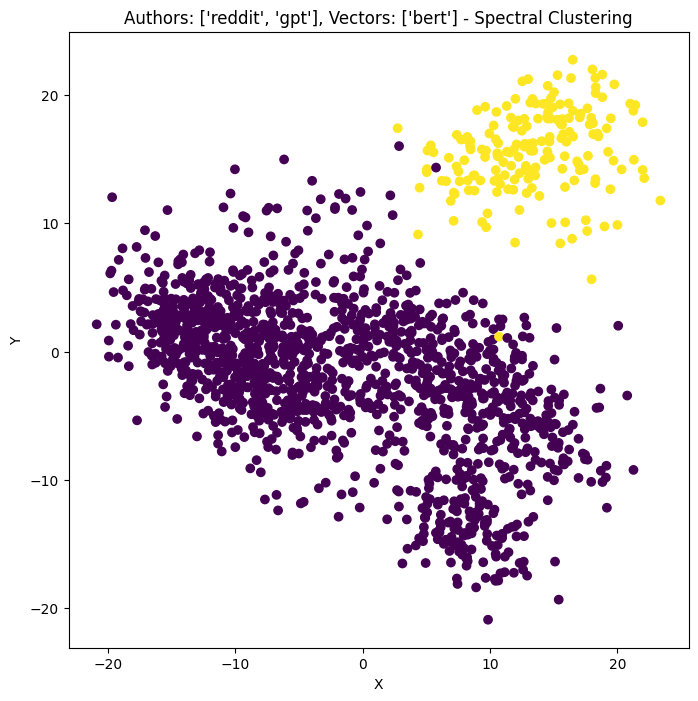

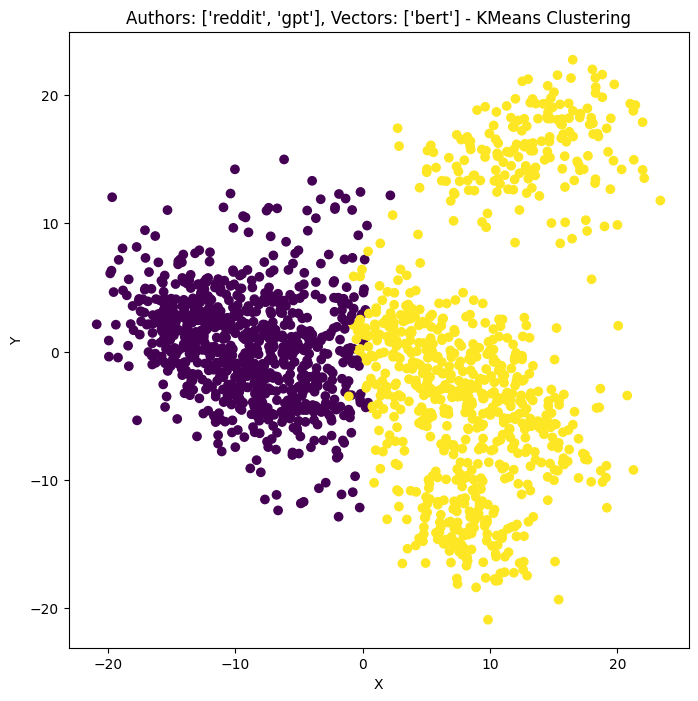

['common', 'function', 'bert'] scores:
KMeans Adjusted Rand Index: 0.9119699481857017
KMeans Rand Index: 0.955984990619137
Spectral Clustering Adjusted Rand Index: 0.0492687901645228
Spectral Clustering Rand Index: 0.5244559099437148


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


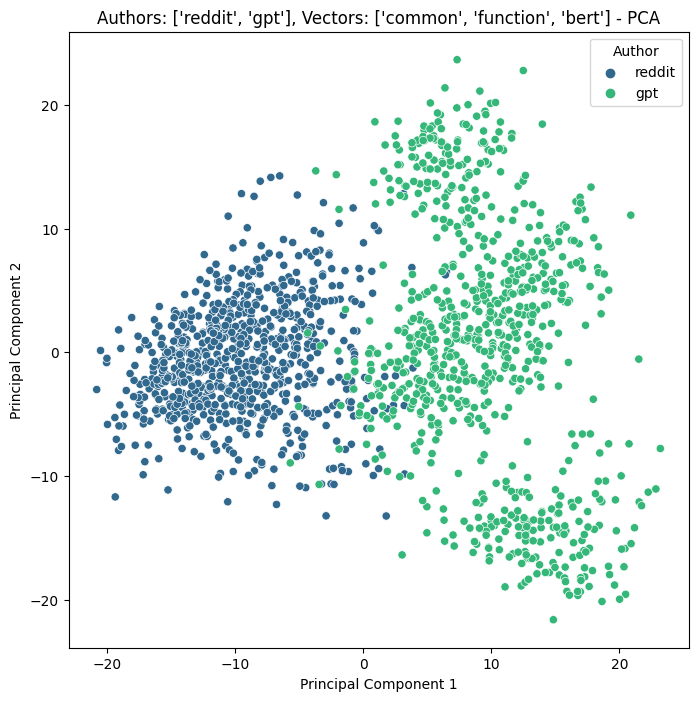

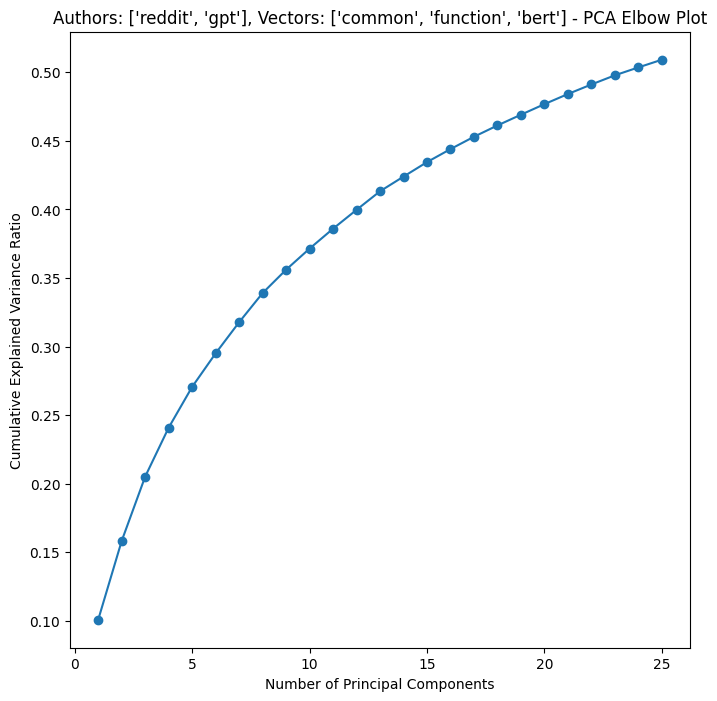

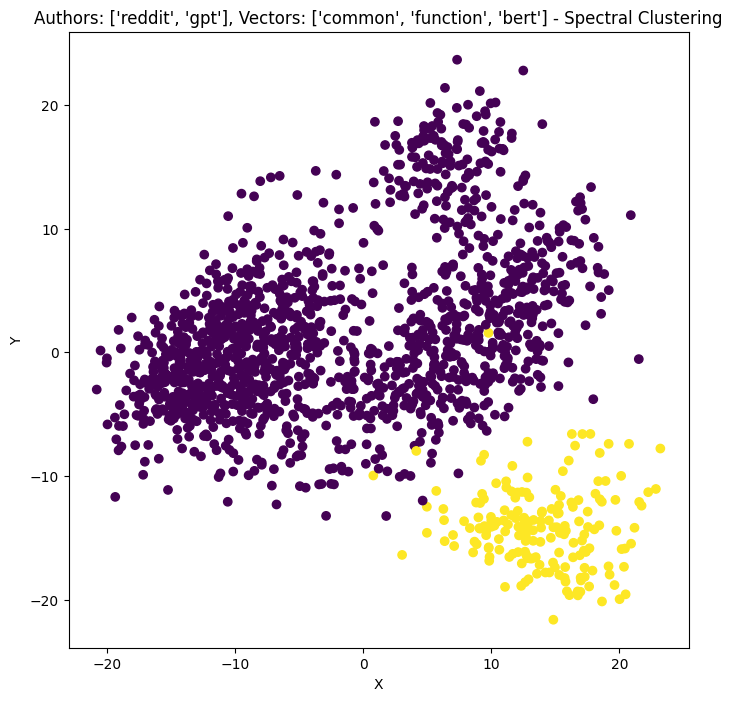

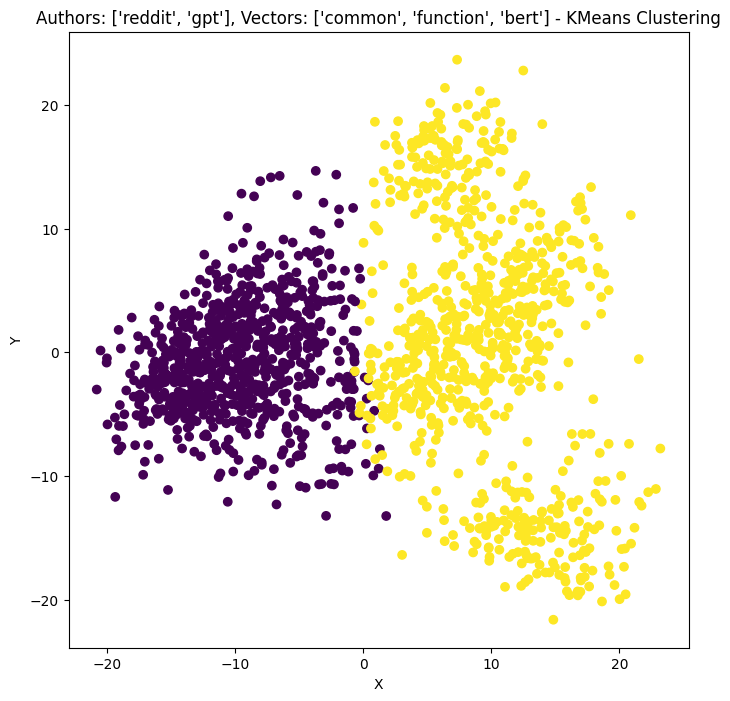

In [5]:
comp = []
for vector_names in list_of_vector_names:
    res = cluster_graph(["reddit", "gpt"], vector_names)
    comp.append(res)
results_table.append(comp)

# Reddit vs. Bard

['common'] scores:
KMeans Adjusted Rand Index: -0.00034616387677636015
KMeans Rand Index: 0.49979987492182615
Spectral Clustering Adjusted Rand Index: 0.04545180686771328
Spectral Clustering Rand Index: 0.5225461225766104


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


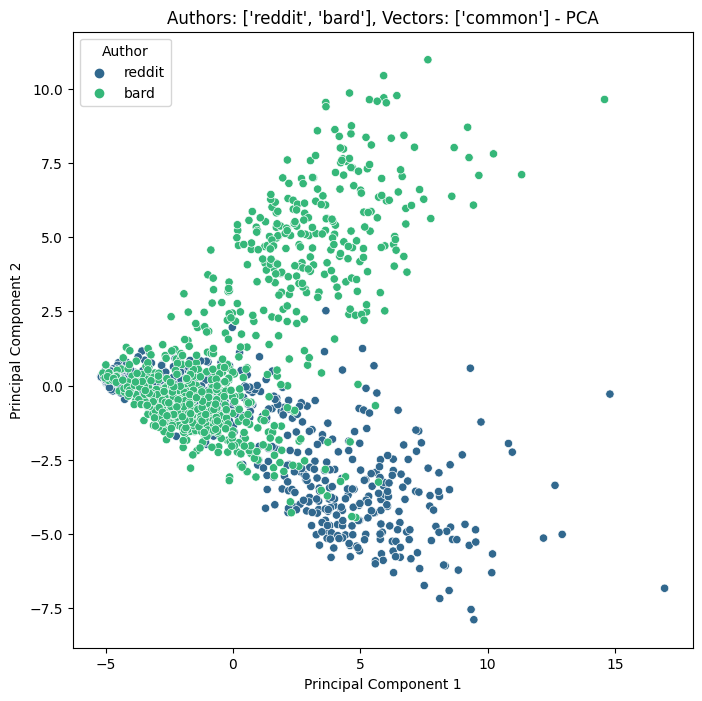

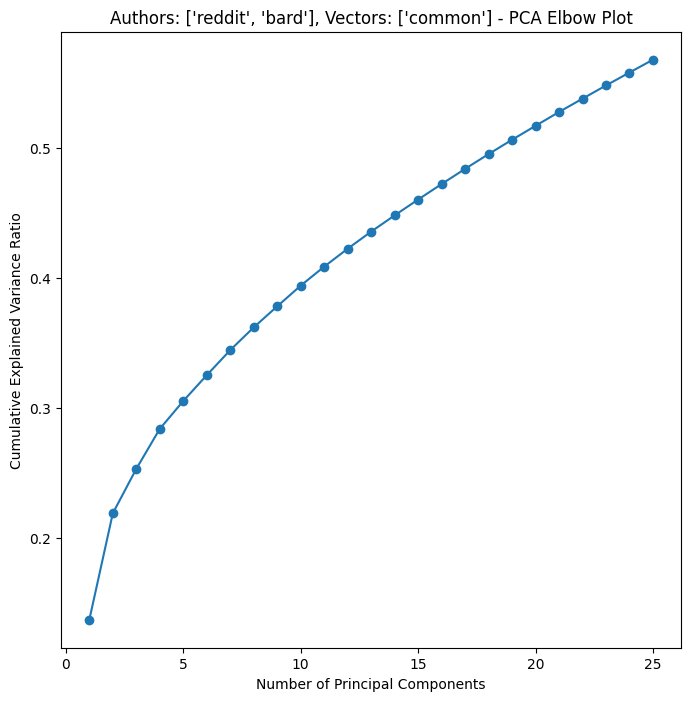

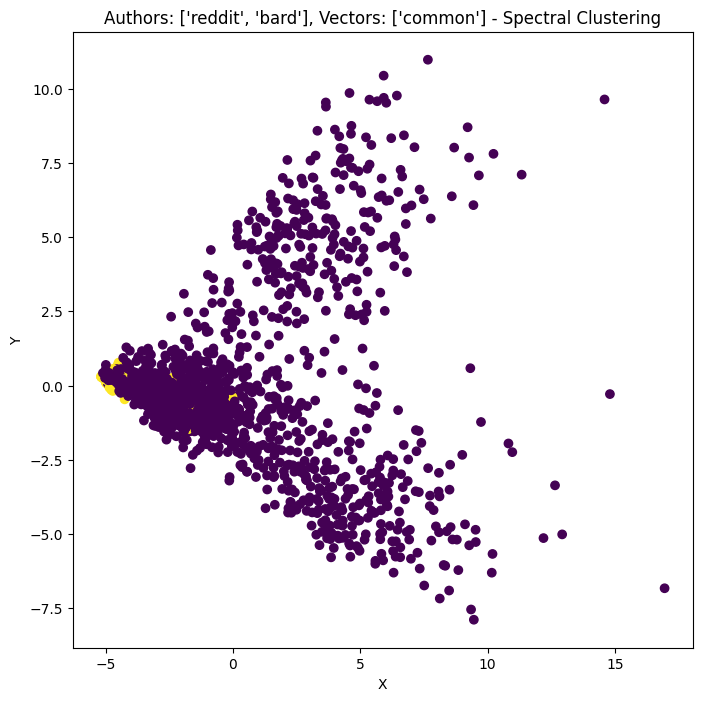

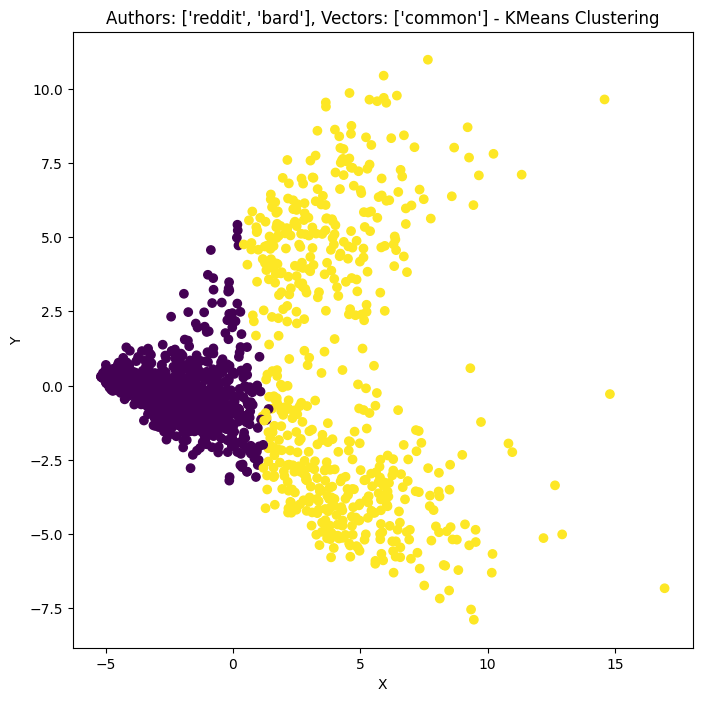

['function'] scores:
KMeans Adjusted Rand Index: -0.0005430087093372446
KMeans Rand Index: 0.49969434021263287
Spectral Clustering Adjusted Rand Index: 0.00024083580154704286
Spectral Clustering Rand Index: 0.4998194183864916


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


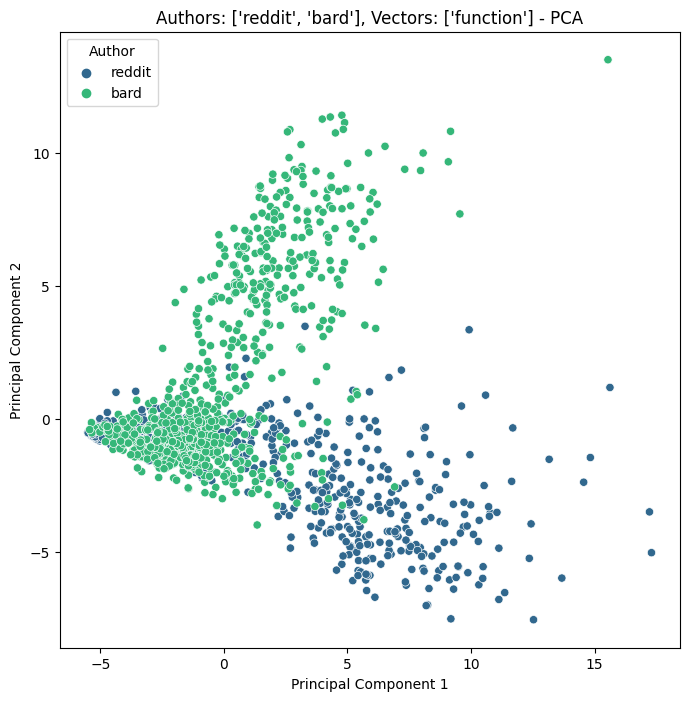

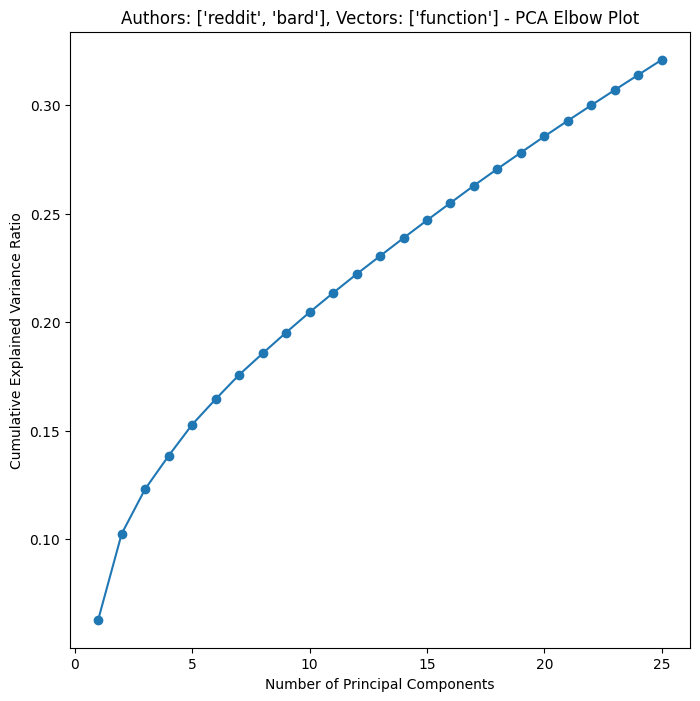

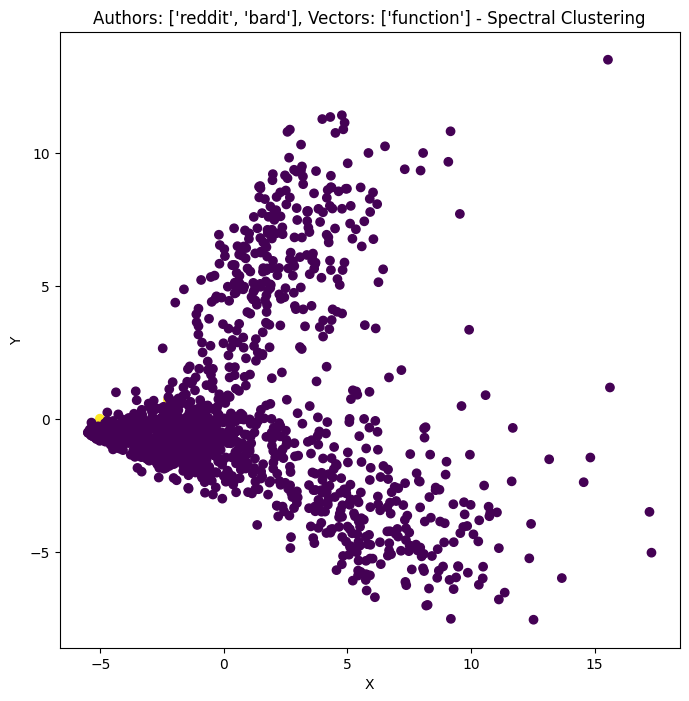

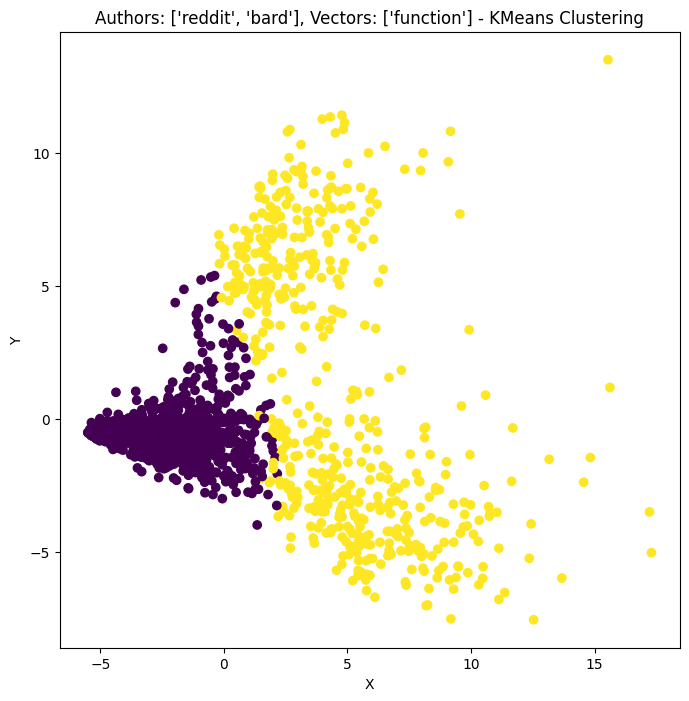

['common', 'function'] scores:
KMeans Adjusted Rand Index: -0.0005386398957799382
KMeans Rand Index: 0.4996998123827392
Spectral Clustering Adjusted Rand Index: 0.0001627700714366327
Spectral Clustering Rand Index: 0.49978189493433395


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


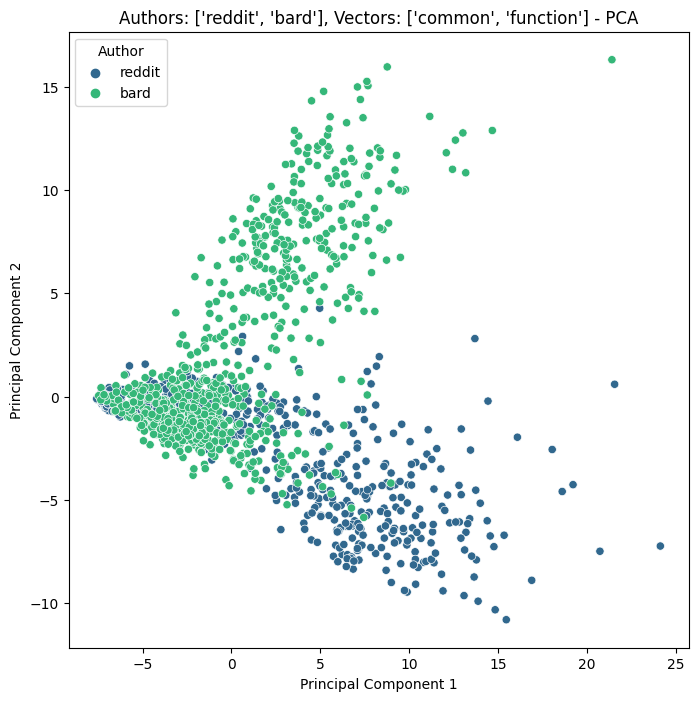

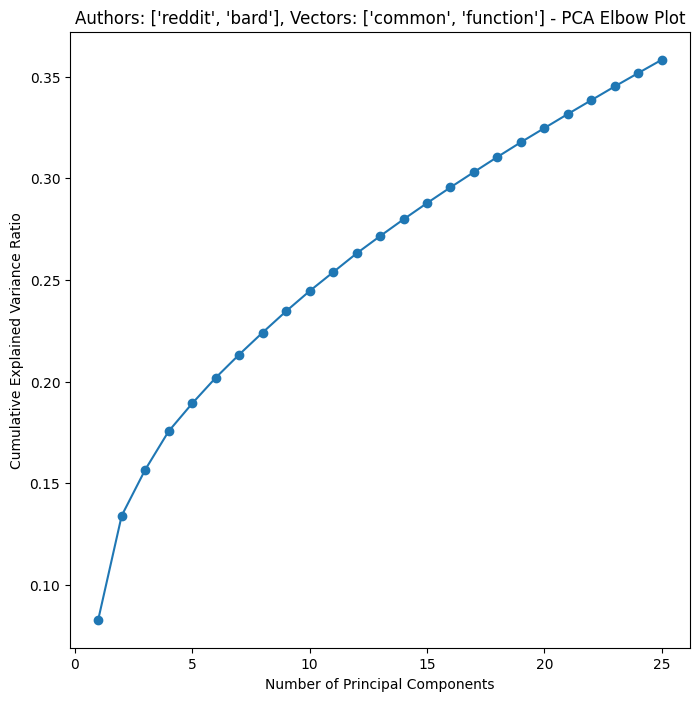

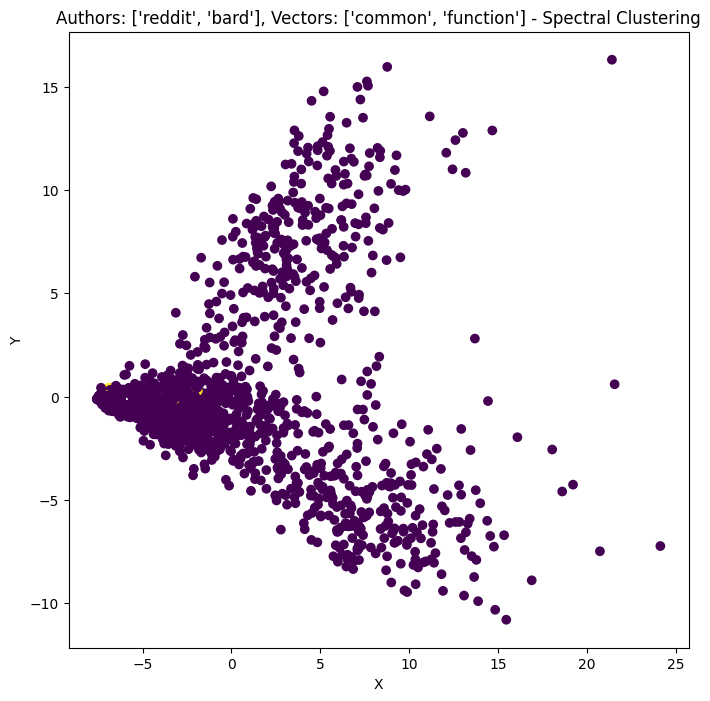

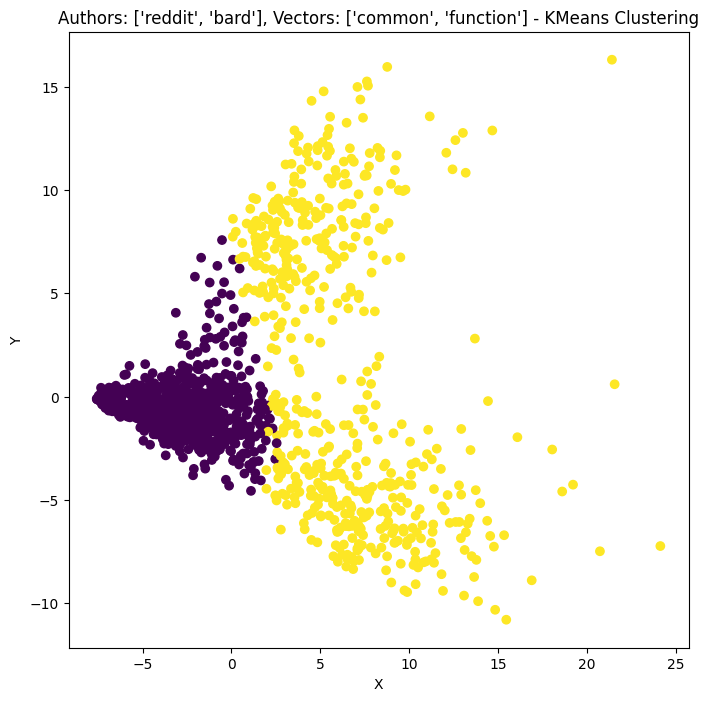

['bert'] scores:
KMeans Adjusted Rand Index: 0.443566677965329
KMeans Rand Index: 0.7217706378986867
Spectral Clustering Adjusted Rand Index: 0.008446835766965827
Spectral Clustering Rand Index: 0.503968105065666


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


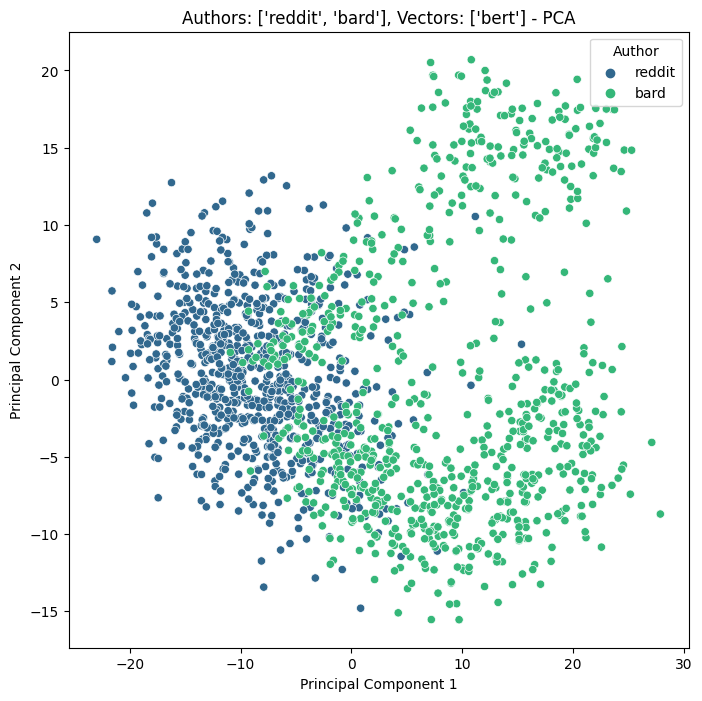

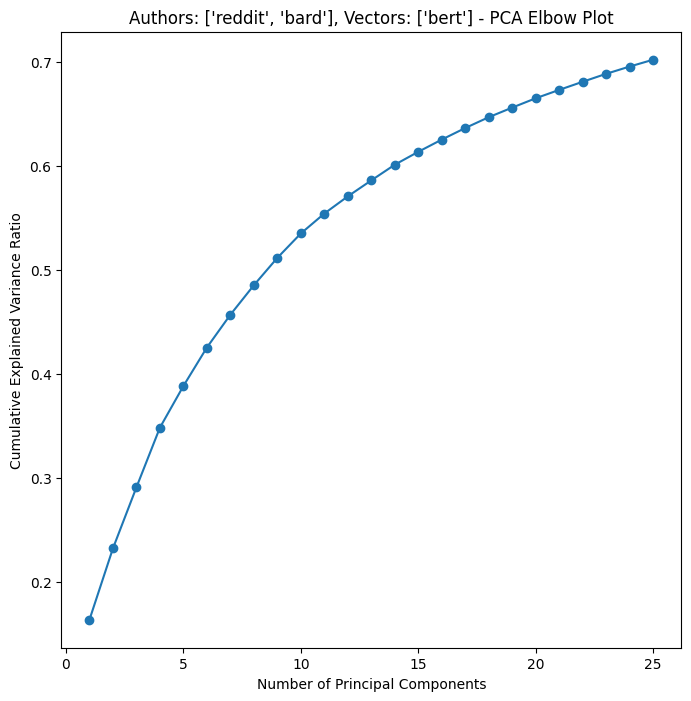

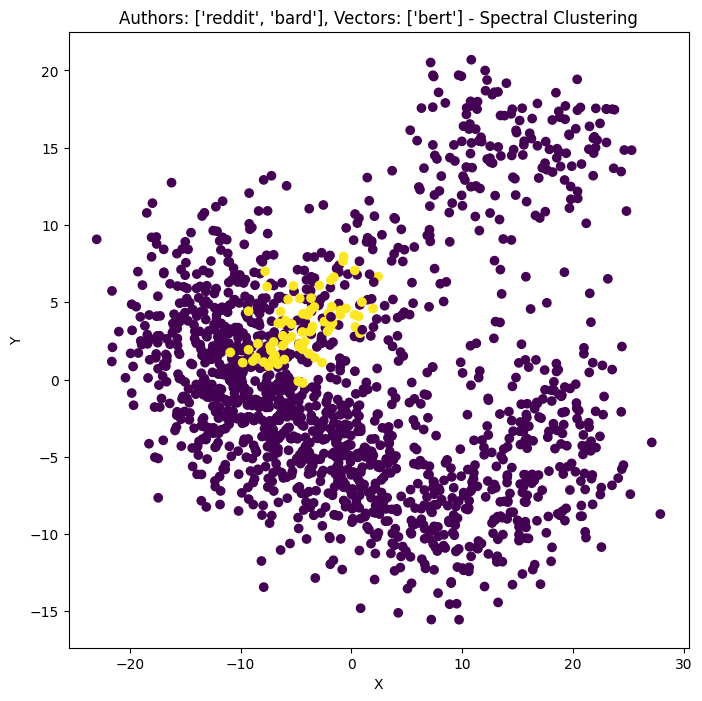

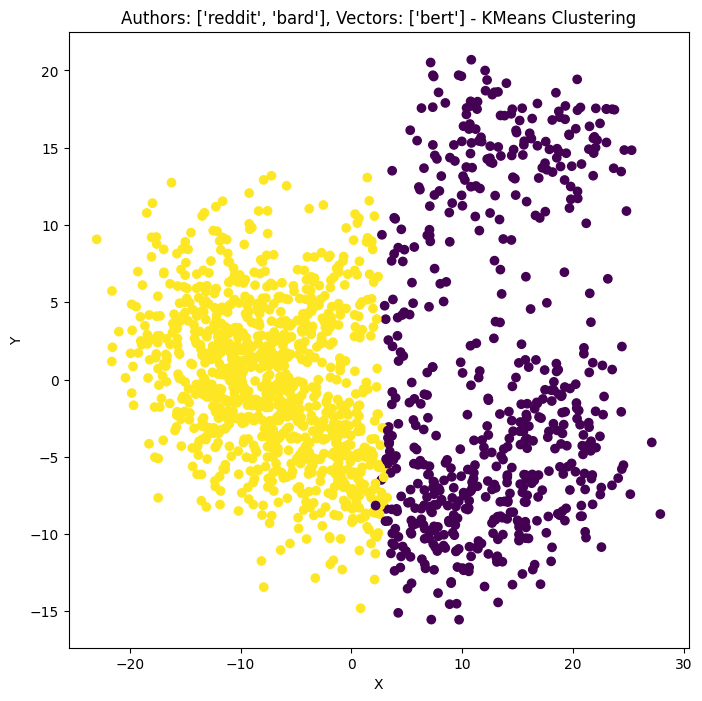

['common', 'function', 'bert'] scores:
KMeans Adjusted Rand Index: 0.4723485688277517
KMeans Rand Index: 0.7361632270168855
Spectral Clustering Adjusted Rand Index: 0.008678268231051563
Spectral Clustering Rand Index: 0.504084584115072


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


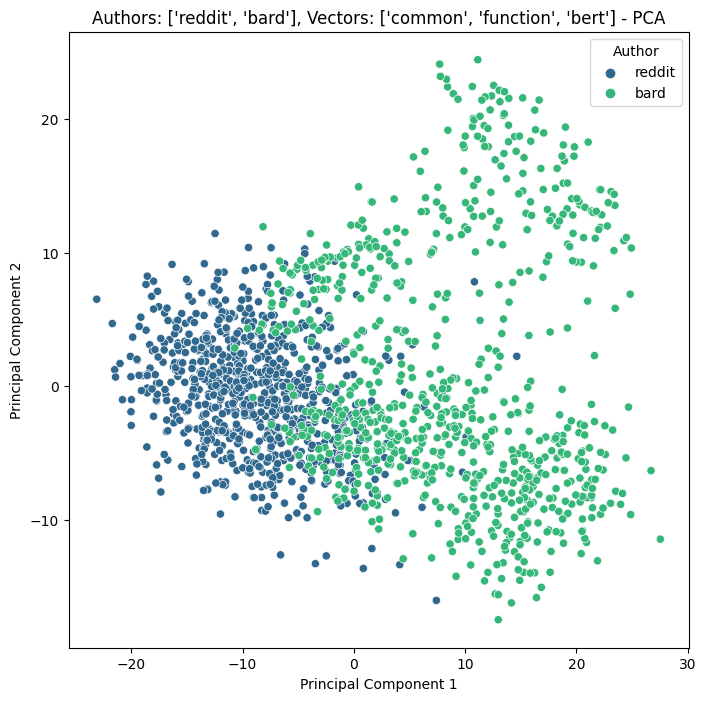

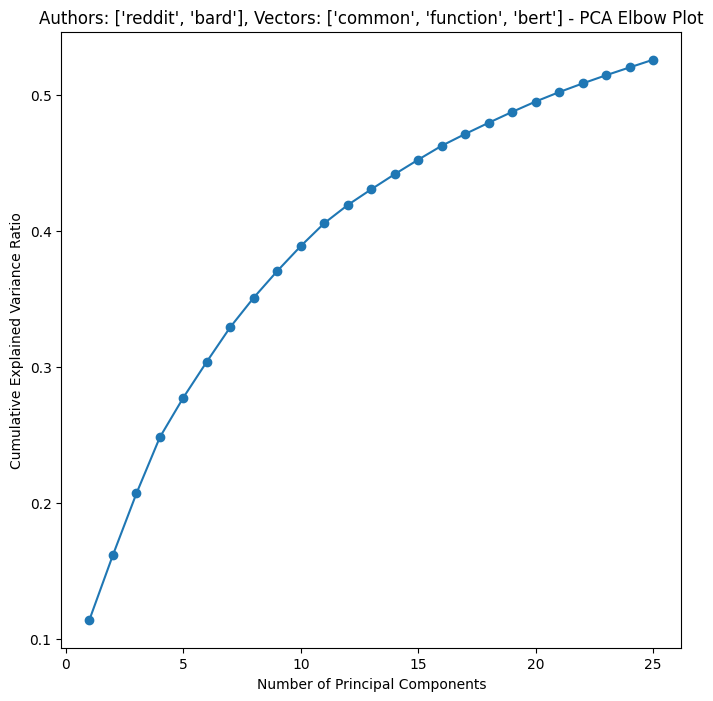

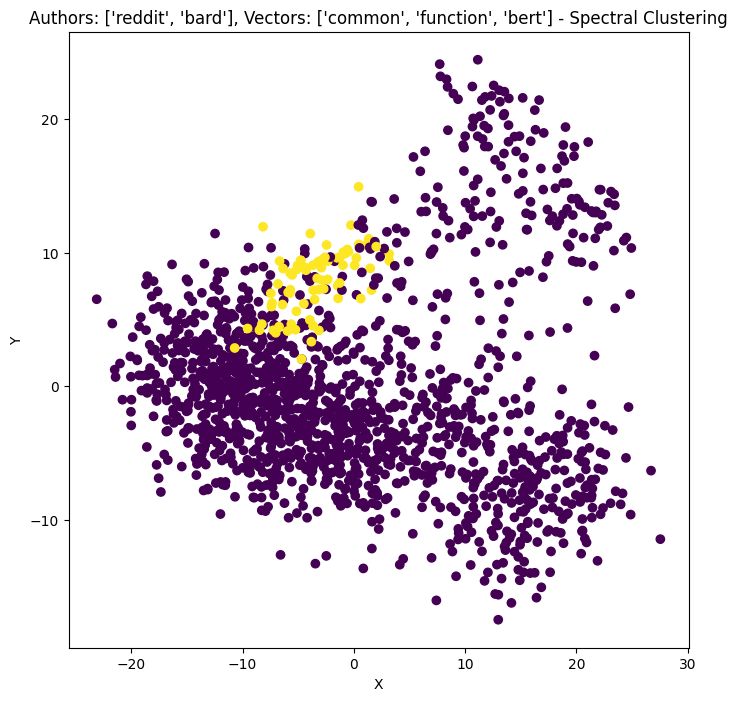

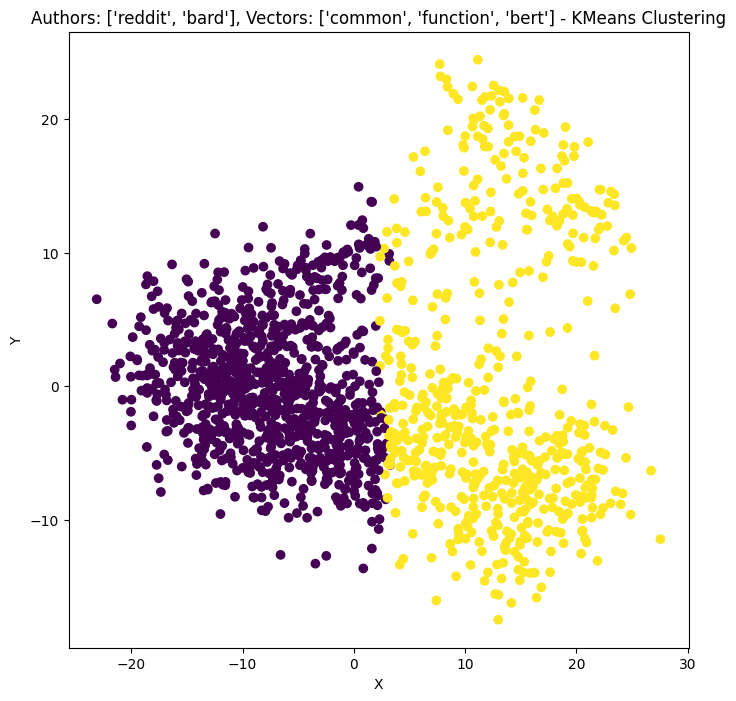

In [6]:
comp = []
for vector_names in list_of_vector_names:
    res = cluster_graph(["reddit", "bard"], vector_names)
    comp.append(res)
results_table.append(comp)

# Reddit vs. Gemini

['common'] scores:
KMeans Adjusted Rand Index: 0.17588460898042627
KMeans Rand Index: 0.587942464040025
Spectral Clustering Adjusted Rand Index: 0.026479556590997936
Spectral Clustering Rand Index: 0.5131027204502814


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


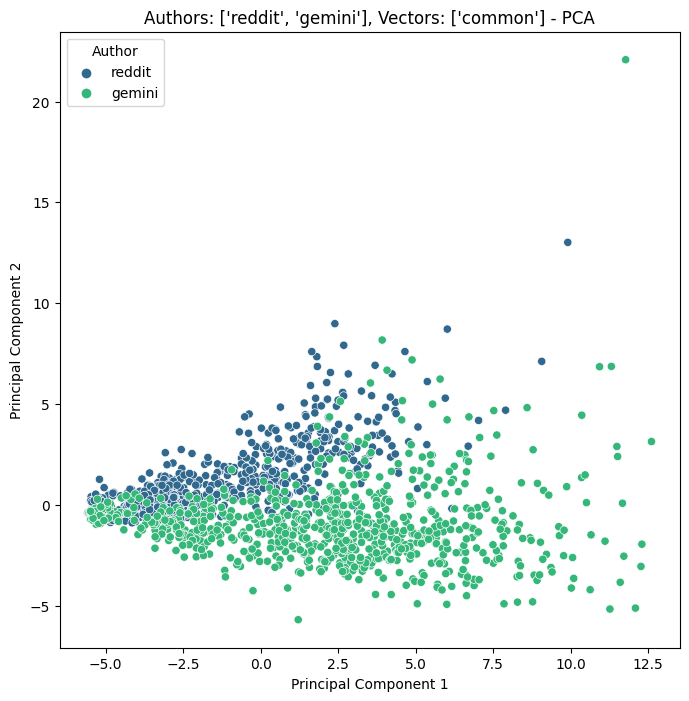

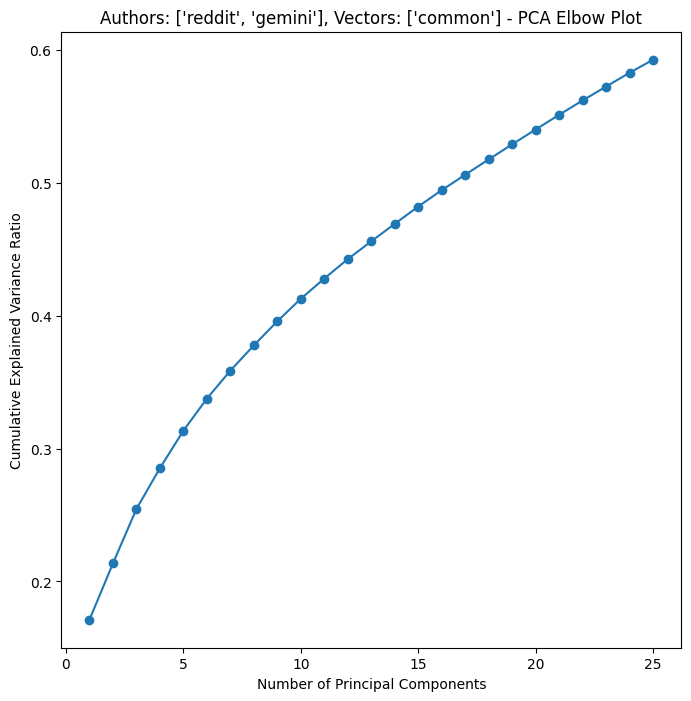

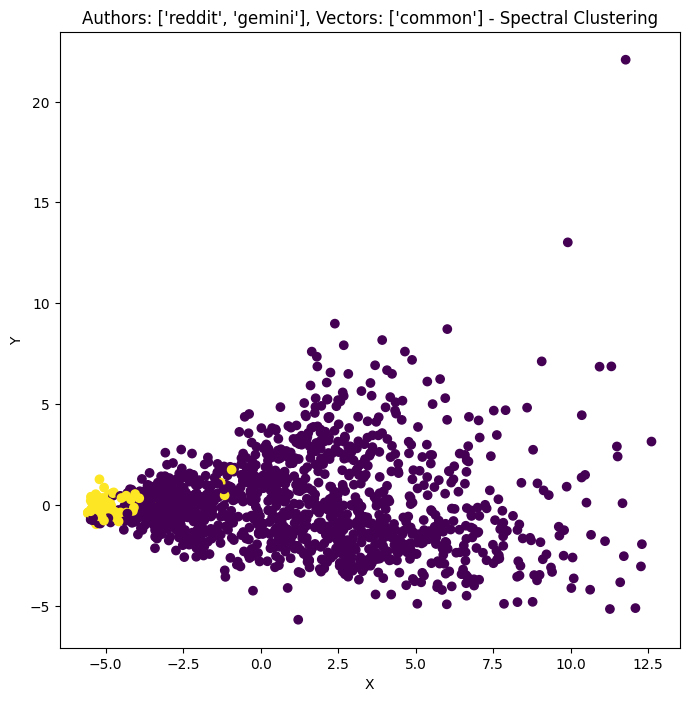

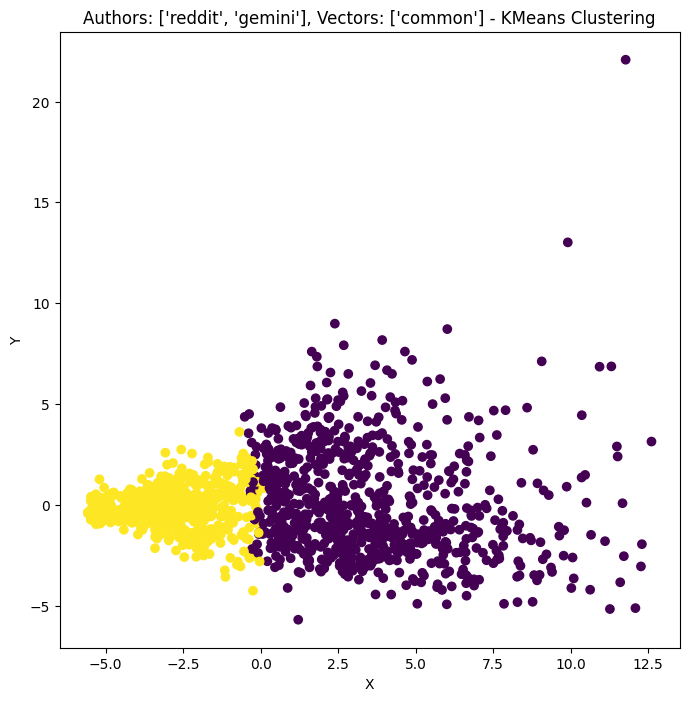

['function'] scores:
KMeans Adjusted Rand Index: 0.1822448621706674
KMeans Rand Index: 0.5911225766103815
Spectral Clustering Adjusted Rand Index: 0.001958229819659136
Spectral Clustering Rand Index: 0.5007004377736085


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


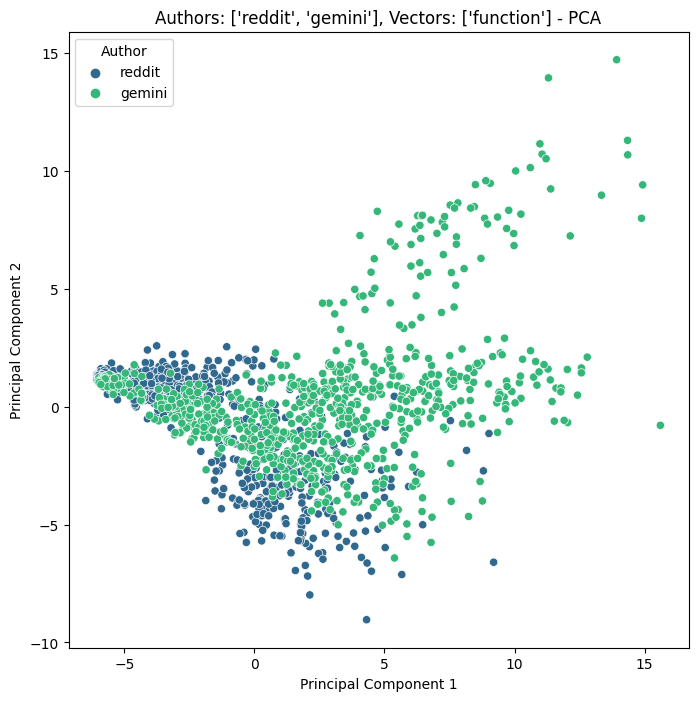

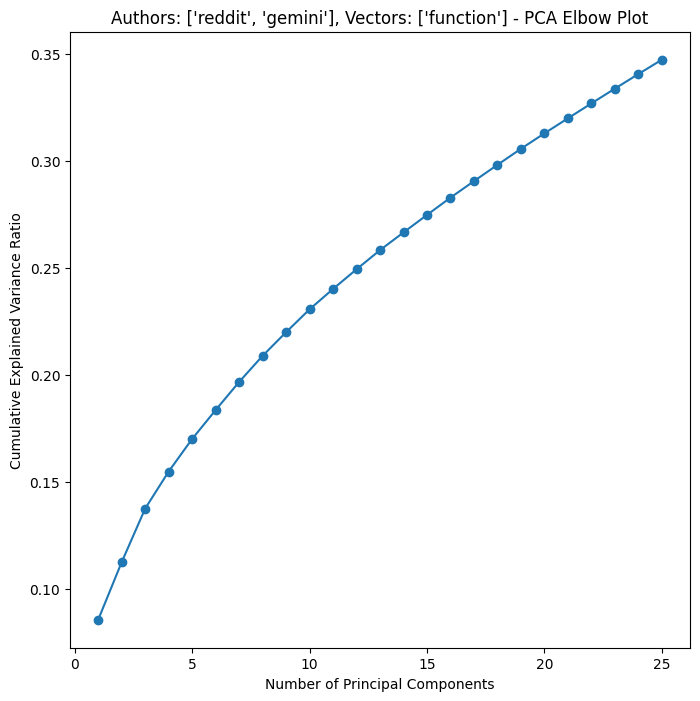

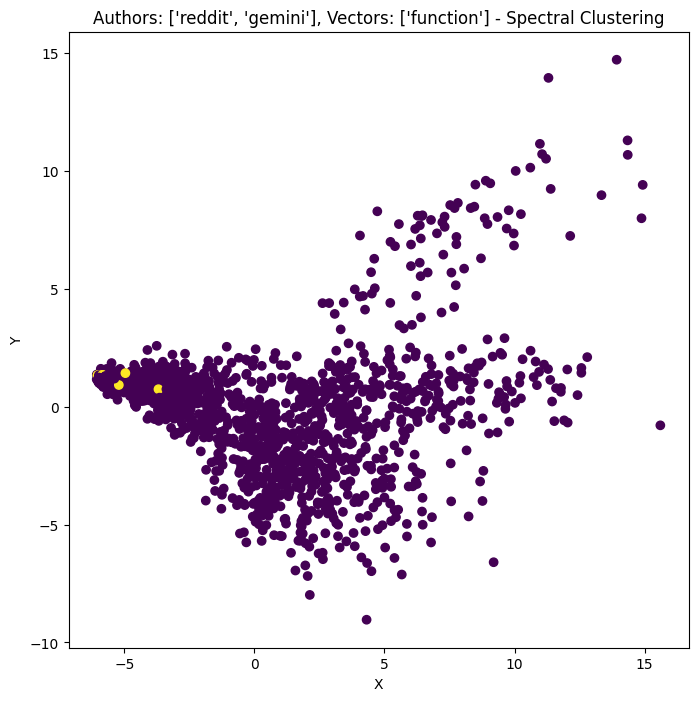

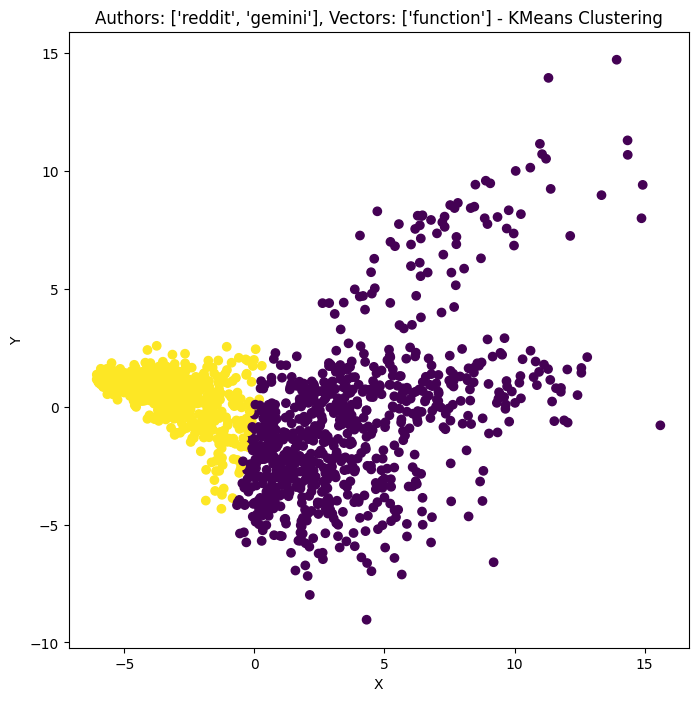

['common', 'function'] scores:
KMeans Adjusted Rand Index: 0.1822448461788979
KMeans Rand Index: 0.5911225766103815
Spectral Clustering Adjusted Rand Index: 0.0008630712992581527
Spectral Clustering Rand Index: 0.5001375859912446


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


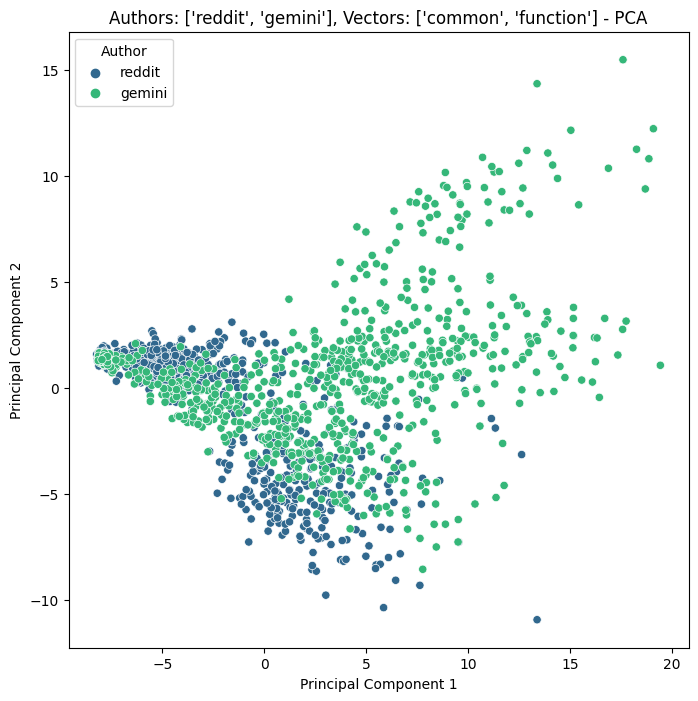

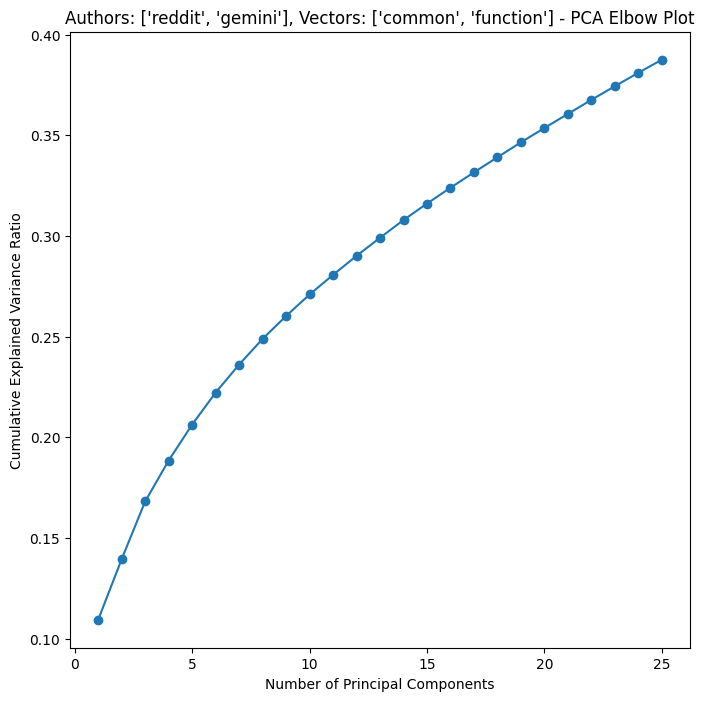

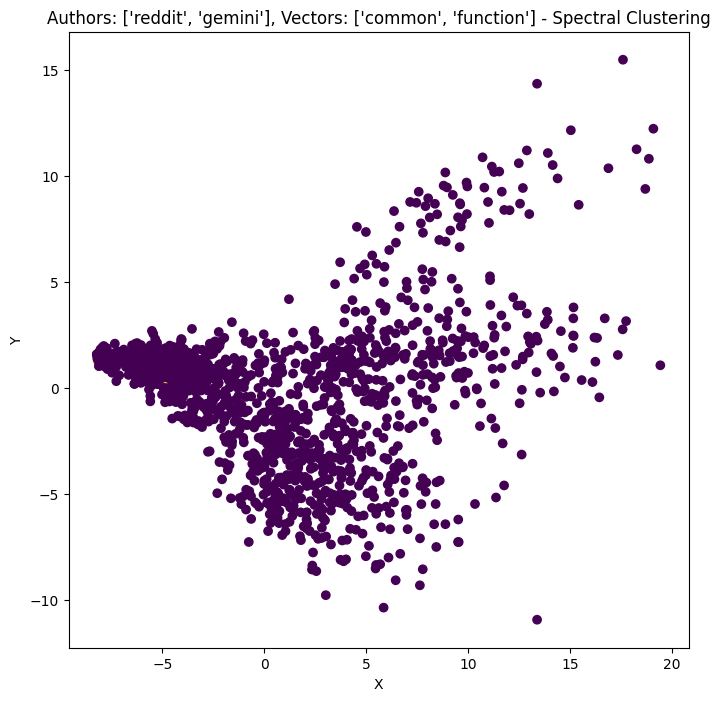

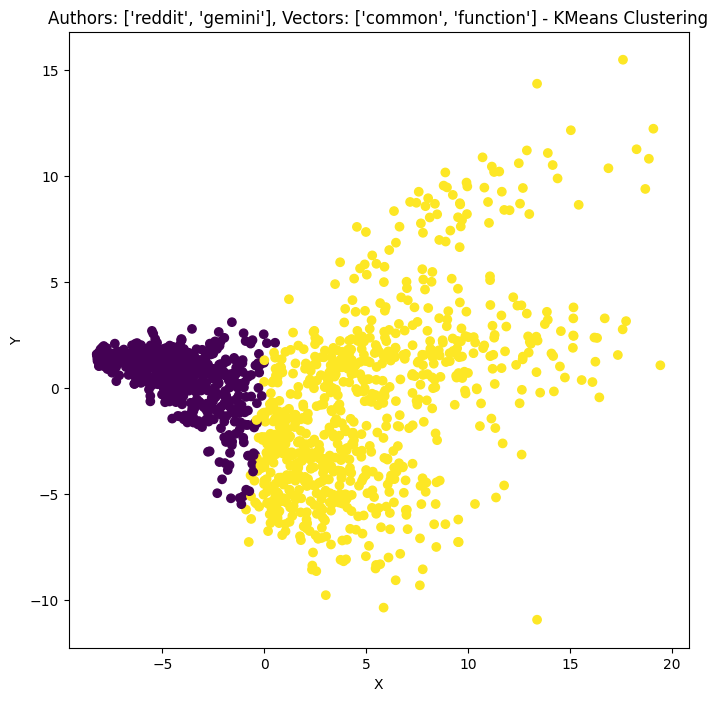

['bert'] scores:
KMeans Adjusted Rand Index: 0.6721997643330605
KMeans Rand Index: 0.8360975609756097
Spectral Clustering Adjusted Rand Index: 0.00939133335437236
Spectral Clustering Rand Index: 0.504443402126329


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


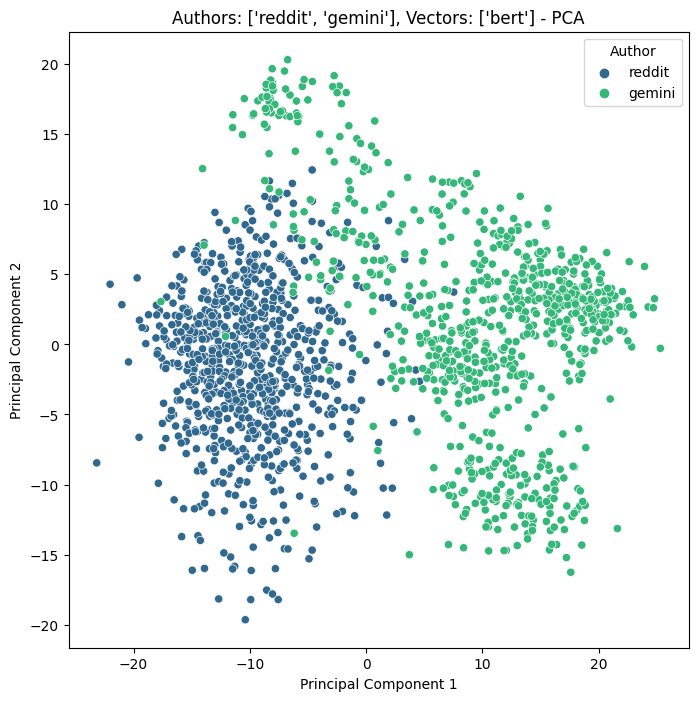

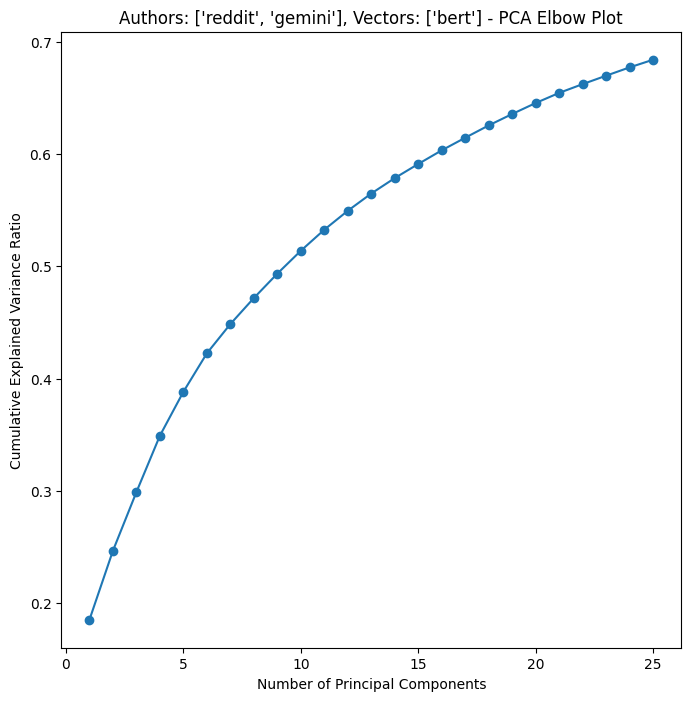

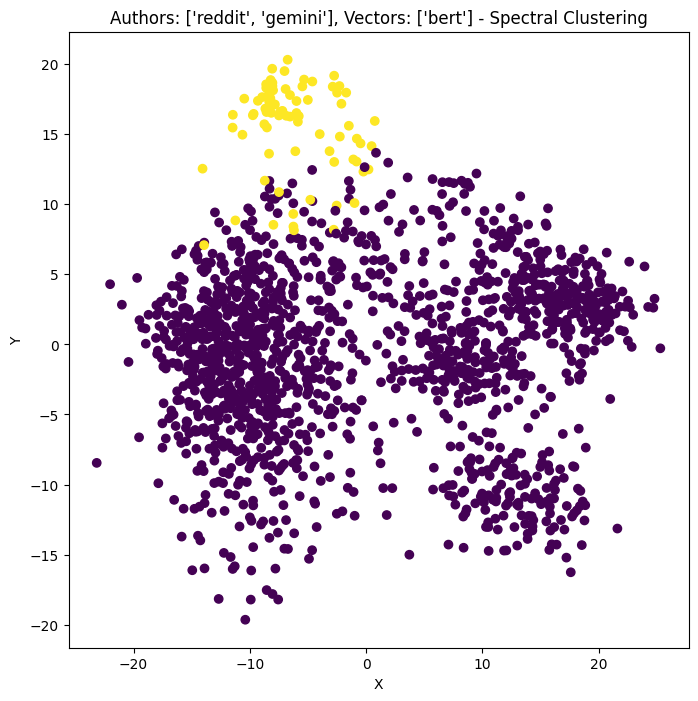

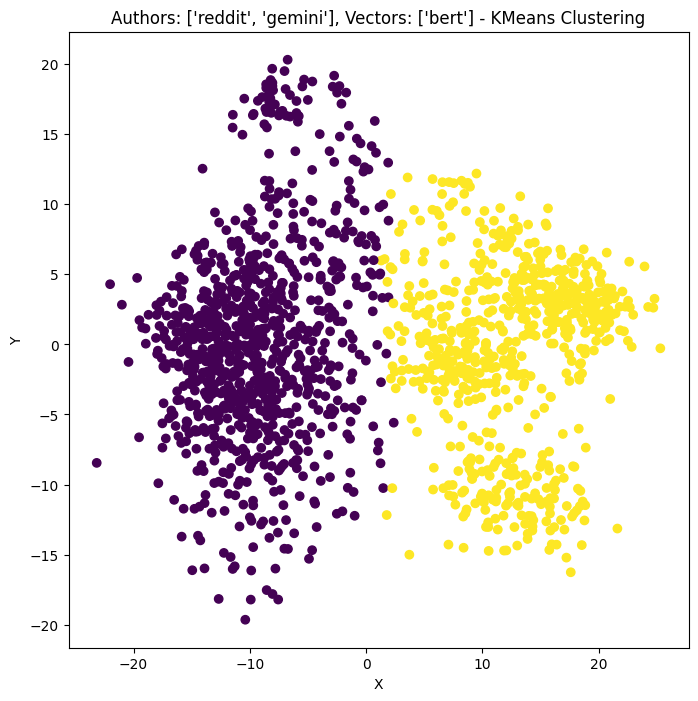

['common', 'function', 'bert'] scores:
KMeans Adjusted Rand Index: 0.7394395940277493
KMeans Rand Index: 0.869718574108818
Spectral Clustering Adjusted Rand Index: 0.7786694314777112
Spectral Clustering Rand Index: 0.8893339587242026


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


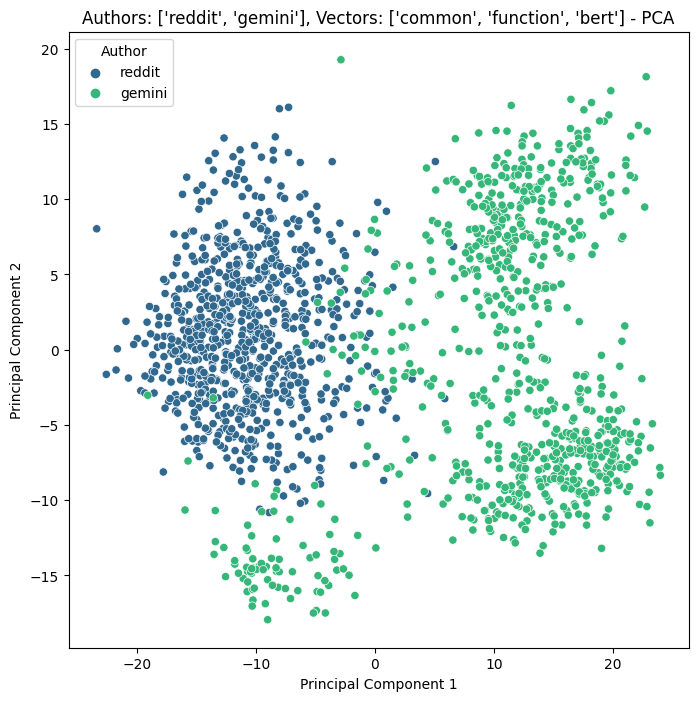

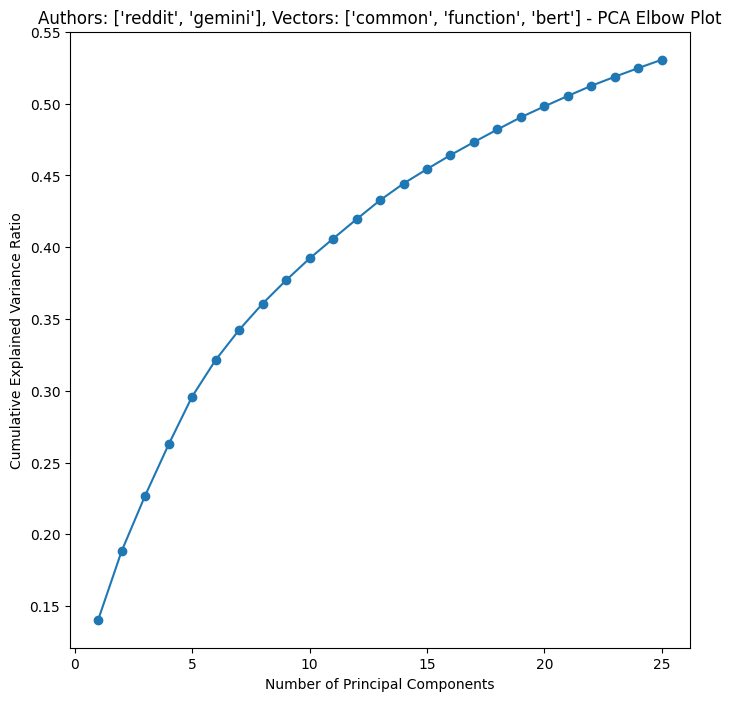

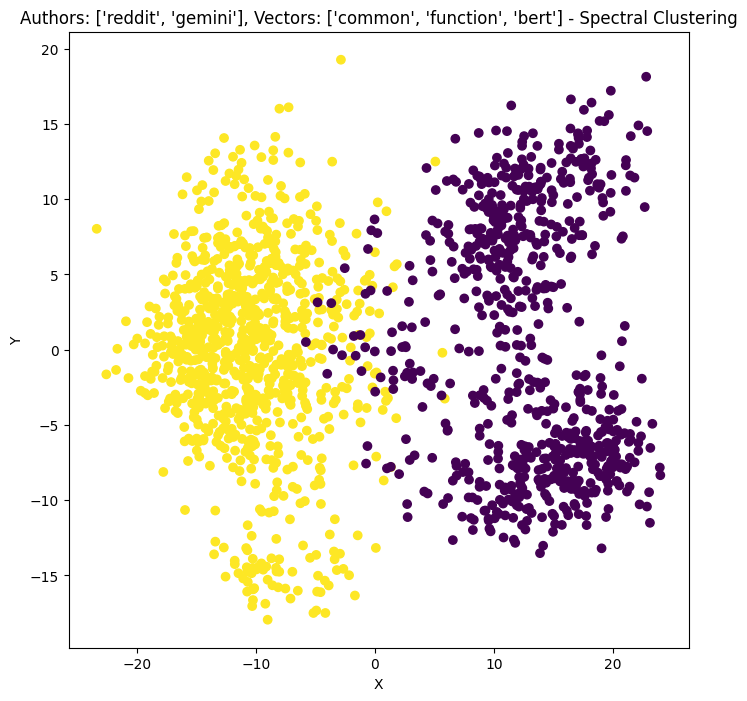

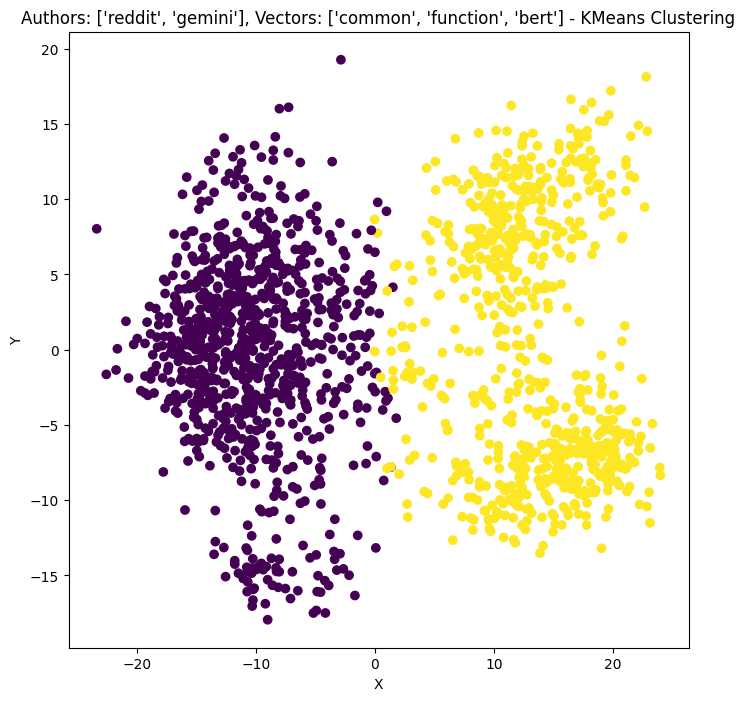

In [7]:
comp = []
for vector_names in list_of_vector_names:
    res = cluster_graph(["reddit", "gemini"], vector_names)
    comp.append(res)
results_table.append(comp)

# GPT (temp 1.0) vs. Bard

['common'] scores:
KMeans Adjusted Rand Index: 0.09018421586493358
KMeans Rand Index: 0.5450914634146341
Spectral Clustering Adjusted Rand Index: 0.01279842273965138
Spectral Clustering Rand Index: 0.5061608818011257


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


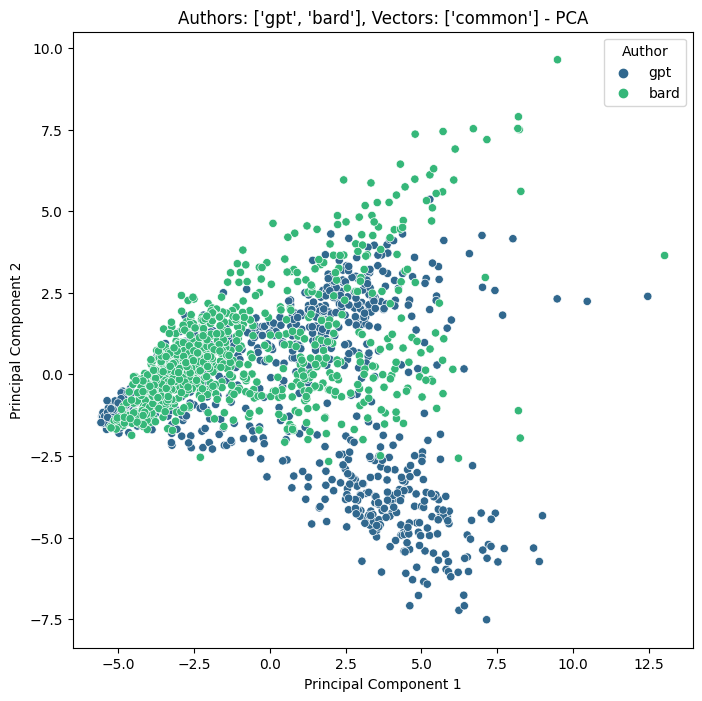

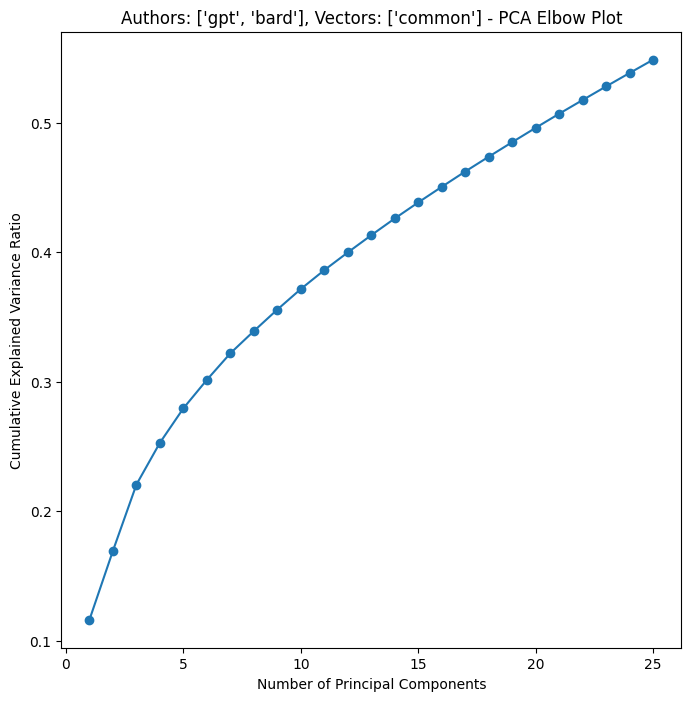

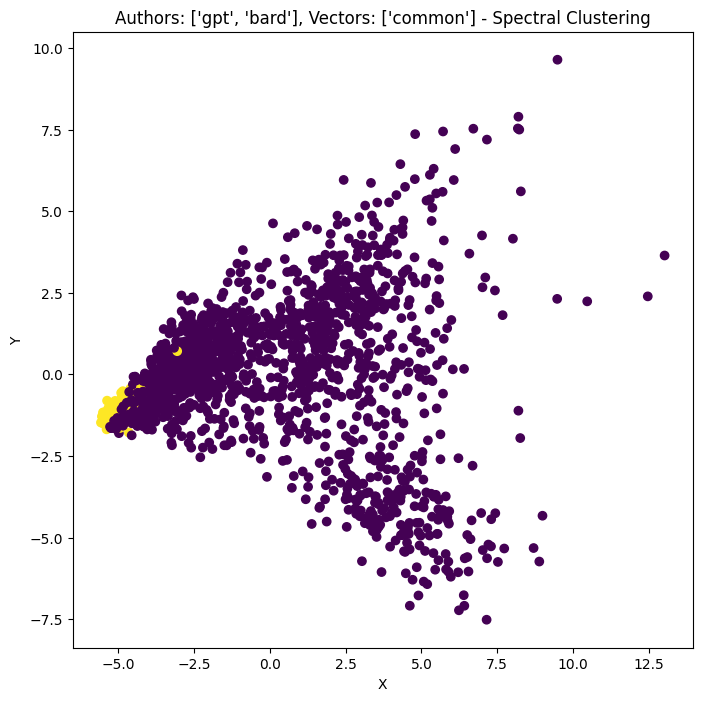

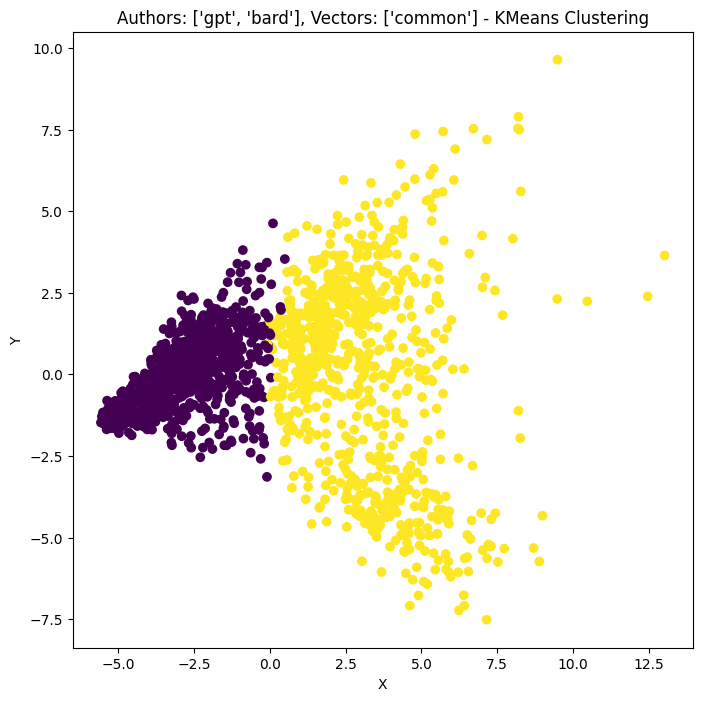

['function'] scores:
KMeans Adjusted Rand Index: 0.11251079099425867
KMeans Rand Index: 0.5562546904315196
Spectral Clustering Adjusted Rand Index: 0.051517056867542356
Spectral Clustering Rand Index: 0.5255816135084428


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


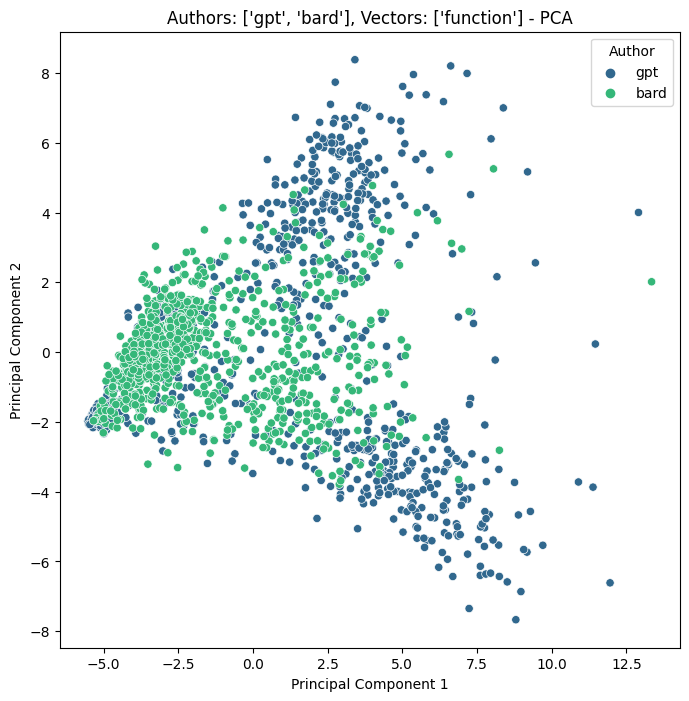

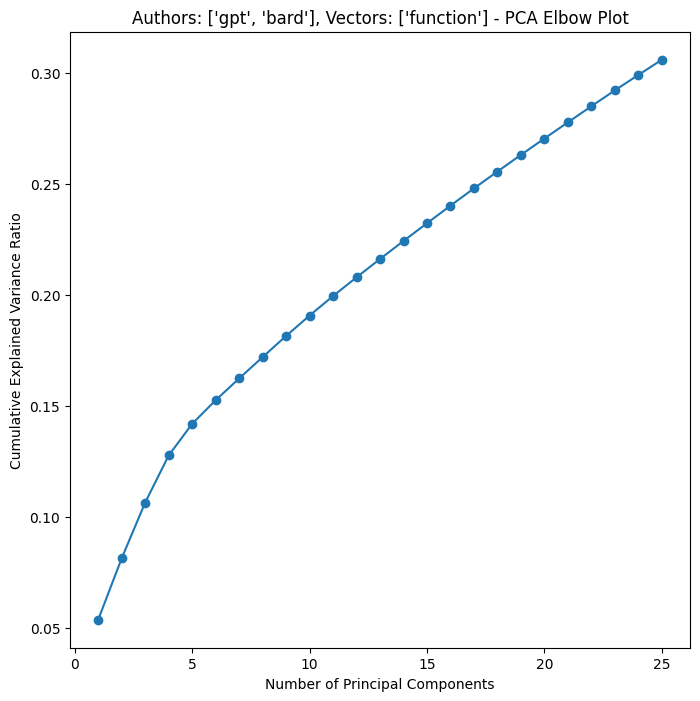

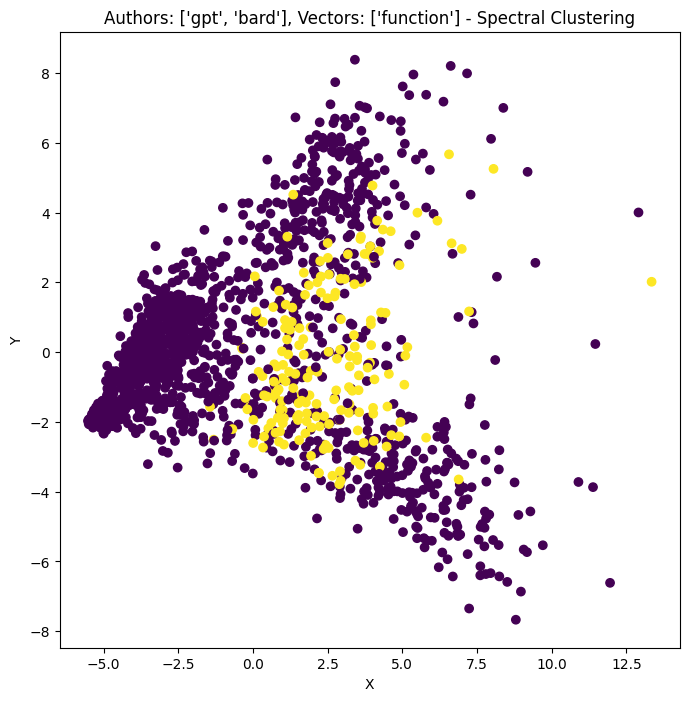

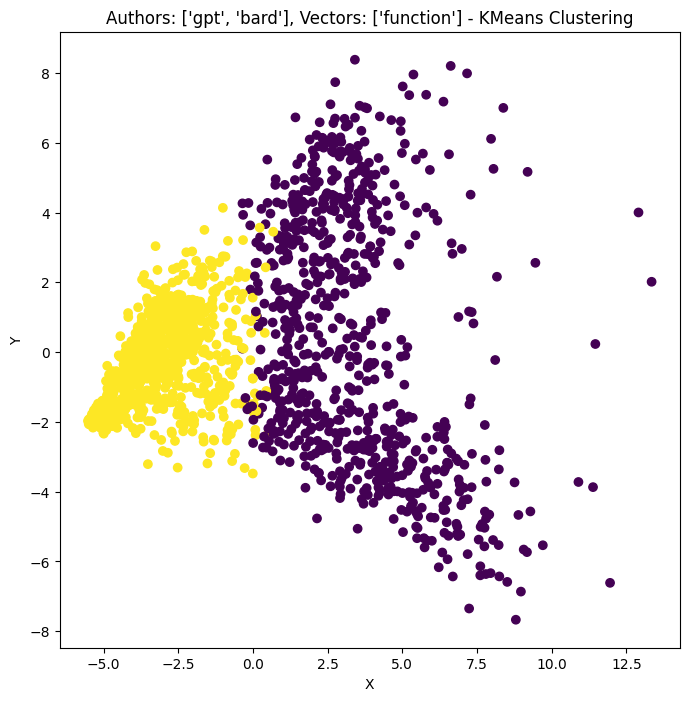

['common', 'function'] scores:
KMeans Adjusted Rand Index: 0.10104083830408207
KMeans Rand Index: 0.5505198561601
Spectral Clustering Adjusted Rand Index: 0.062243421824295264
Spectral Clustering Rand Index: 0.5309568480300187


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


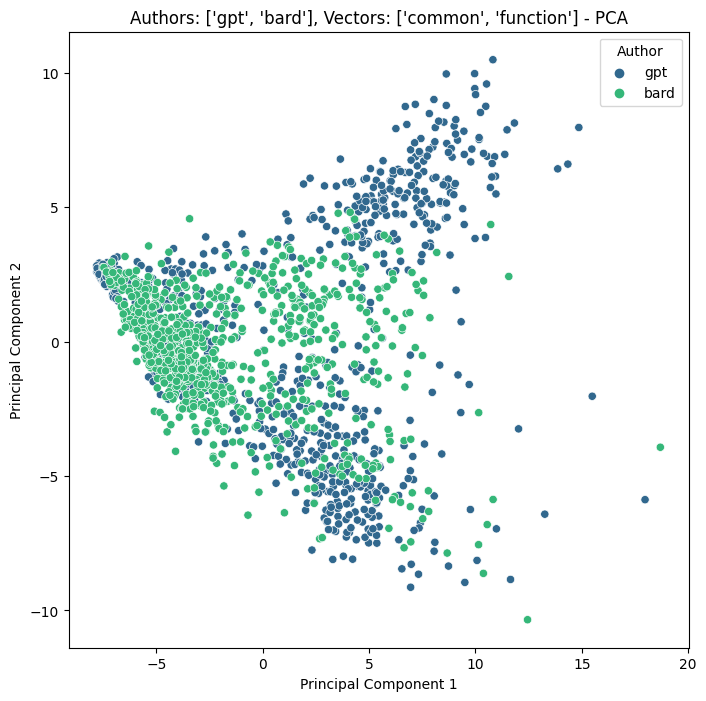

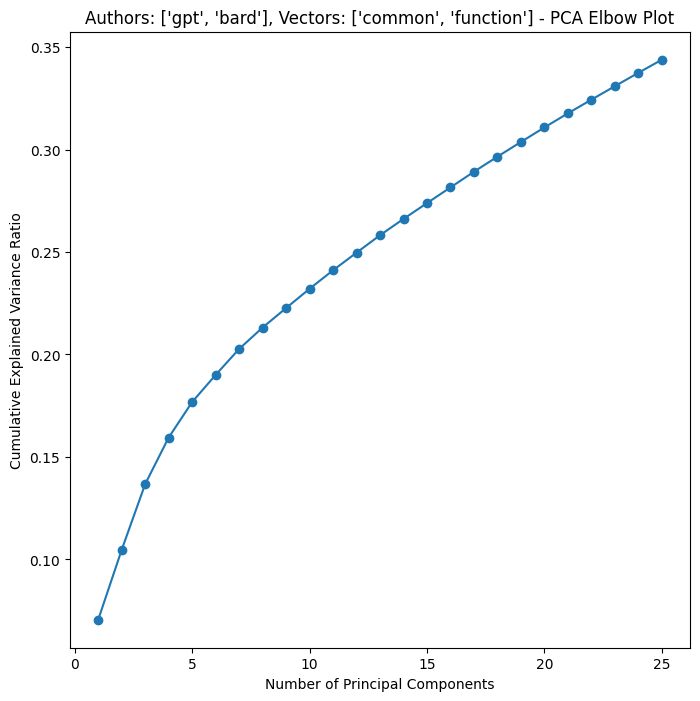

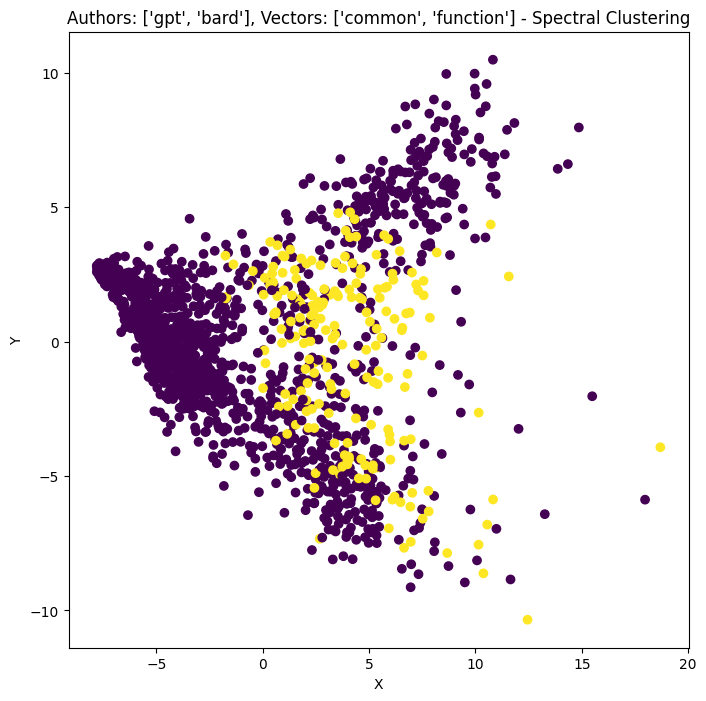

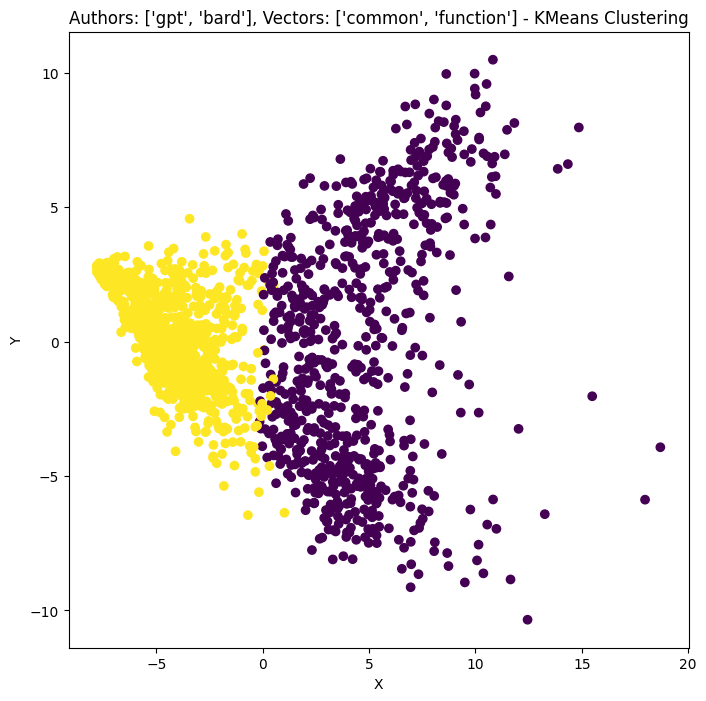

['bert'] scores:
KMeans Adjusted Rand Index: 0.04250438761327354
KMeans Rand Index: 0.5212288930581613
Spectral Clustering Adjusted Rand Index: 0.01560288938612001
Spectral Clustering Rand Index: 0.5076618198874296


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


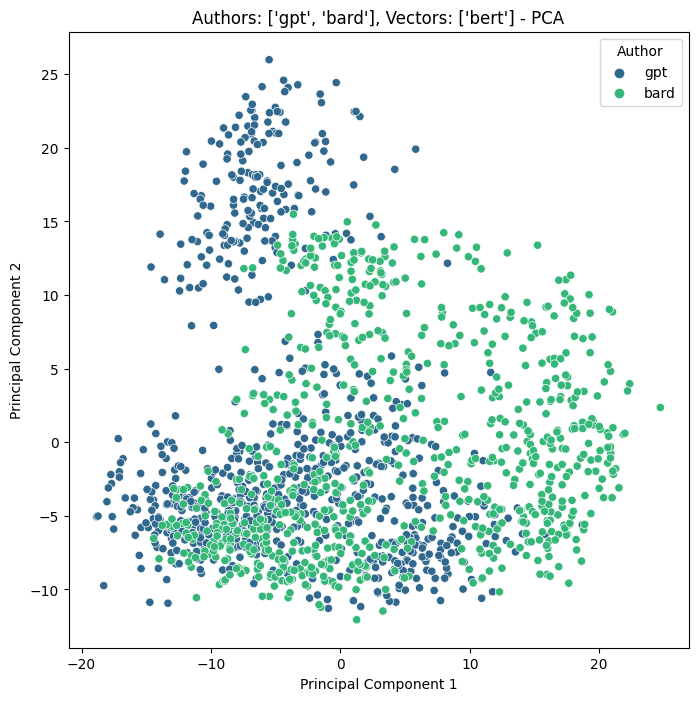

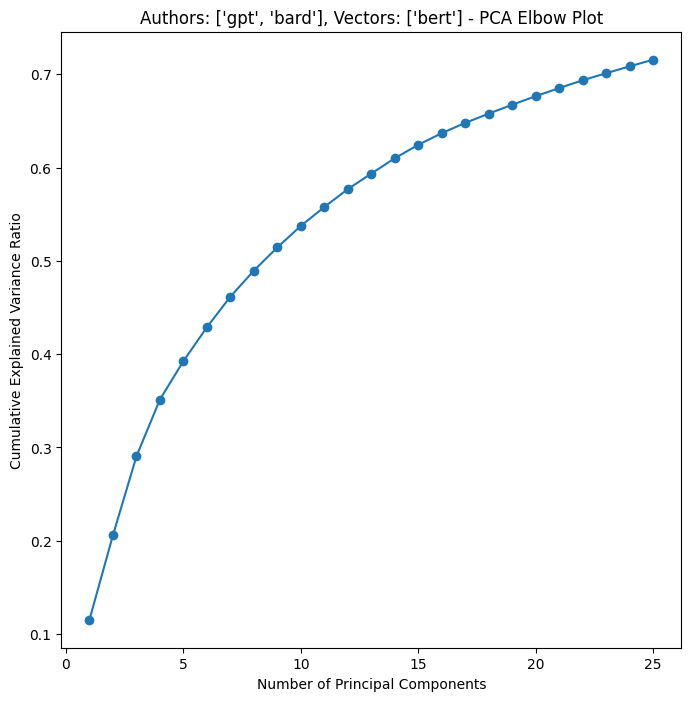

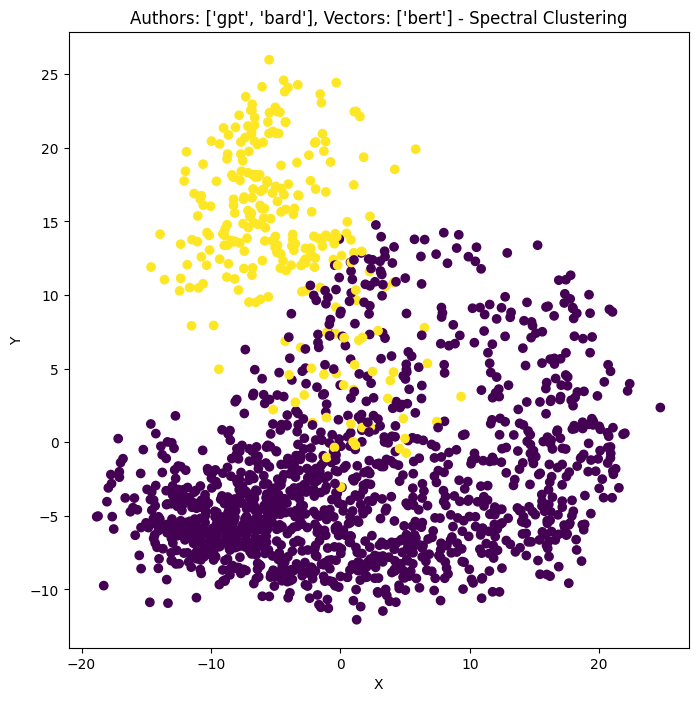

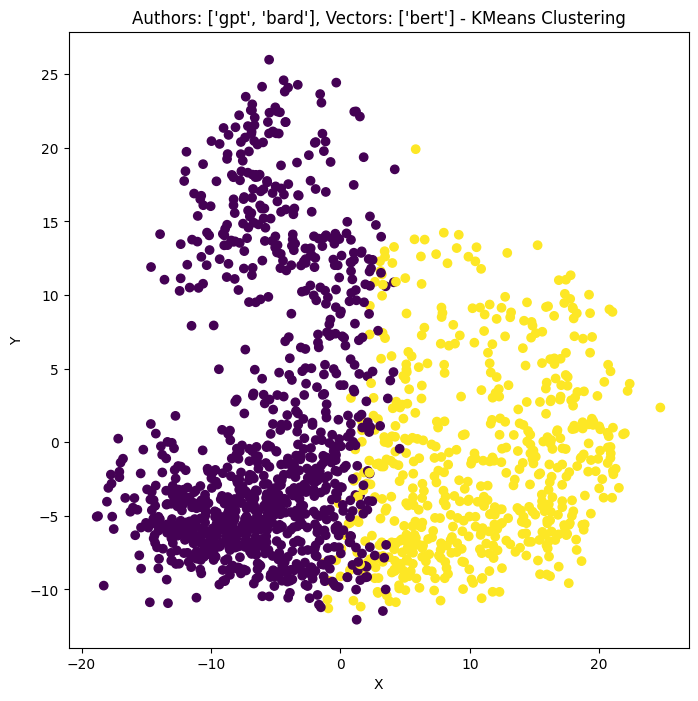

['common', 'function', 'bert'] scores:
KMeans Adjusted Rand Index: 0.04252465357994493
KMeans Rand Index: 0.5212288930581613
Spectral Clustering Adjusted Rand Index: 0.014979755661503868
Spectral Clustering Rand Index: 0.507349124452783


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


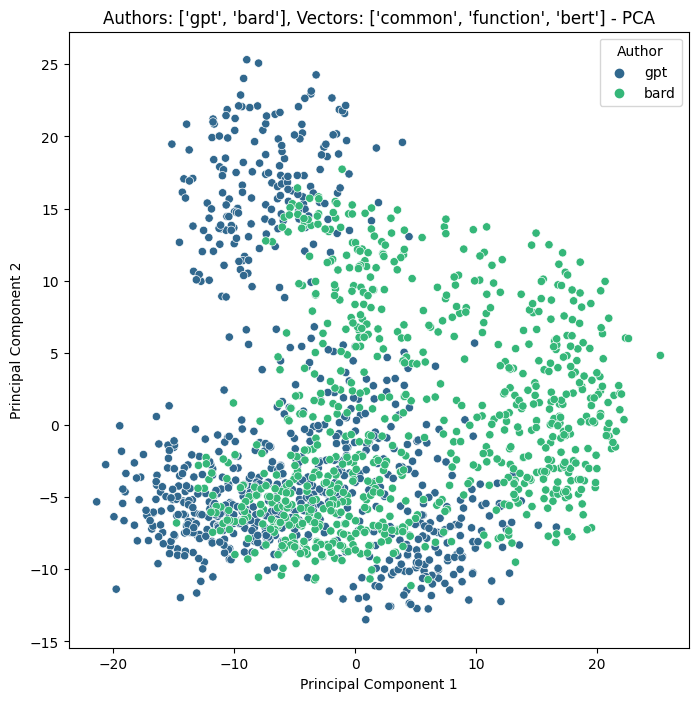

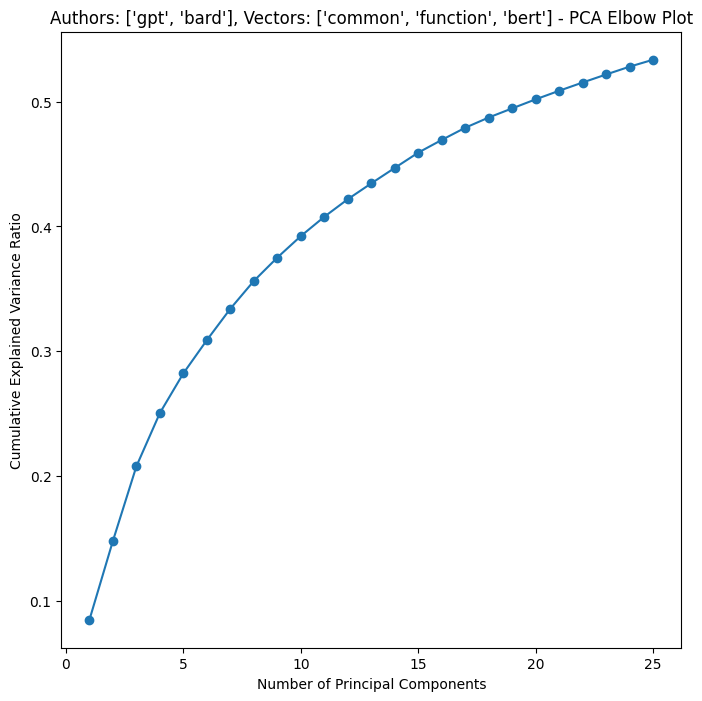

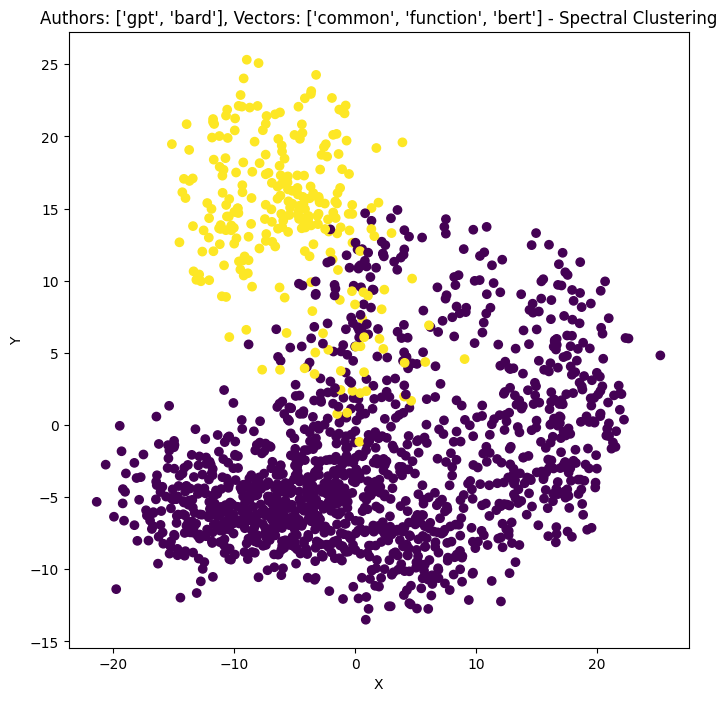

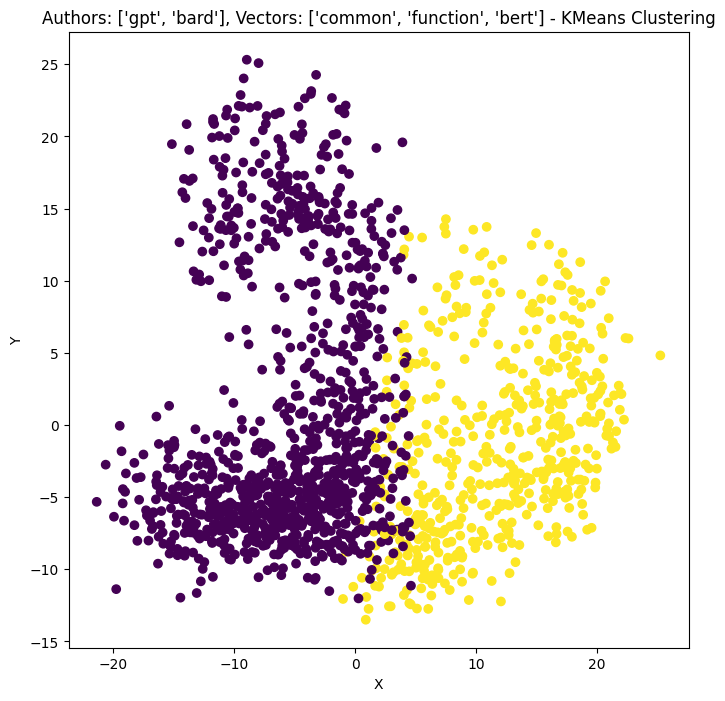

In [8]:
comp = []
for vector_names in list_of_vector_names:
    res = cluster_graph(["gpt", "bard"], vector_names)
    comp.append(res)
results_table.append(comp)

# GPT (temp 1.0) vs. Gemini

['common'] scores:
KMeans Adjusted Rand Index: 0.47407460404968027
KMeans Rand Index: 0.7370239212007504
Spectral Clustering Adjusted Rand Index: 0.7287221119228492
Spectral Clustering Rand Index: 0.864359756097561


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


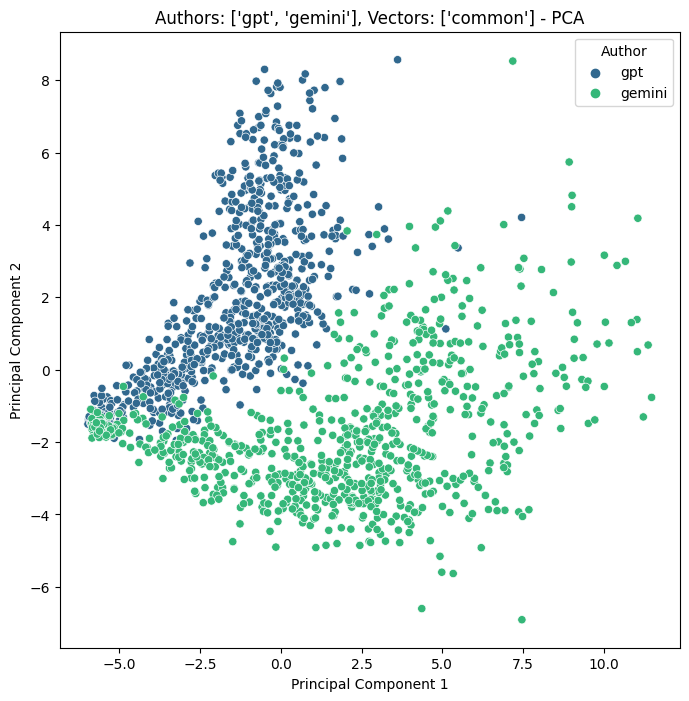

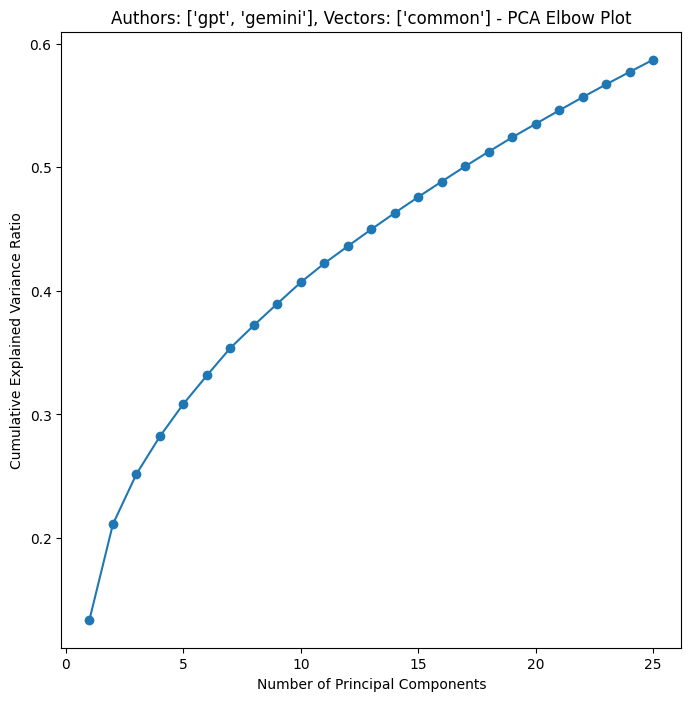

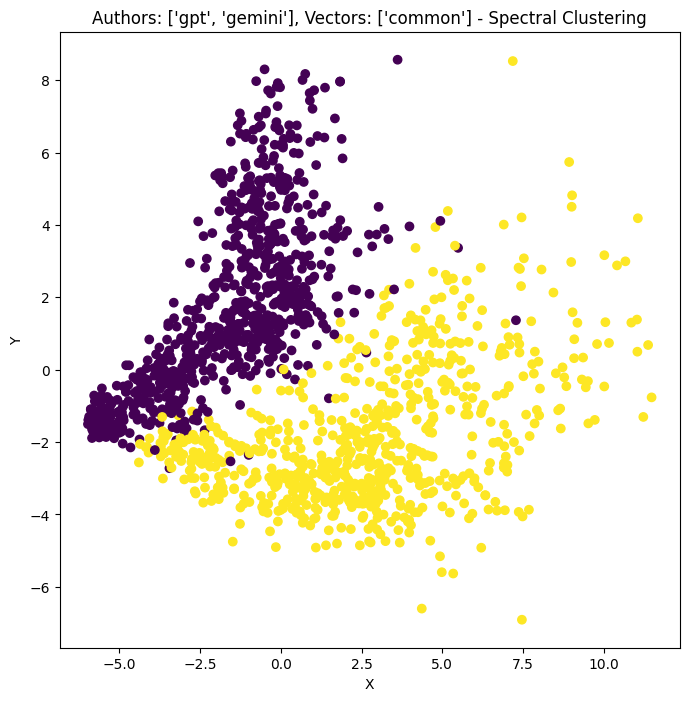

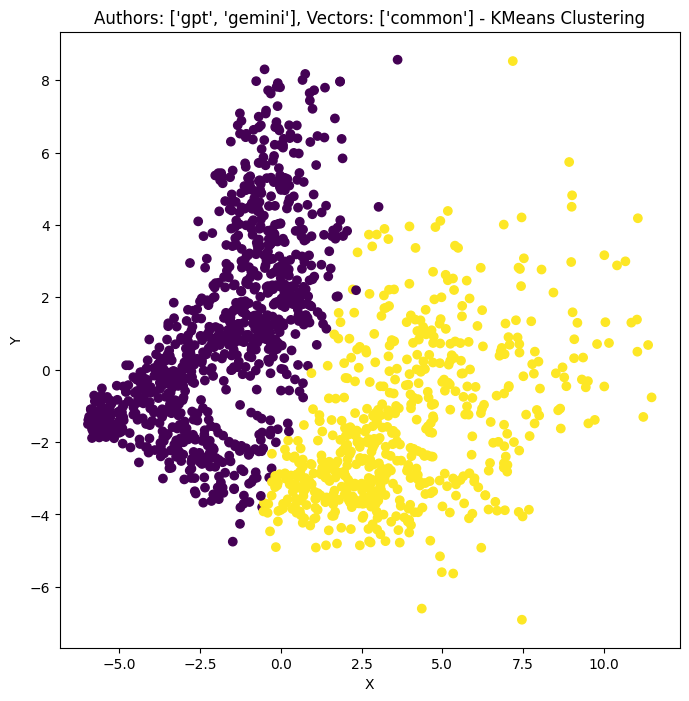

['function'] scores:
KMeans Adjusted Rand Index: 0.507370623549151
KMeans Rand Index: 0.7536741713570981
Spectral Clustering Adjusted Rand Index: 0.050946295014831056
Spectral Clustering Rand Index: 0.5252978424015009


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


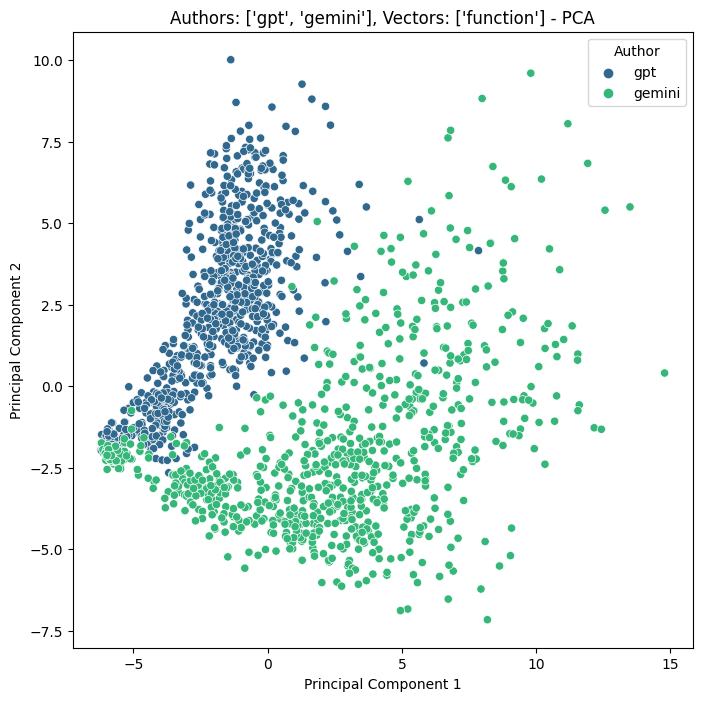

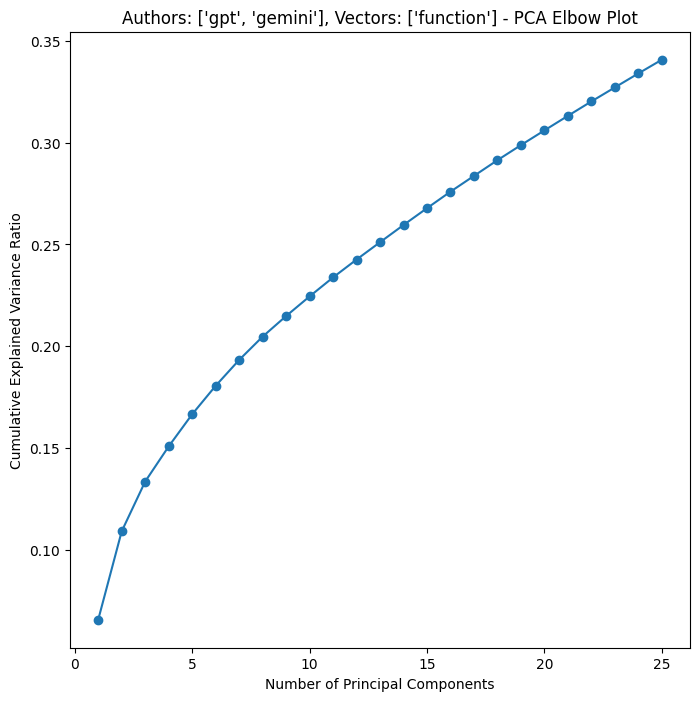

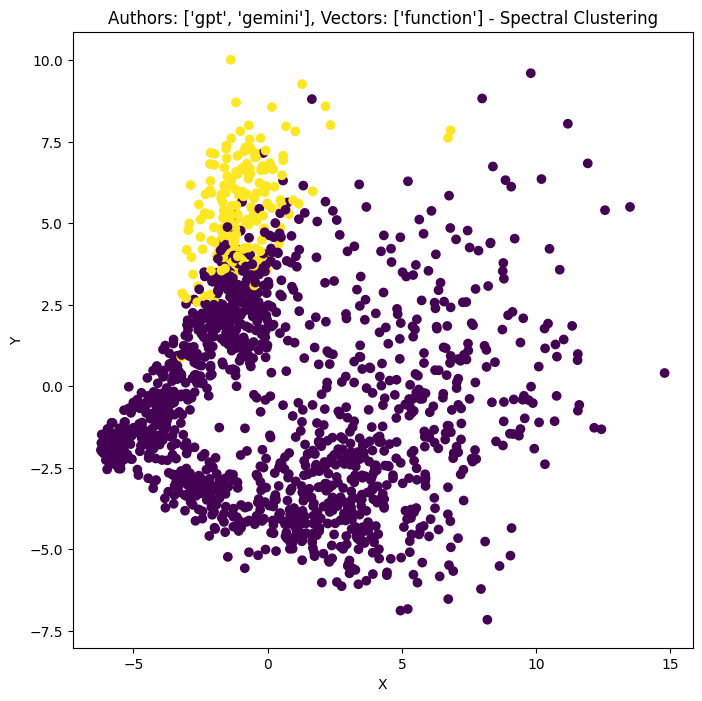

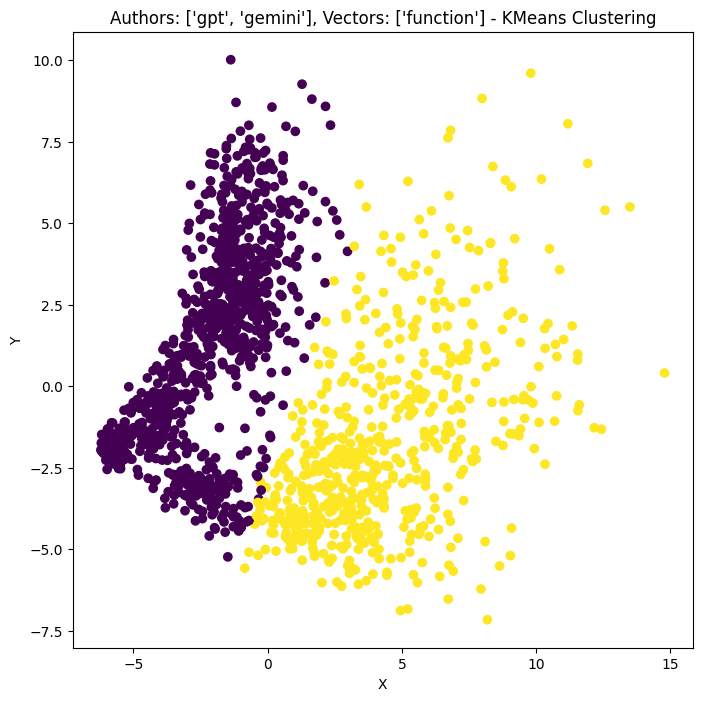

['common', 'function'] scores:
KMeans Adjusted Rand Index: 0.48795711832920996
KMeans Rand Index: 0.7439657598499062
Spectral Clustering Adjusted Rand Index: 0.6991300645525226
Spectral Clustering Rand Index: 0.8495630081300813


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


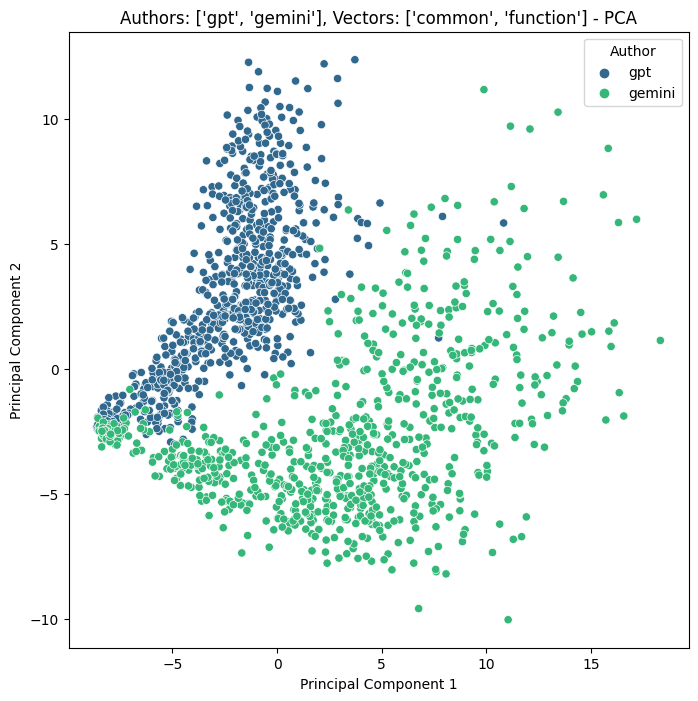

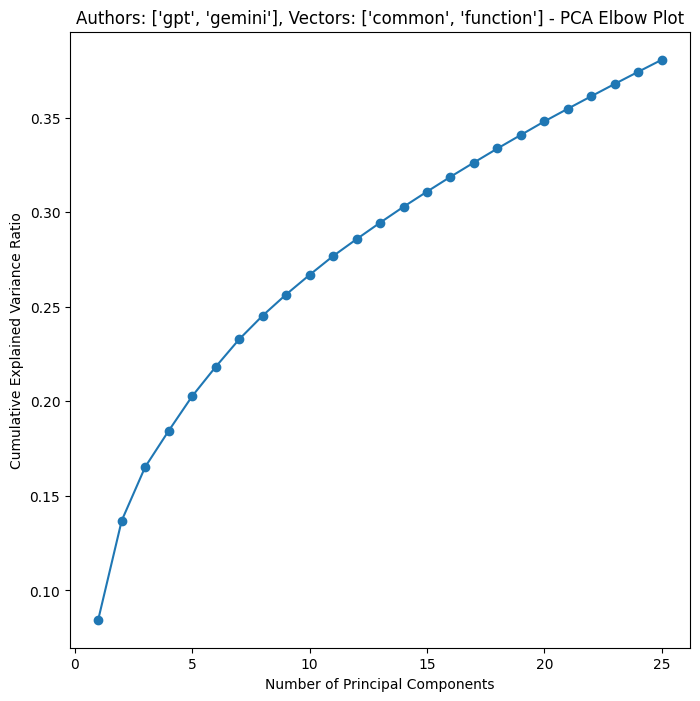

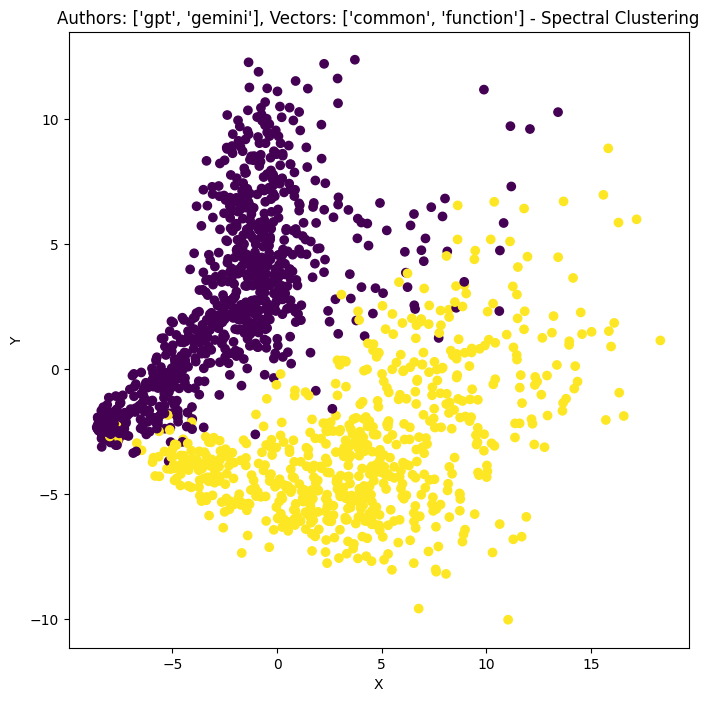

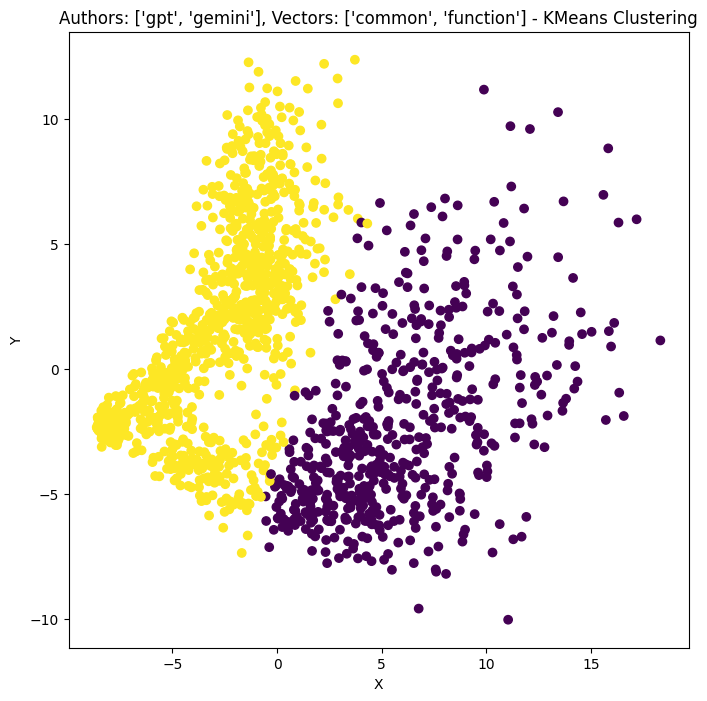

['bert'] scores:
KMeans Adjusted Rand Index: 0.5271501114627837
KMeans Rand Index: 0.7635717636022514
Spectral Clustering Adjusted Rand Index: 0.0465201628123243
Spectral Clustering Rand Index: 0.5230839587242027


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


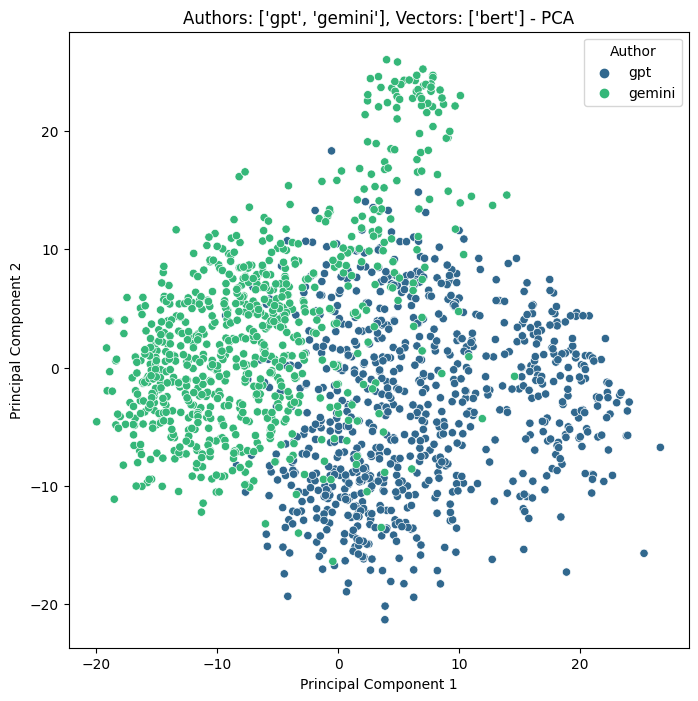

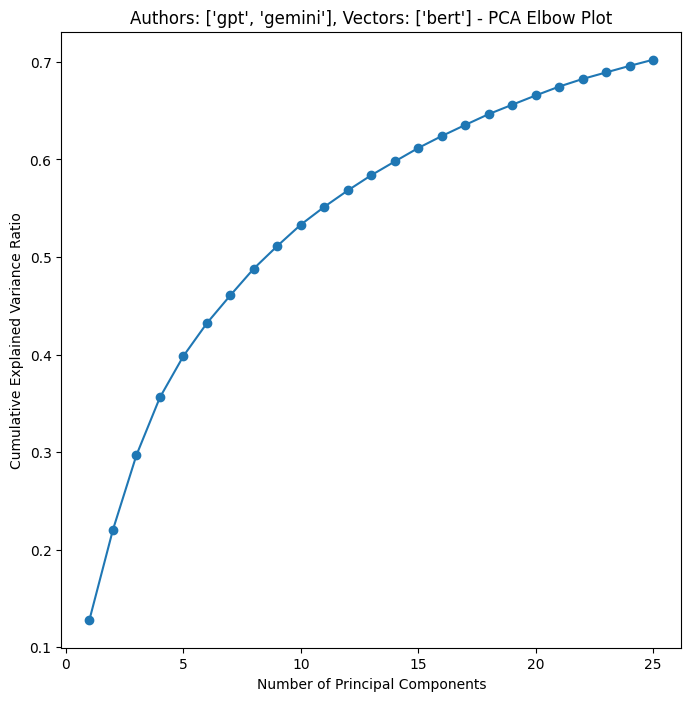

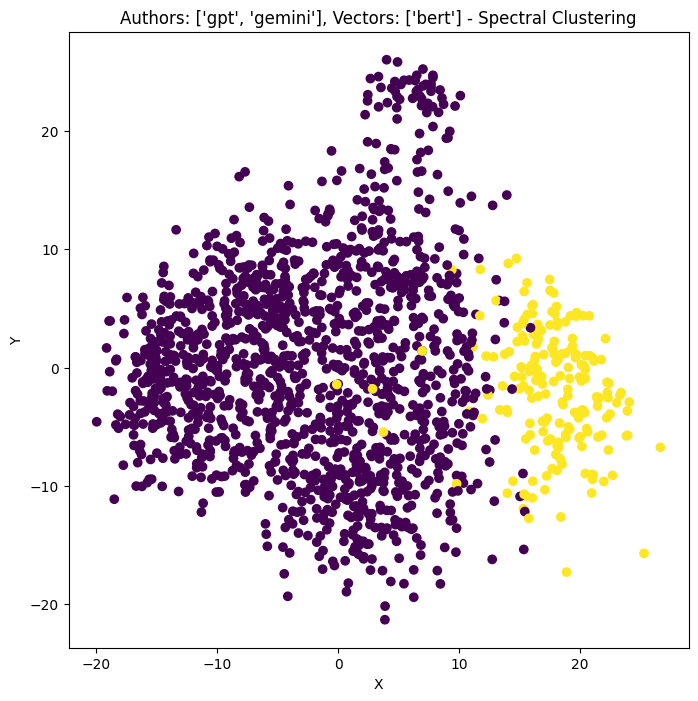

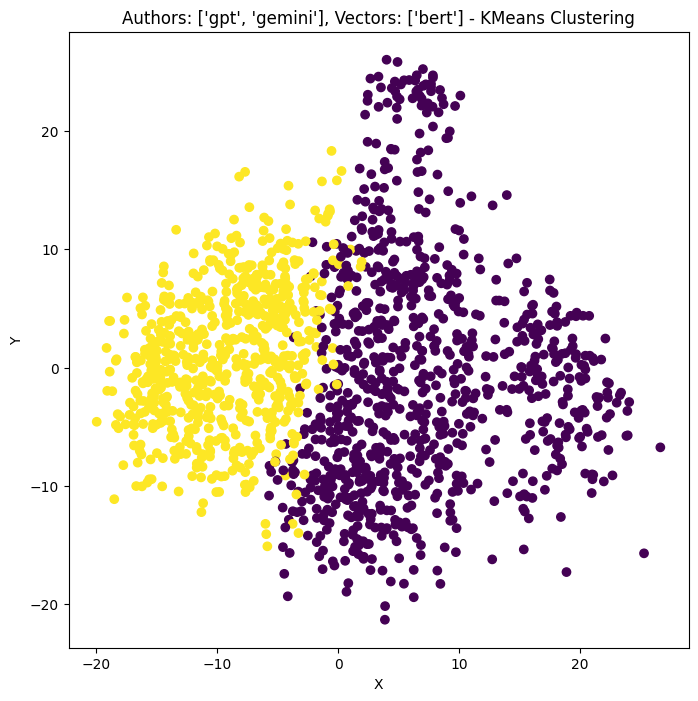

['common', 'function', 'bert'] scores:
KMeans Adjusted Rand Index: 0.678366788410122
KMeans Rand Index: 0.8391815196998124
Spectral Clustering Adjusted Rand Index: 0.0465201628123243
Spectral Clustering Rand Index: 0.5230839587242027


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


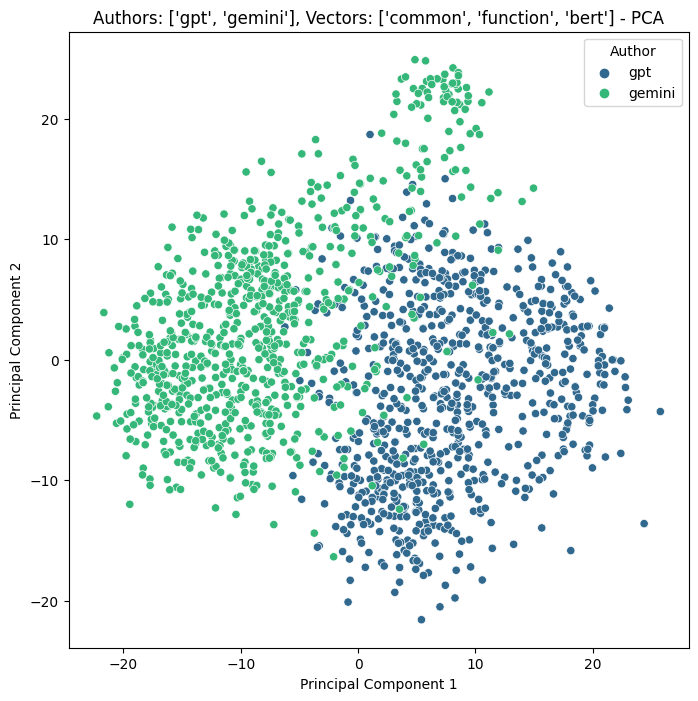

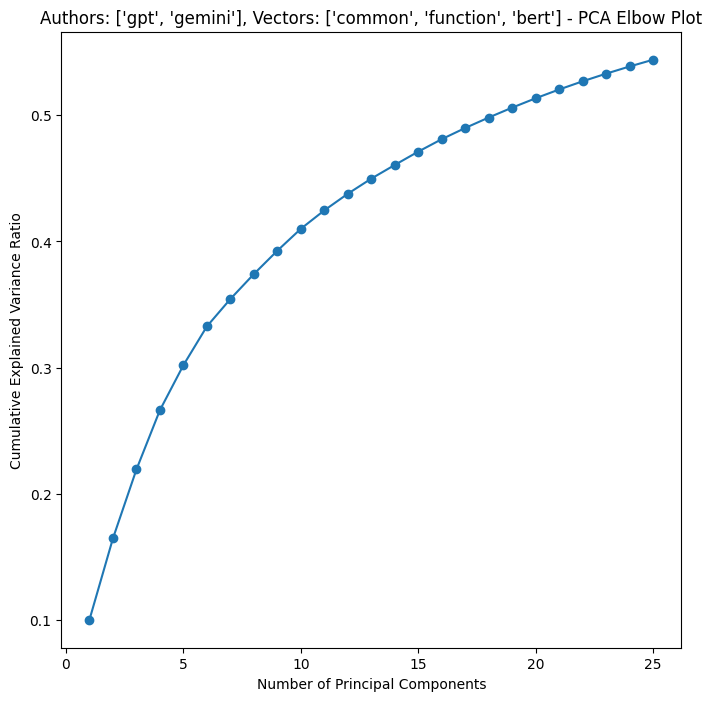

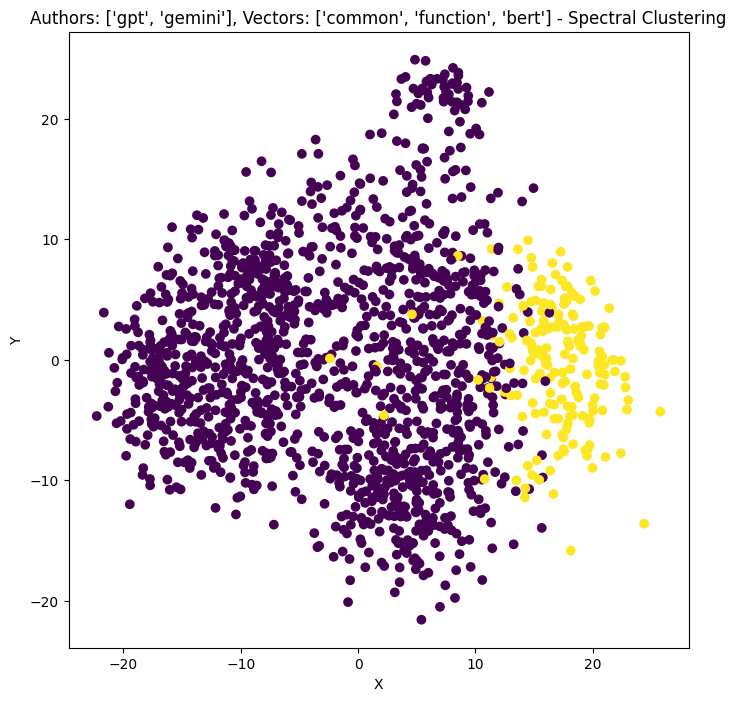

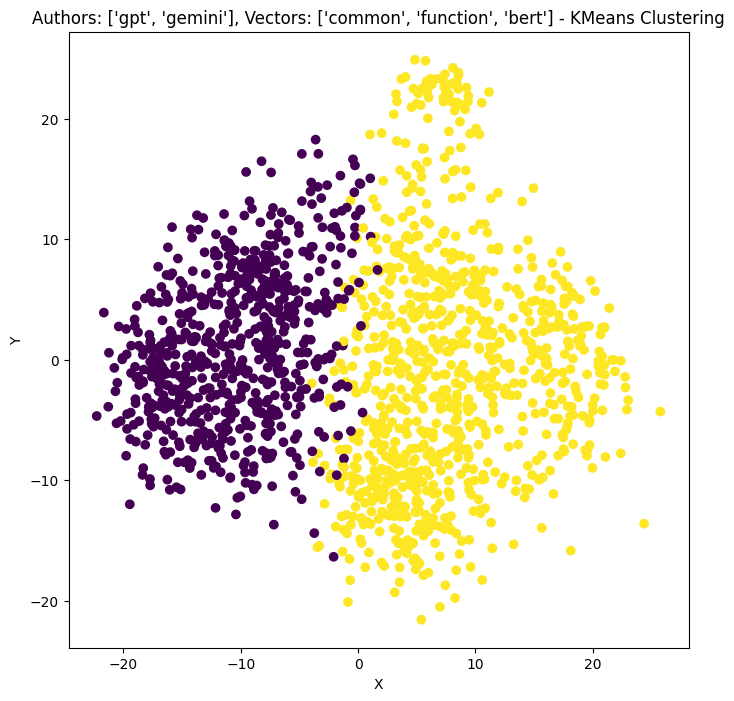

In [9]:
comp = []
for vector_names in list_of_vector_names:
    res = cluster_graph(["gpt", "gemini"], vector_names)
    comp.append(res)
results_table.append(comp)

# Bard vs. Gemini

['common'] scores:
KMeans Adjusted Rand Index: 0.40448188203291385
KMeans Rand Index: 0.7022209193245779
Spectral Clustering Adjusted Rand Index: 0.4502699226373994
Spectral Clustering Rand Index: 0.7251164790494059


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


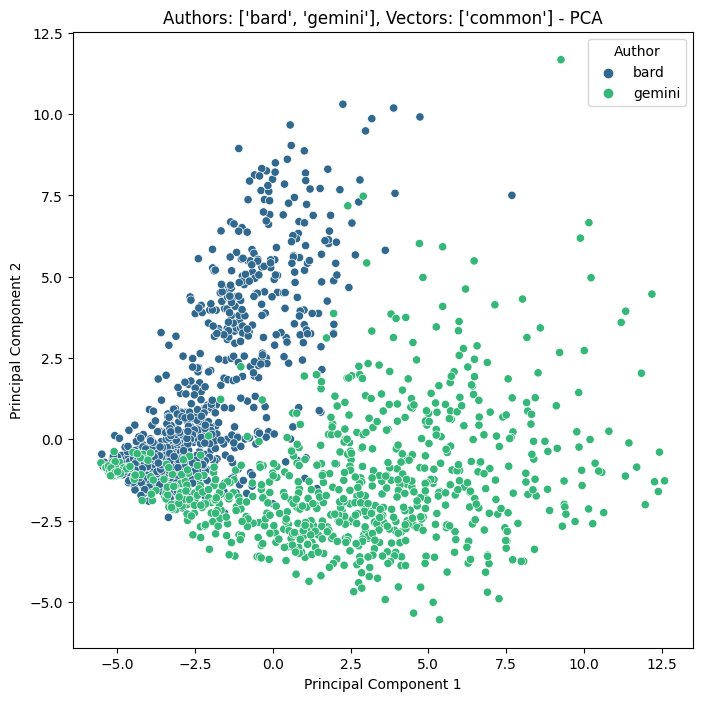

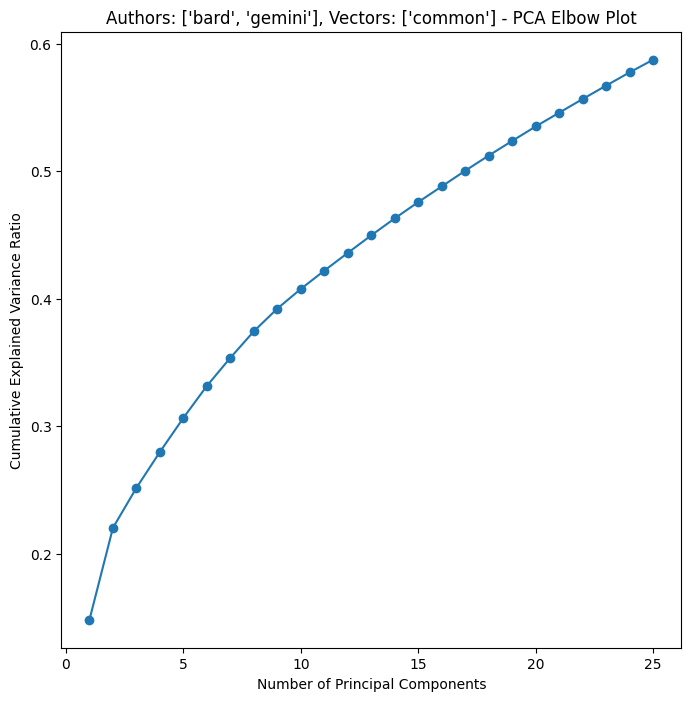

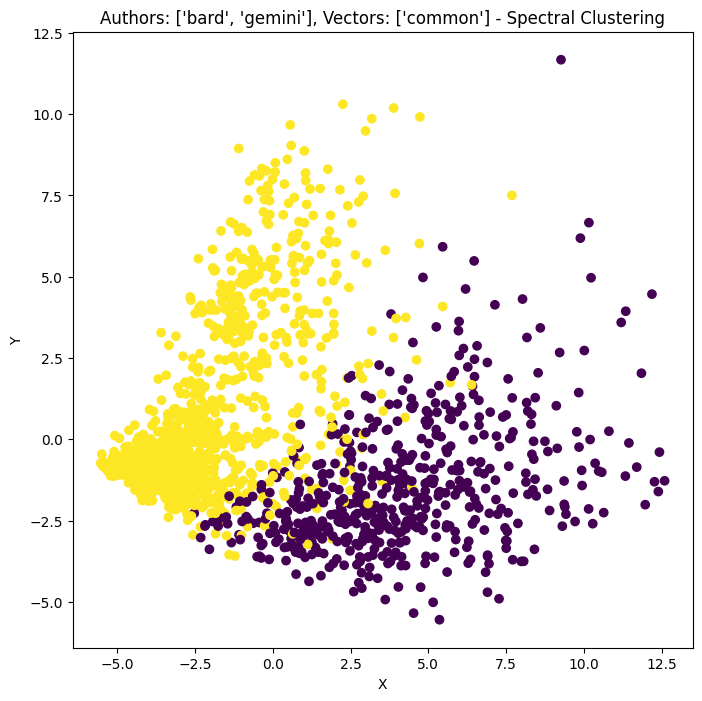

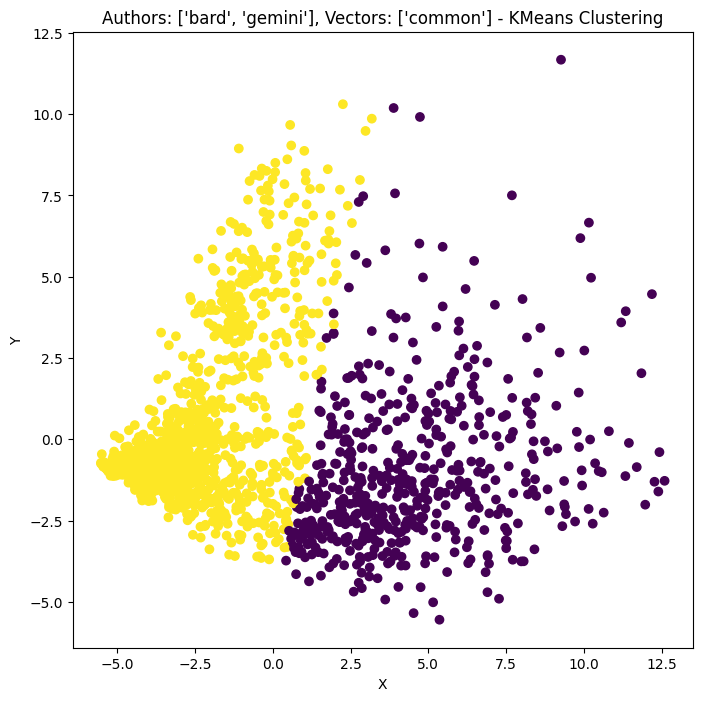

['function'] scores:
KMeans Adjusted Rand Index: 0.40927647127062994
KMeans Rand Index: 0.7046153846153846
Spectral Clustering Adjusted Rand Index: 0.056137025482467885
Spectral Clustering Rand Index: 0.5279080675422139


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


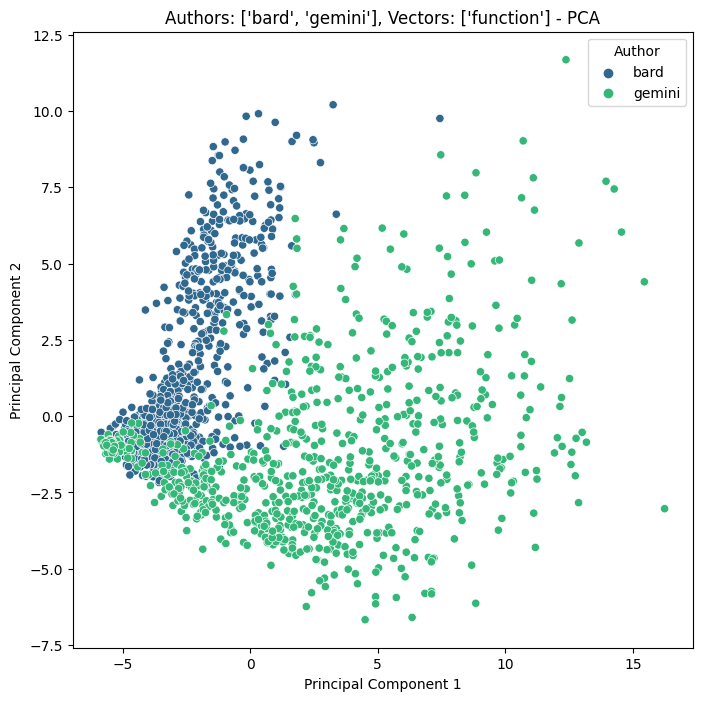

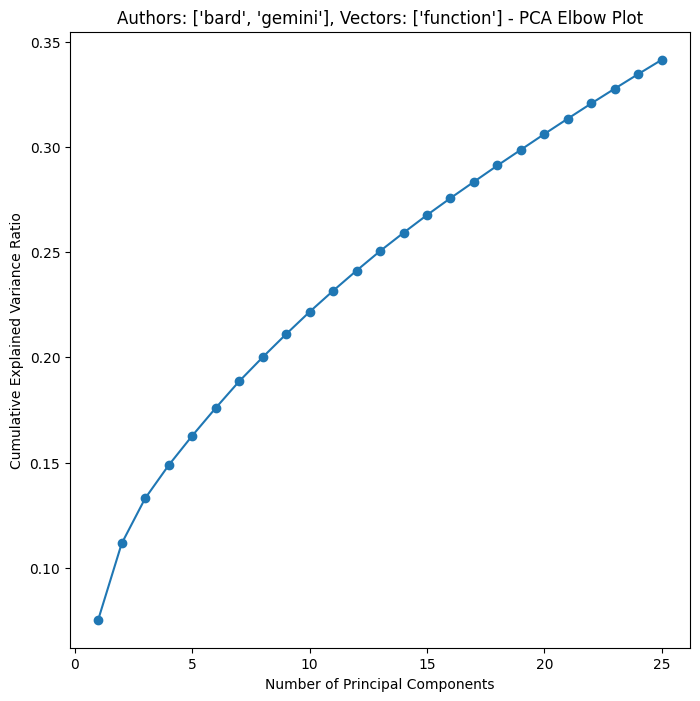

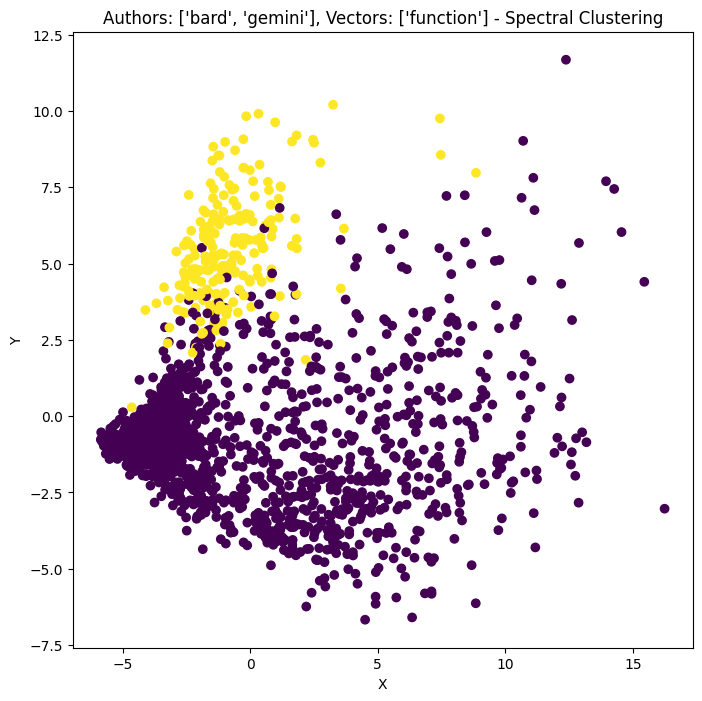

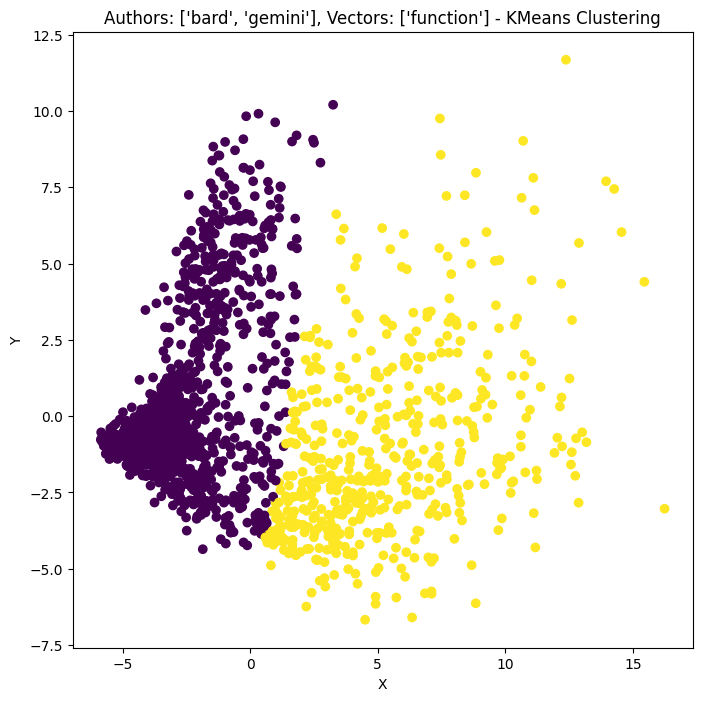

['common', 'function'] scores:
KMeans Adjusted Rand Index: 0.4205545477616988
KMeans Rand Index: 0.7102571919949969
Spectral Clustering Adjusted Rand Index: 0.5584977423518862
Spectral Clustering Rand Index: 0.7792401500938086


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


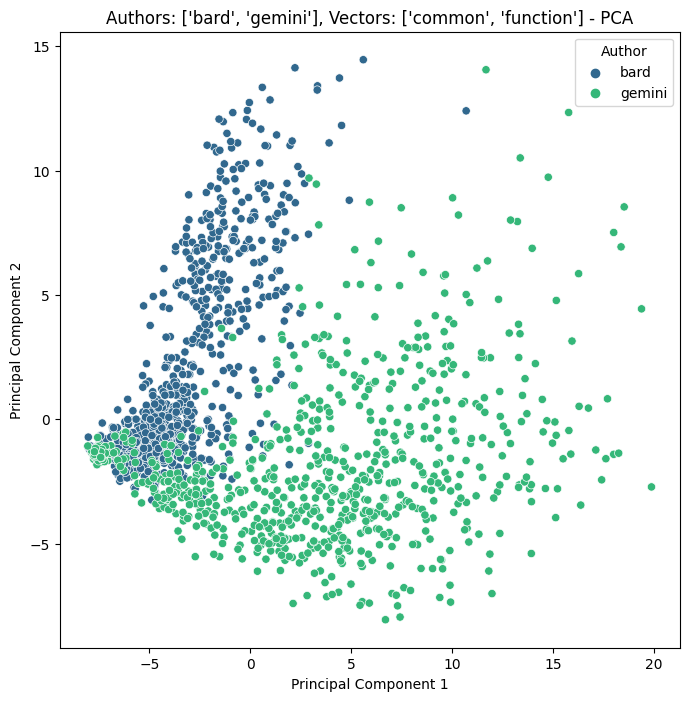

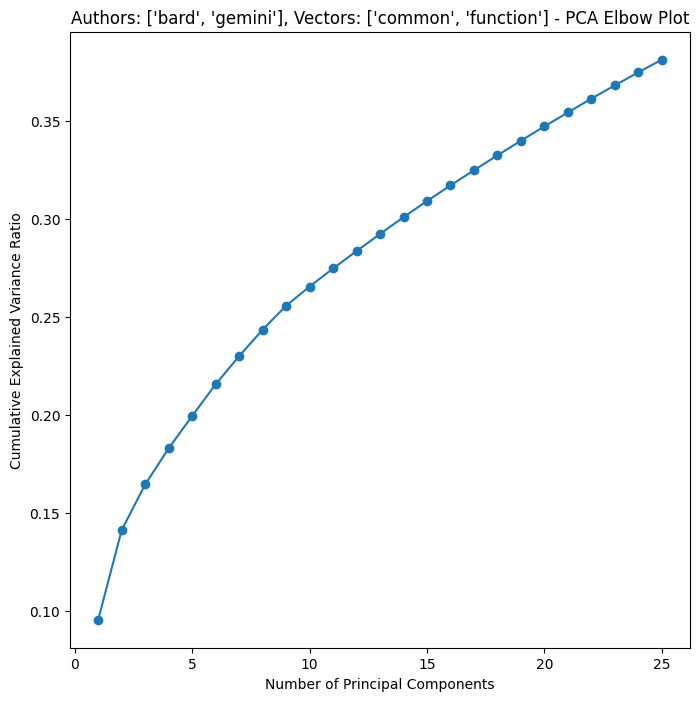

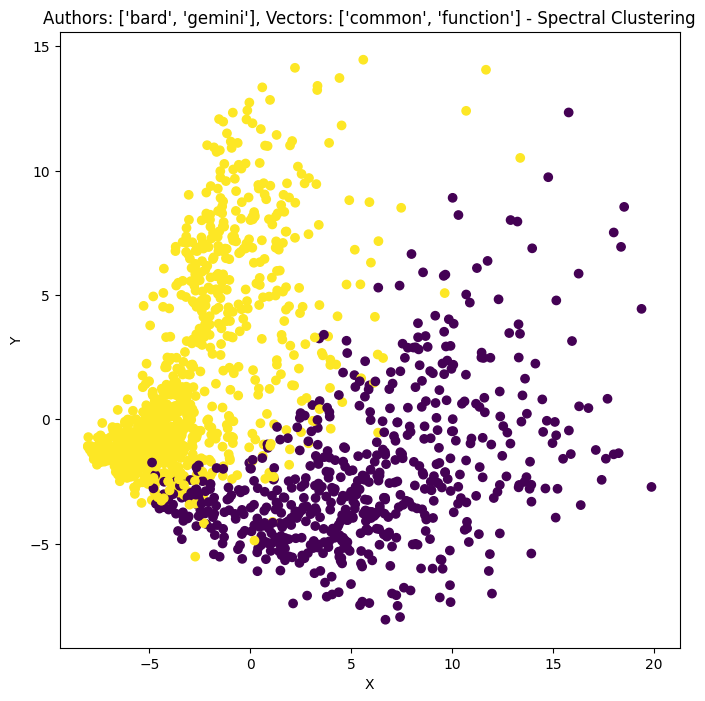

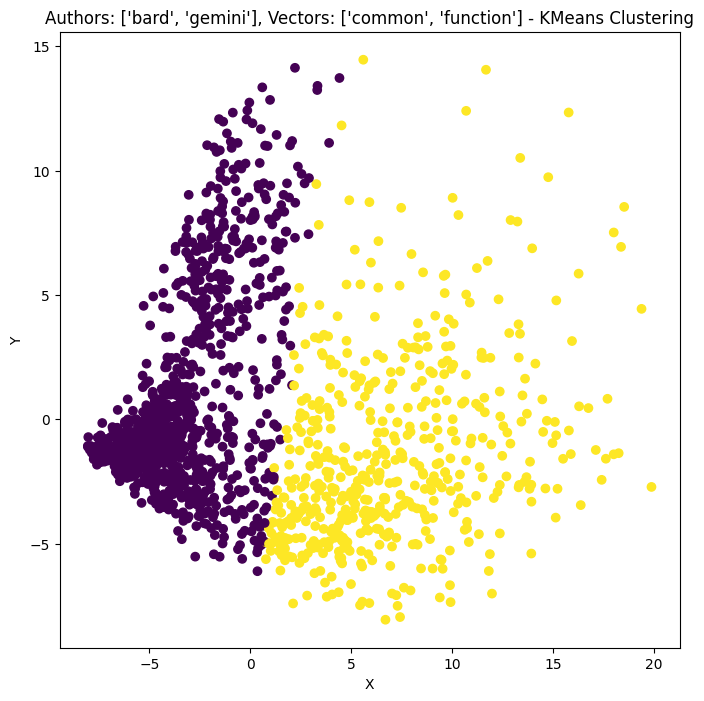

['bert'] scores:
KMeans Adjusted Rand Index: 0.9071983436381333
KMeans Rand Index: 0.9535991244527829
Spectral Clustering Adjusted Rand Index: 0.7853065324591332
Spectral Clustering Rand Index: 0.8926524390243903


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


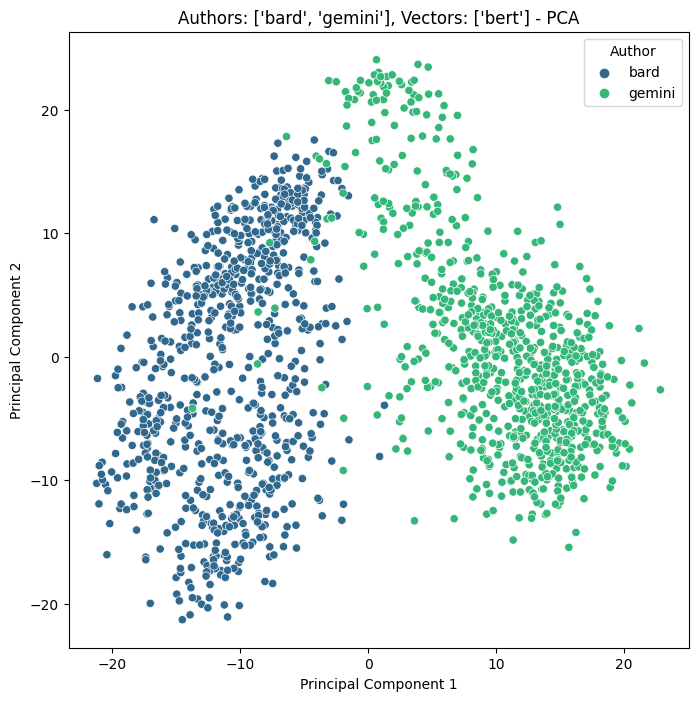

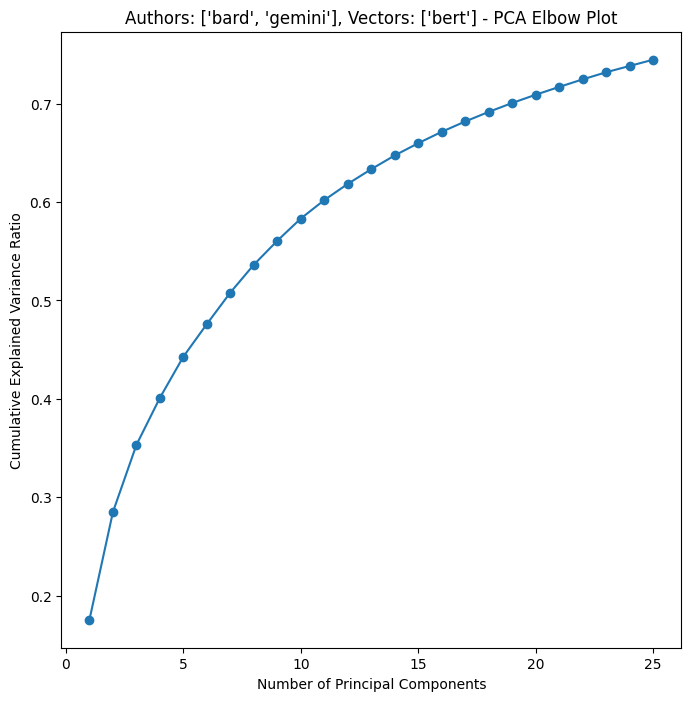

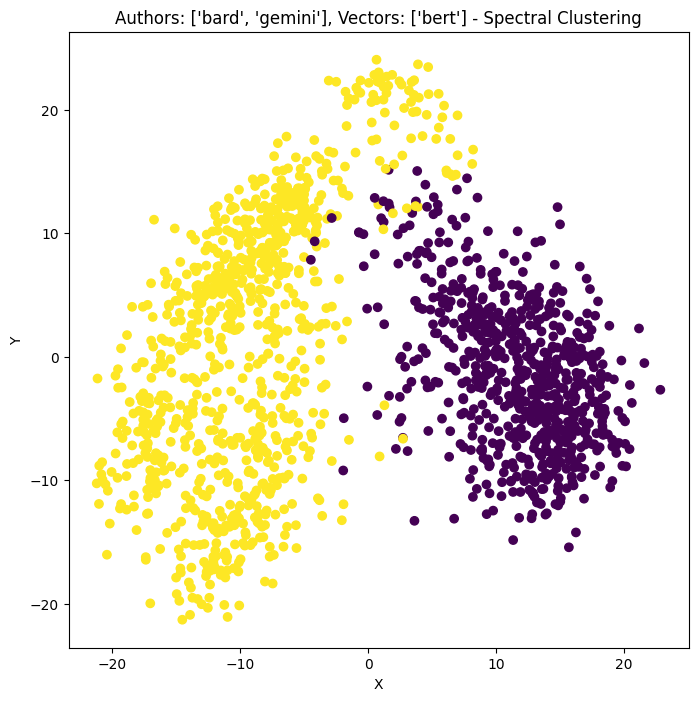

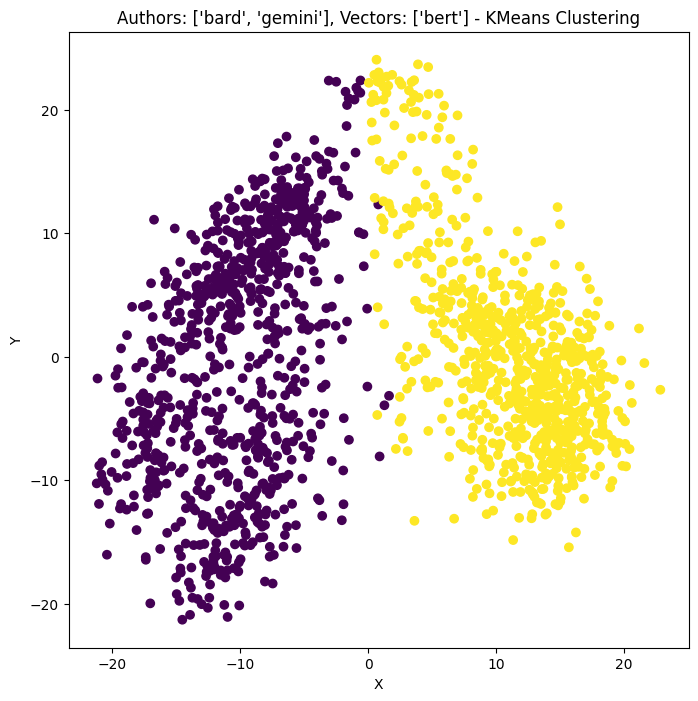

['common', 'function', 'bert'] scores:
KMeans Adjusted Rand Index: 0.765480625384999
KMeans Rand Index: 0.8827392120075047
Spectral Clustering Adjusted Rand Index: 0.774260857724436
Spectral Clustering Rand Index: 0.8871294559099437


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


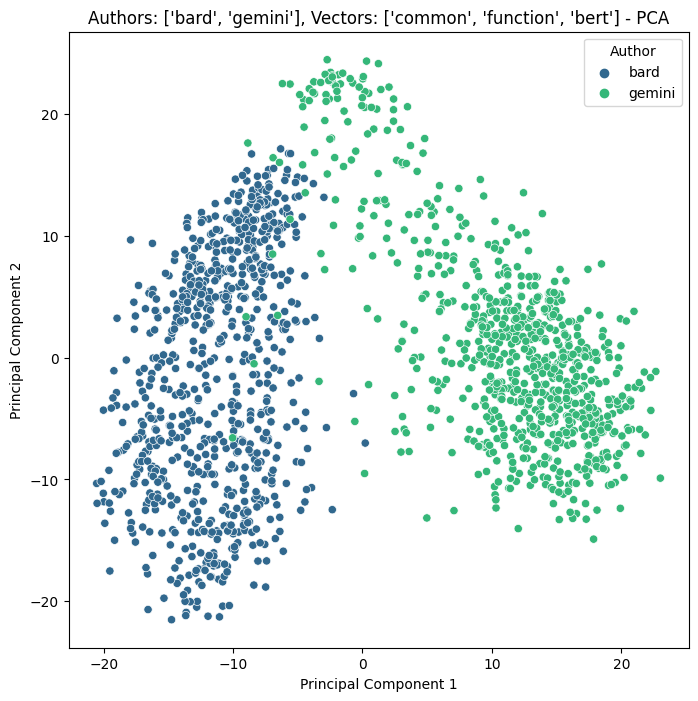

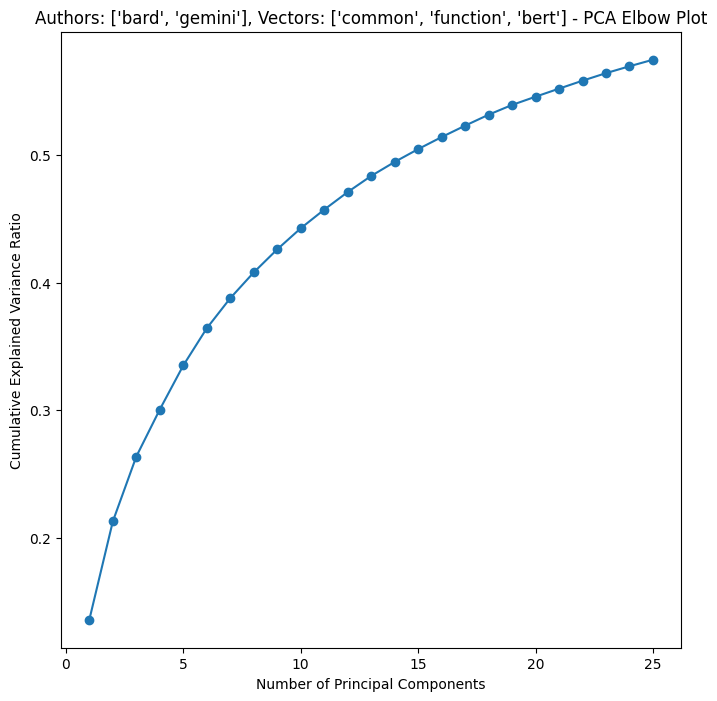

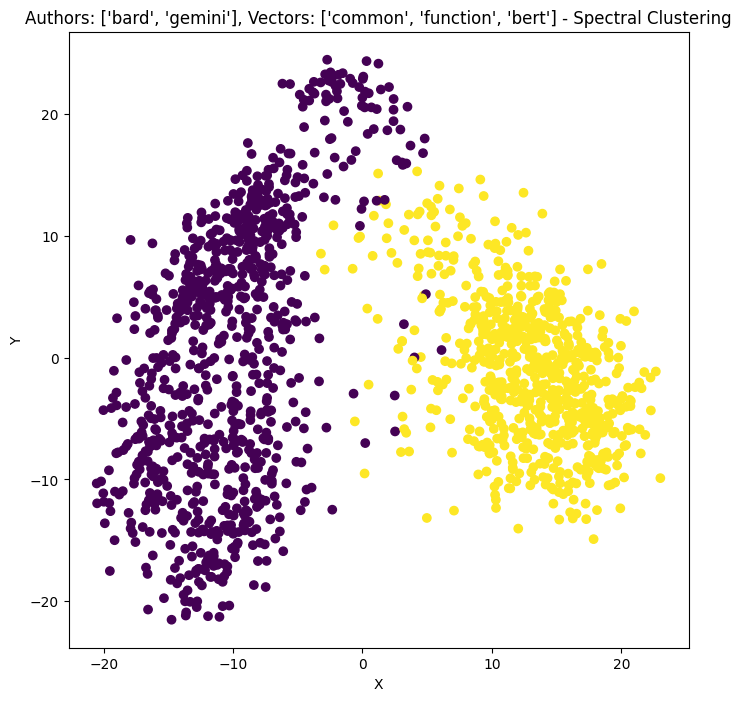

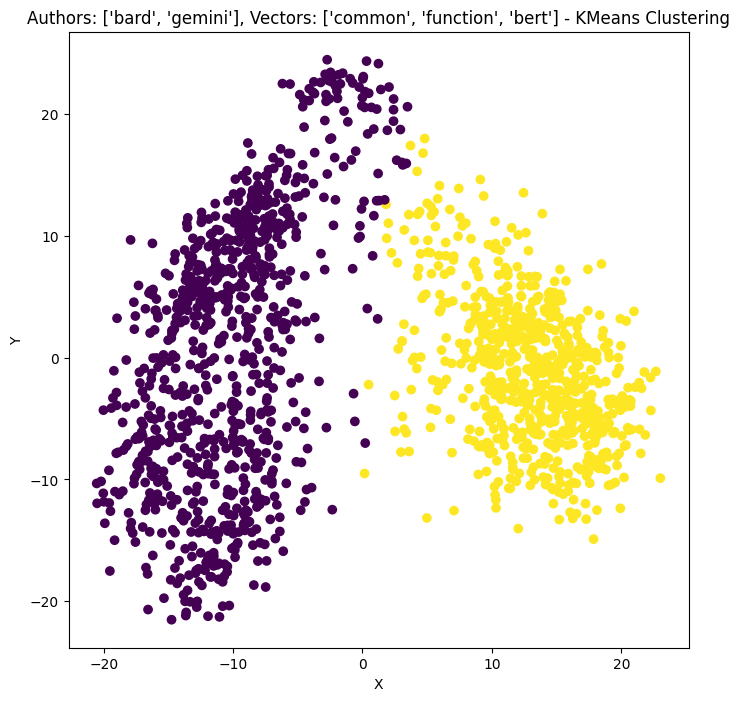

In [10]:
comp = []
for vector_names in list_of_vector_names:
    res = cluster_graph(["bard", "gemini"], vector_names)
    comp.append(res)
results_table.append(comp)

# Reddit vs. GPT (temp 1.0) vs. Bard

['common'] scores:
KMeans Adjusted Rand Index: 0.13303494680594918
KMeans Rand Index: 0.587087675420314
Spectral Clustering Adjusted Rand Index: 0.04907978994731714
Spectral Clustering Rand Index: 0.47107510073641795


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


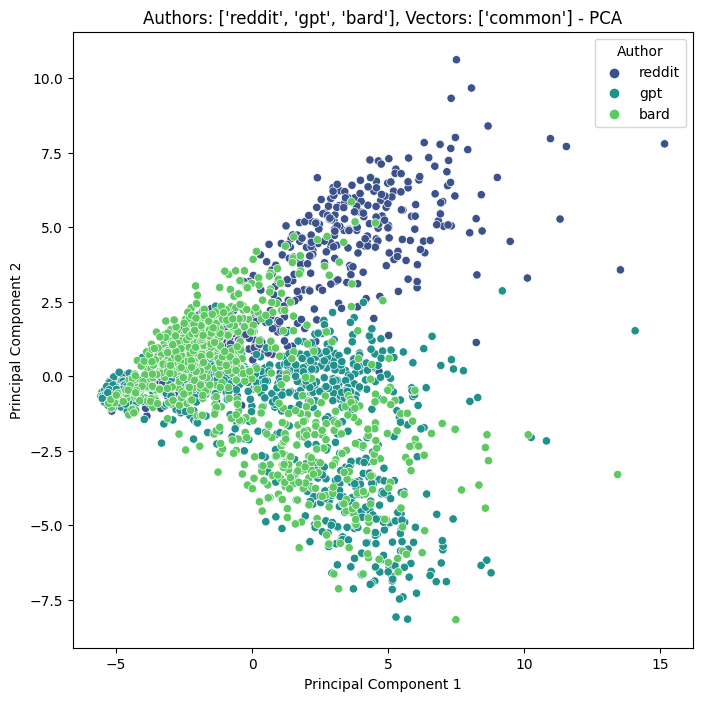

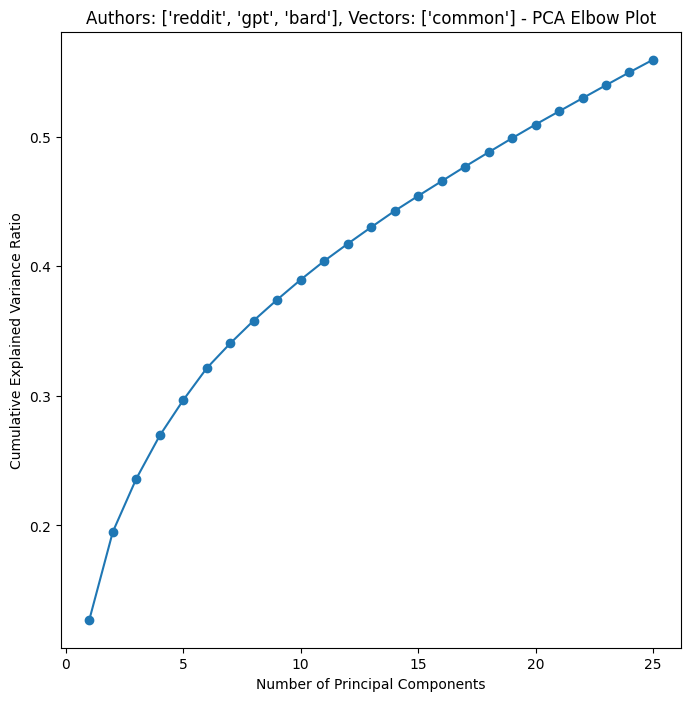

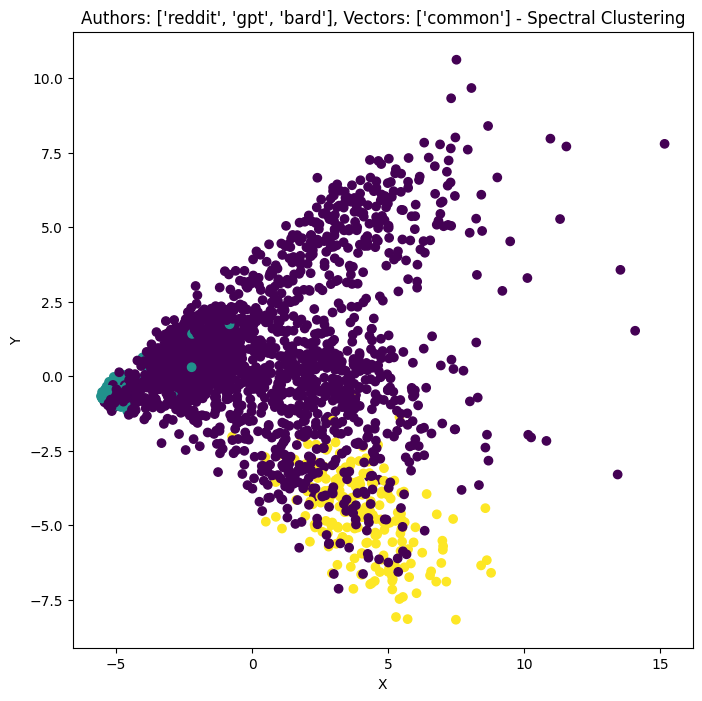

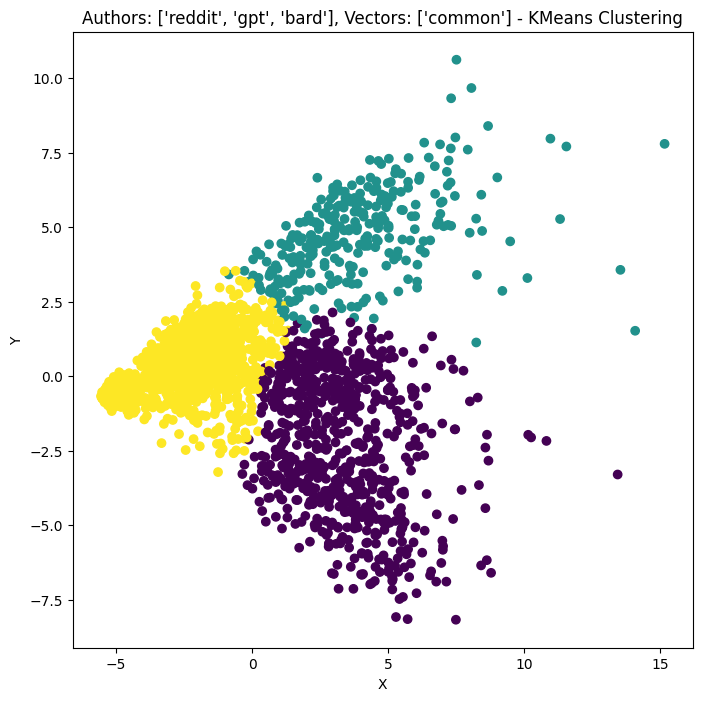

['function'] scores:
KMeans Adjusted Rand Index: 0.14524485552198568
KMeans Rand Index: 0.5906370710018063
Spectral Clustering Adjusted Rand Index: 0.022392351095772495
Spectral Clustering Rand Index: 0.40513443101292207


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


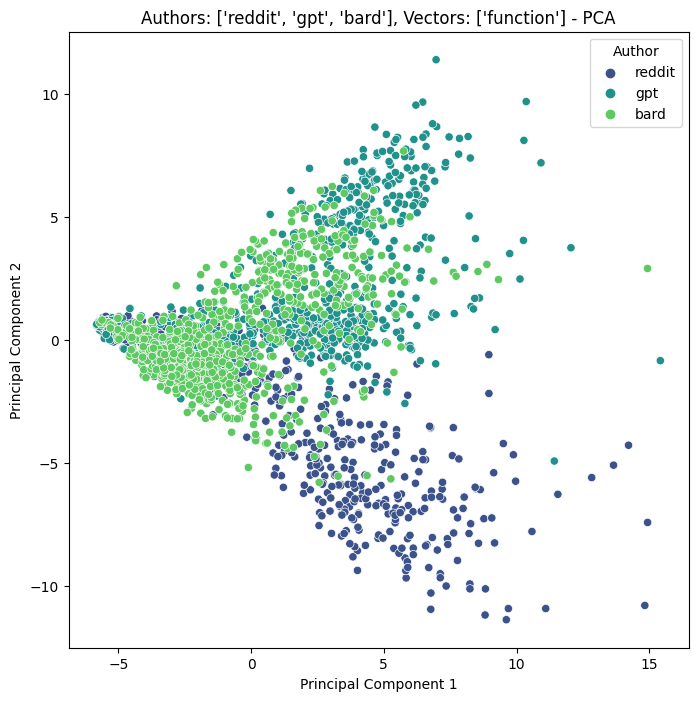

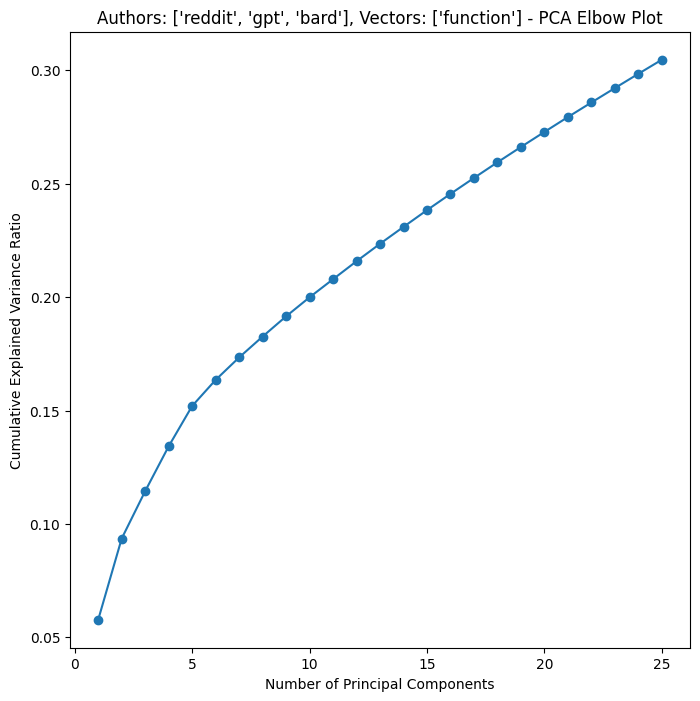

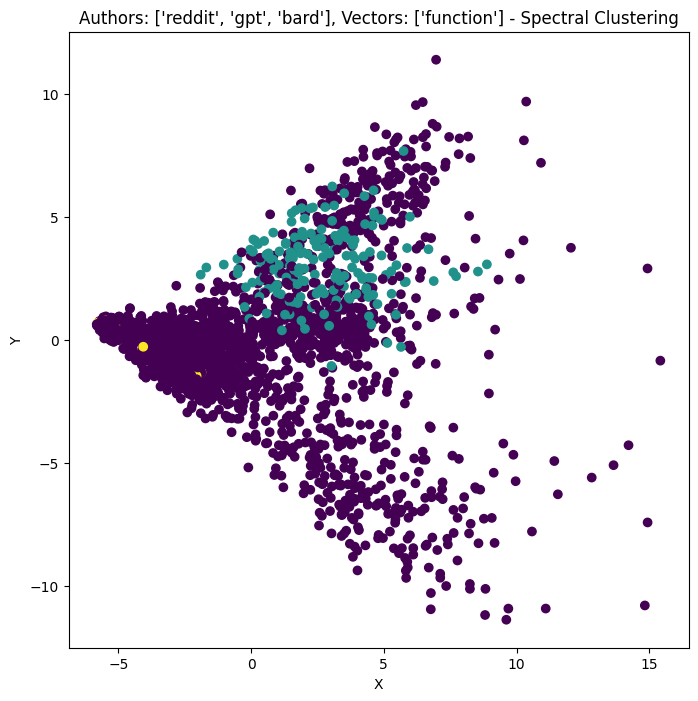

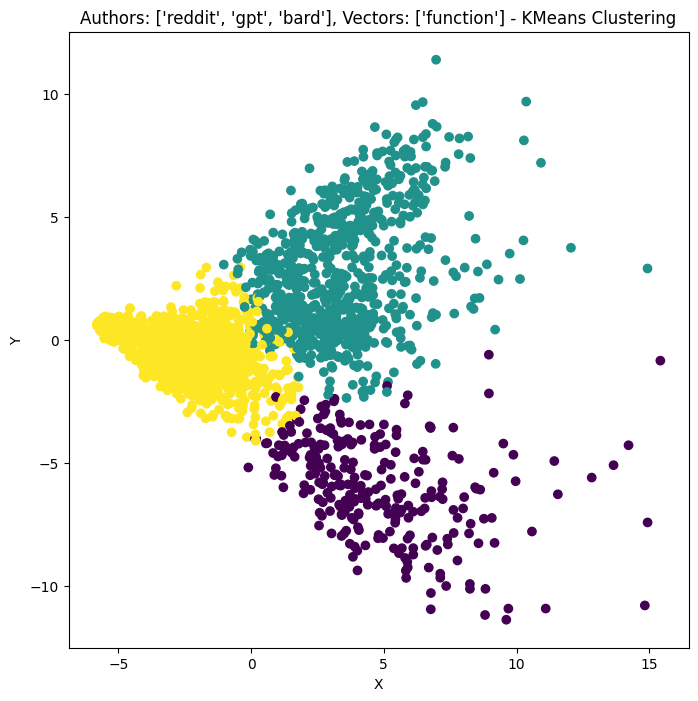

['common', 'function'] scores:
KMeans Adjusted Rand Index: 0.13788297827905674
KMeans Rand Index: 0.5873193691816034
Spectral Clustering Adjusted Rand Index: 0.0027040423874123767
Spectral Clustering Rand Index: 0.3596640961511741


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


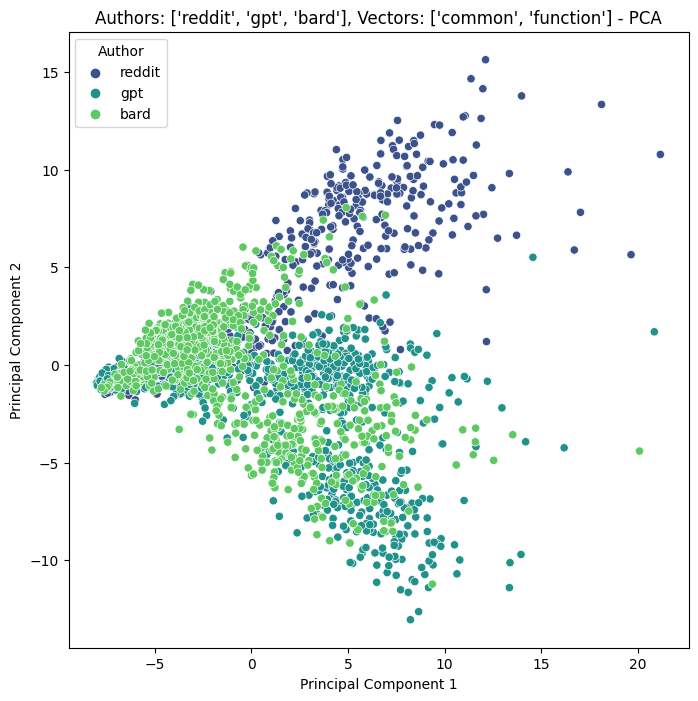

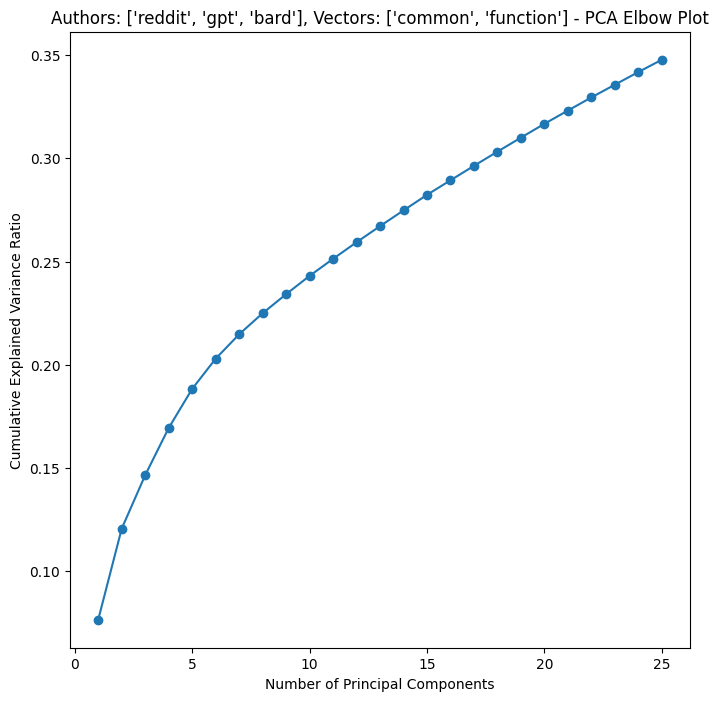

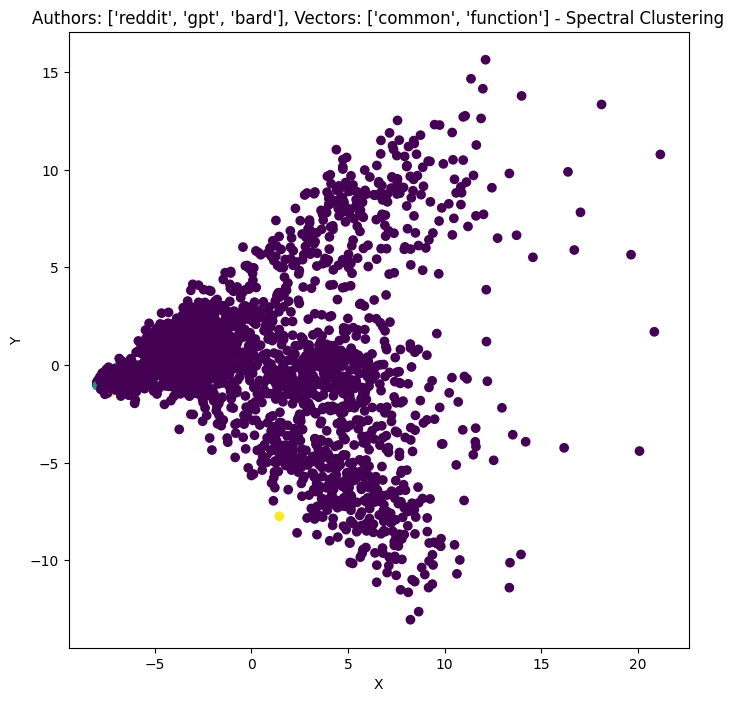

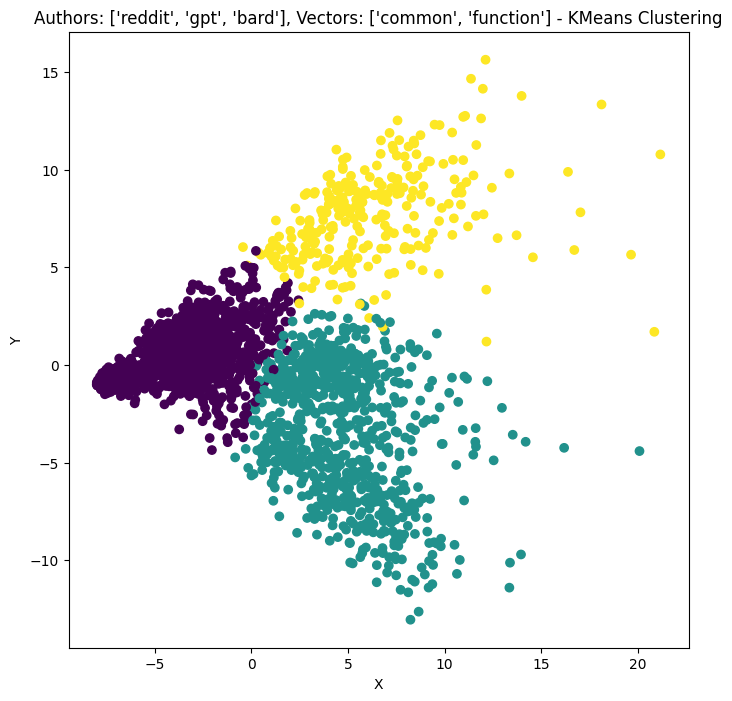

['bert'] scores:
KMeans Adjusted Rand Index: 0.3878426710834353
KMeans Rand Index: 0.7247356537446158
Spectral Clustering Adjusted Rand Index: 0.023574249063244606
Spectral Clustering Rand Index: 0.4117934556065027


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


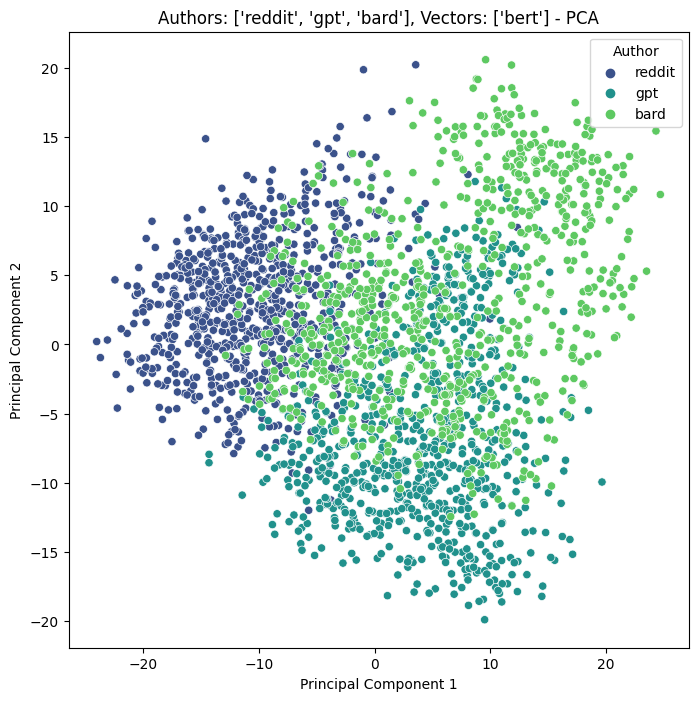

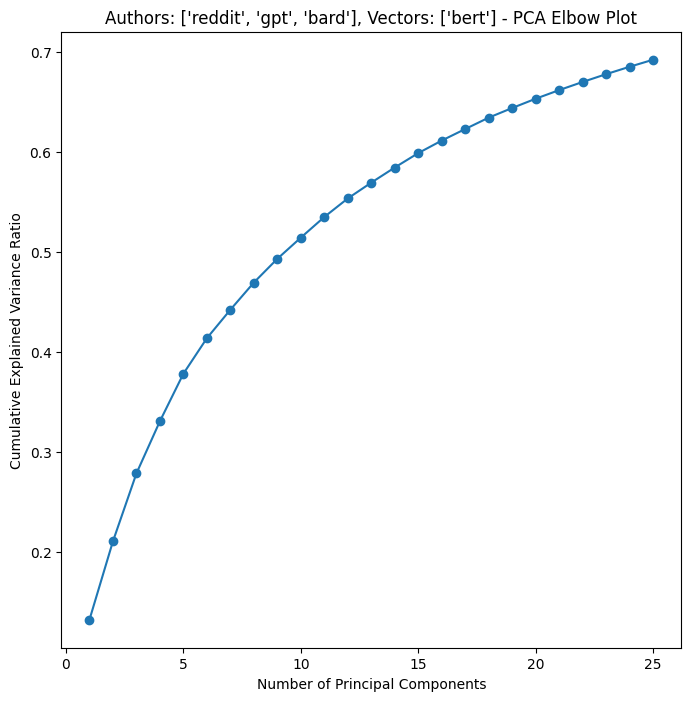

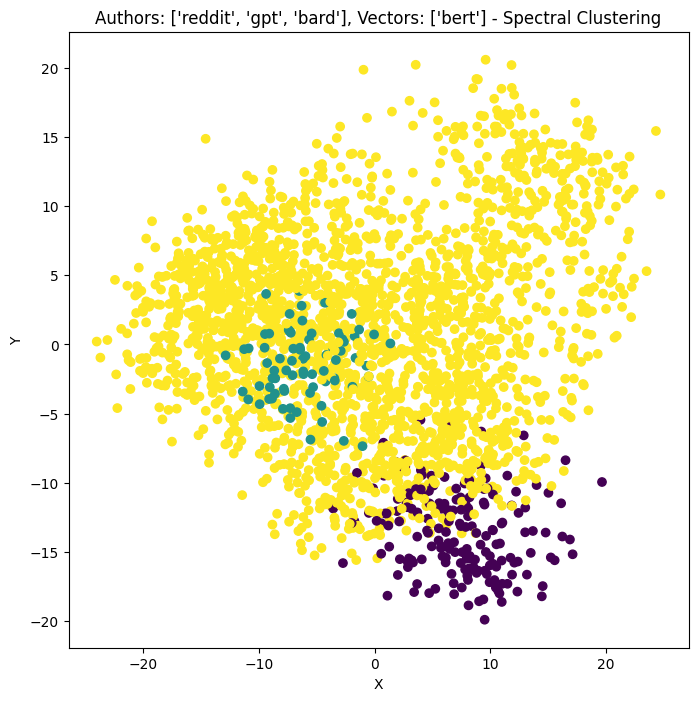

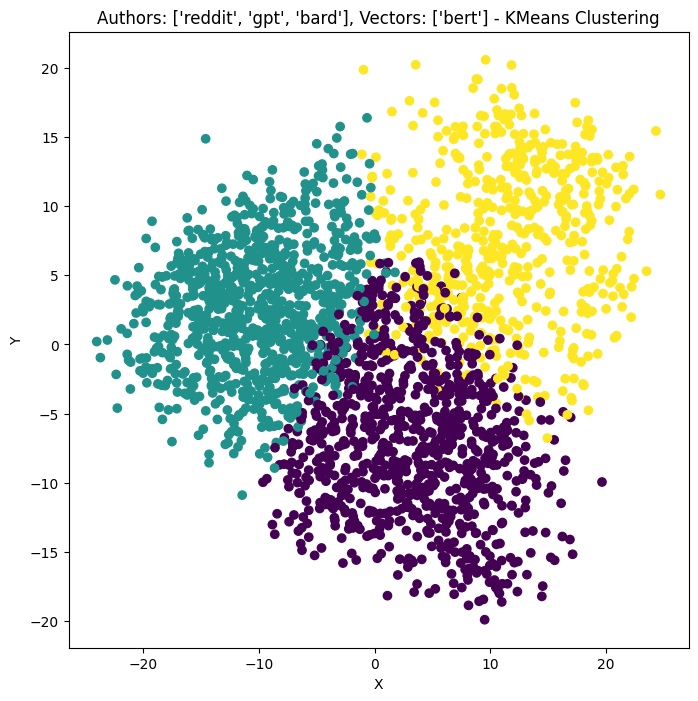

['common', 'function', 'bert'] scores:
KMeans Adjusted Rand Index: 0.42115007110924335
KMeans Rand Index: 0.7399089898568848
Spectral Clustering Adjusted Rand Index: 0.02171587649772784
Spectral Clustering Rand Index: 0.4251448520216757


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


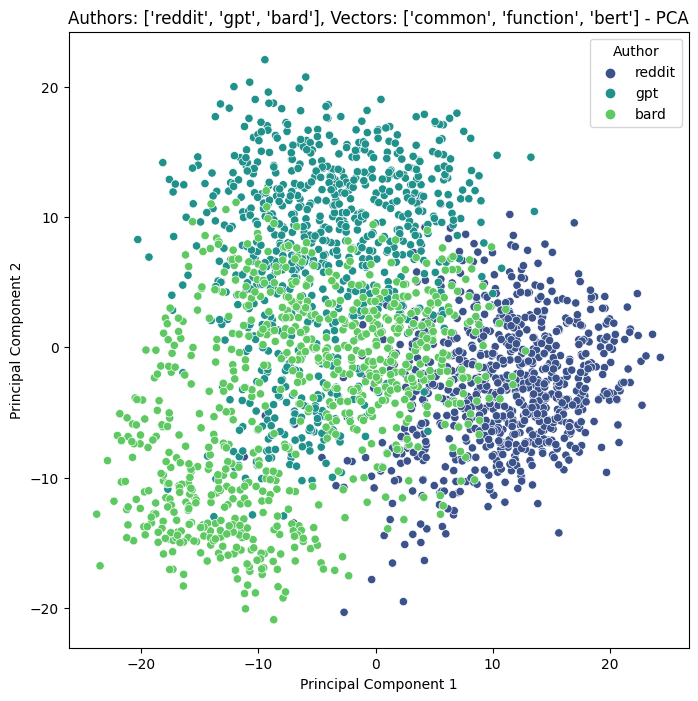

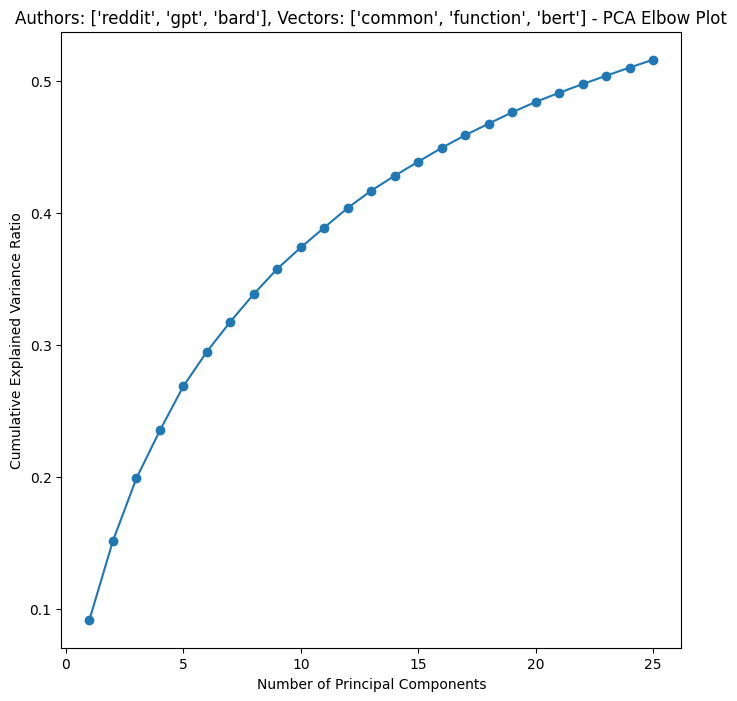

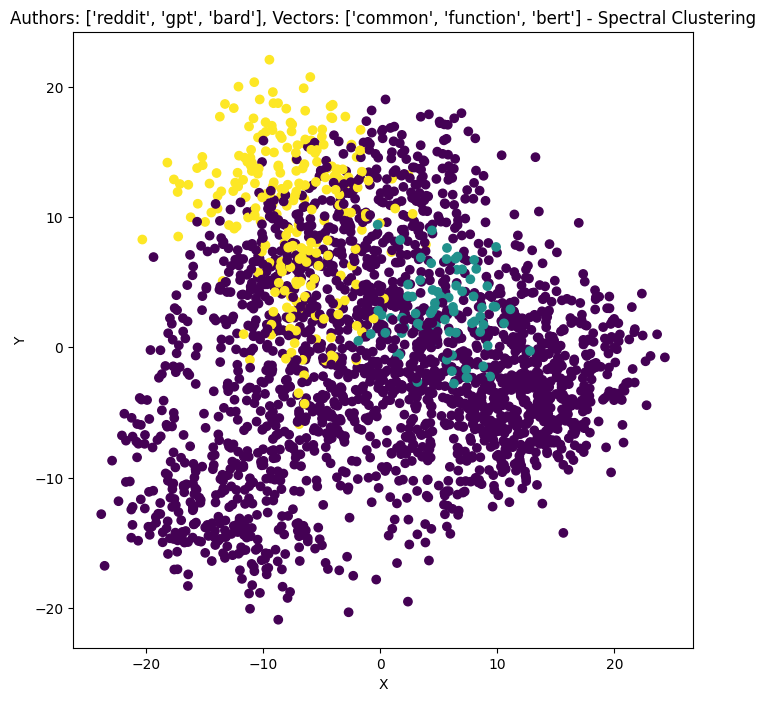

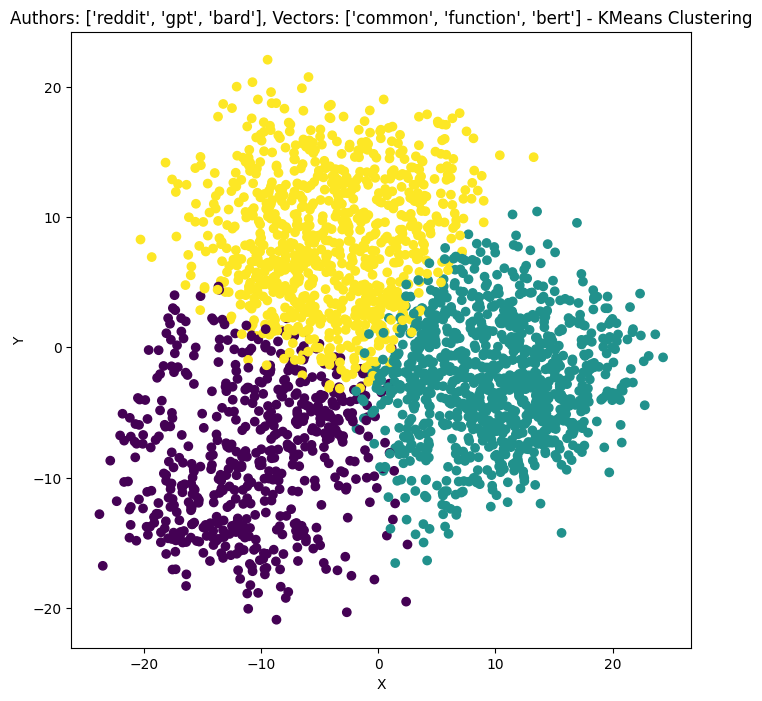

In [11]:
comp = []
for vector_names in list_of_vector_names:
    res = cluster_graph(["reddit", "gpt", "bard"], vector_names)
    comp.append(res)
results_table.append(comp)

# Reddit vs. GPT (temp 1.0) vs. Gemini

['common'] scores:
KMeans Adjusted Rand Index: 0.2828418964372126
KMeans Rand Index: 0.673652216201195
Spectral Clustering Adjusted Rand Index: 0.00873434238025085
Spectral Clustering Rand Index: 0.4201177573989162


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


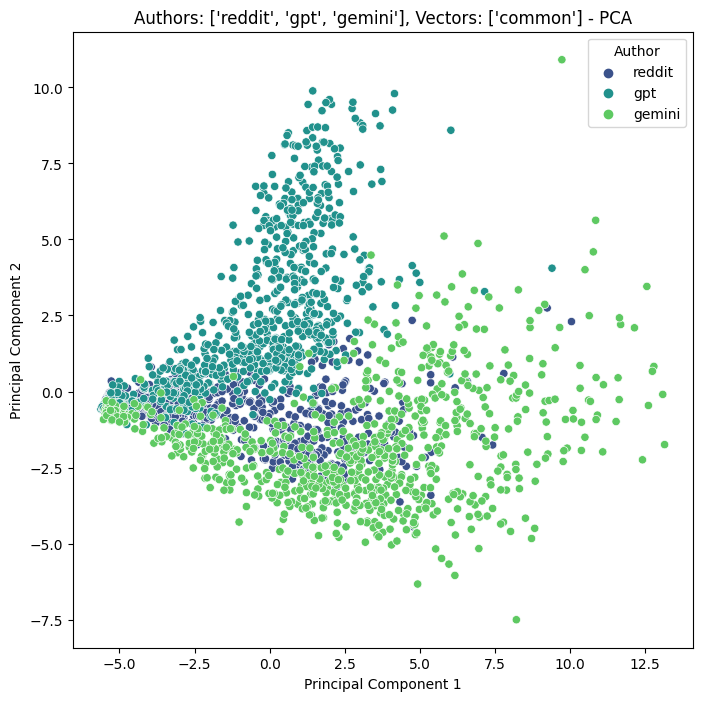

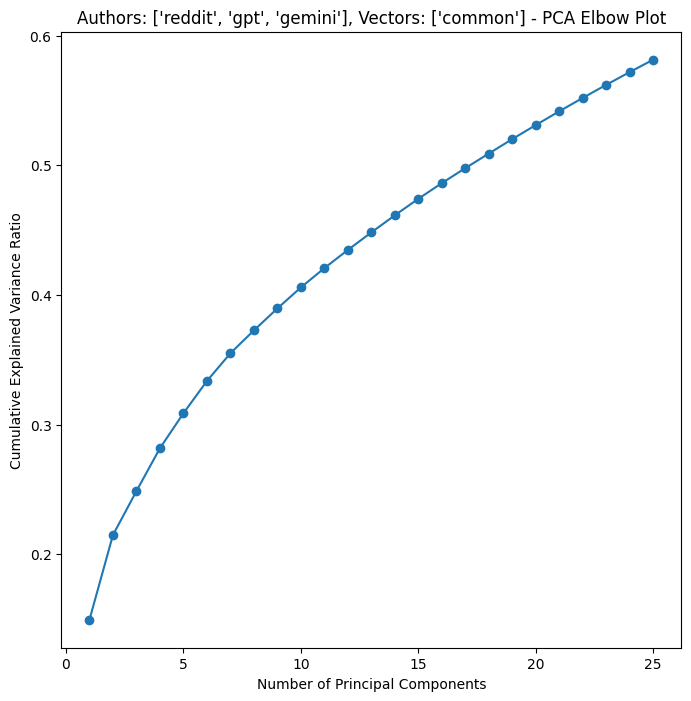

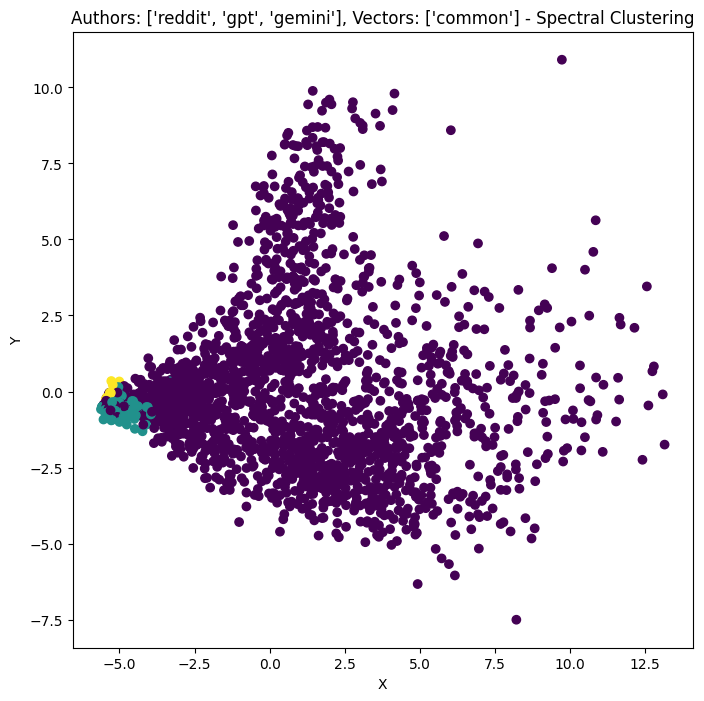

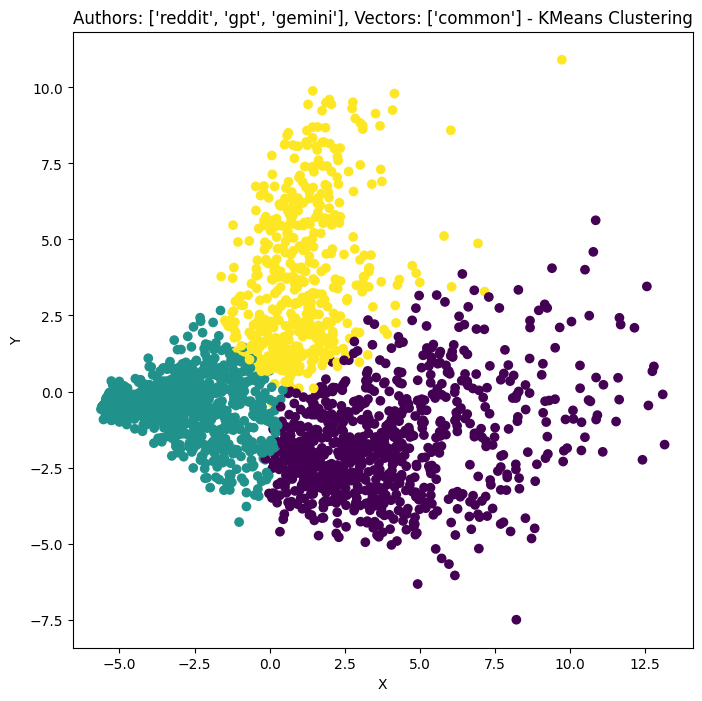

['function'] scores:
KMeans Adjusted Rand Index: 0.28771424751339975
KMeans Rand Index: 0.6773544532444074
Spectral Clustering Adjusted Rand Index: 0.017414405943736617
Spectral Clustering Rand Index: 0.4021345699597054


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


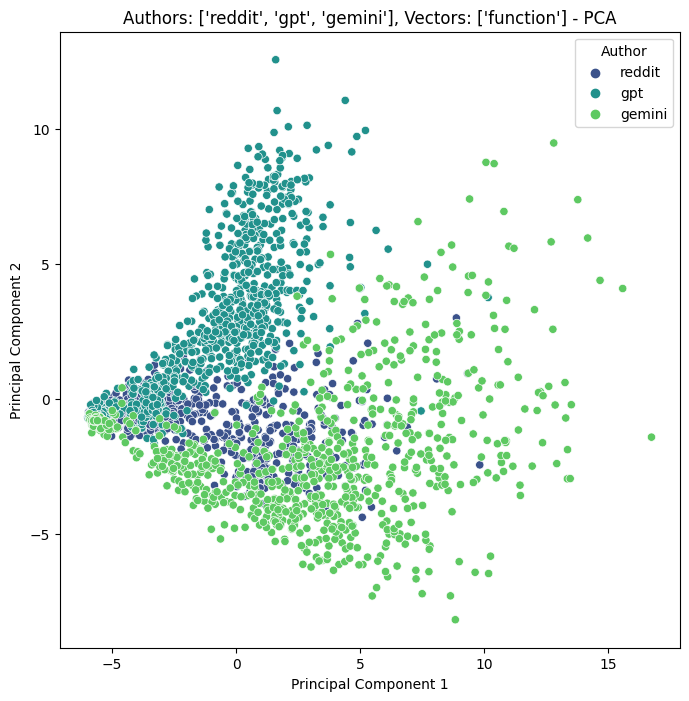

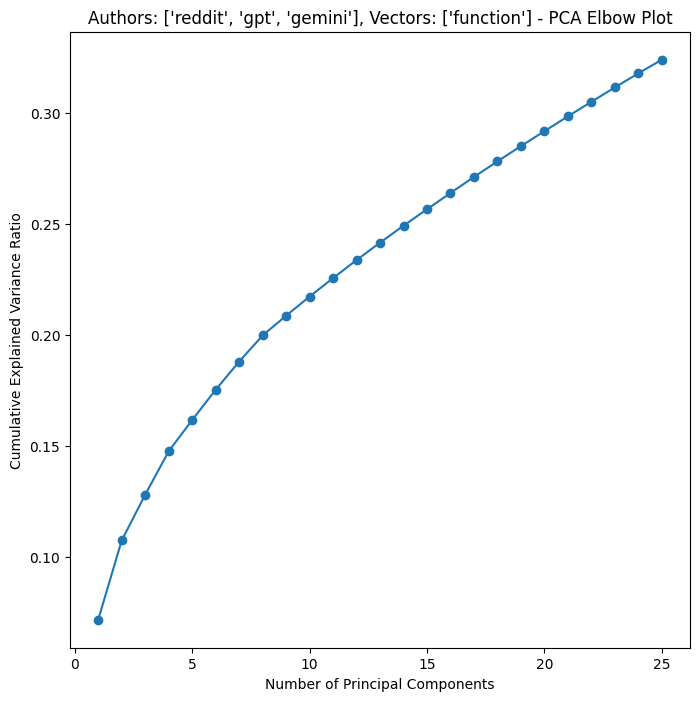

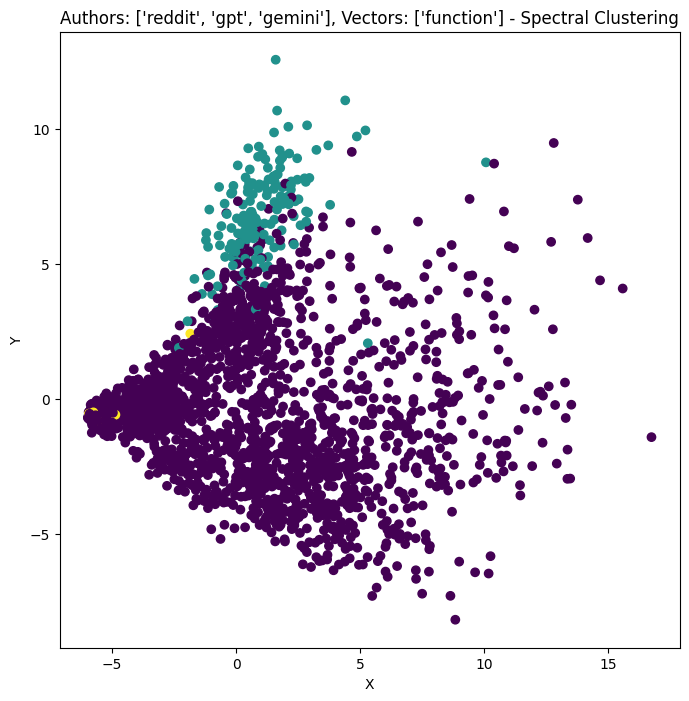

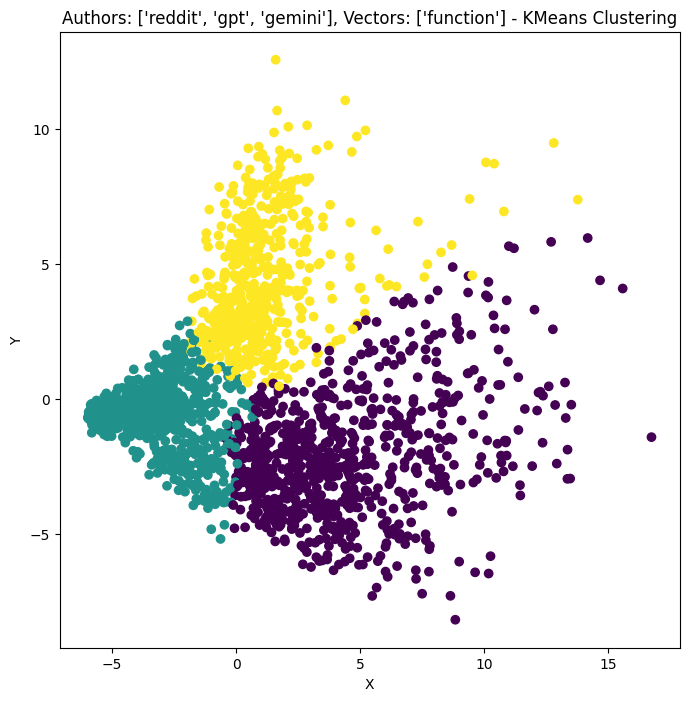

['common', 'function'] scores:
KMeans Adjusted Rand Index: 0.2929251931489403
KMeans Rand Index: 0.6791677087675421
Spectral Clustering Adjusted Rand Index: 0.0017383644006484856
Spectral Clustering Rand Index: 0.35454877032096704


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


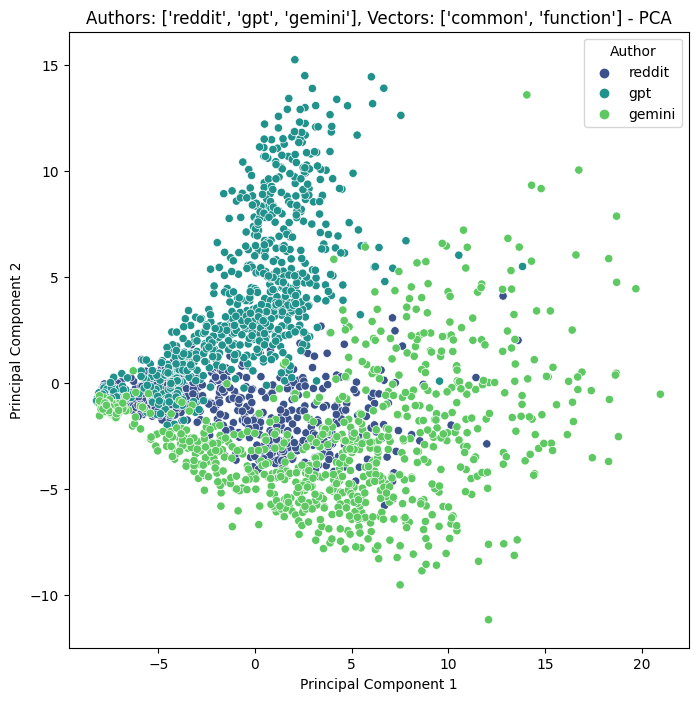

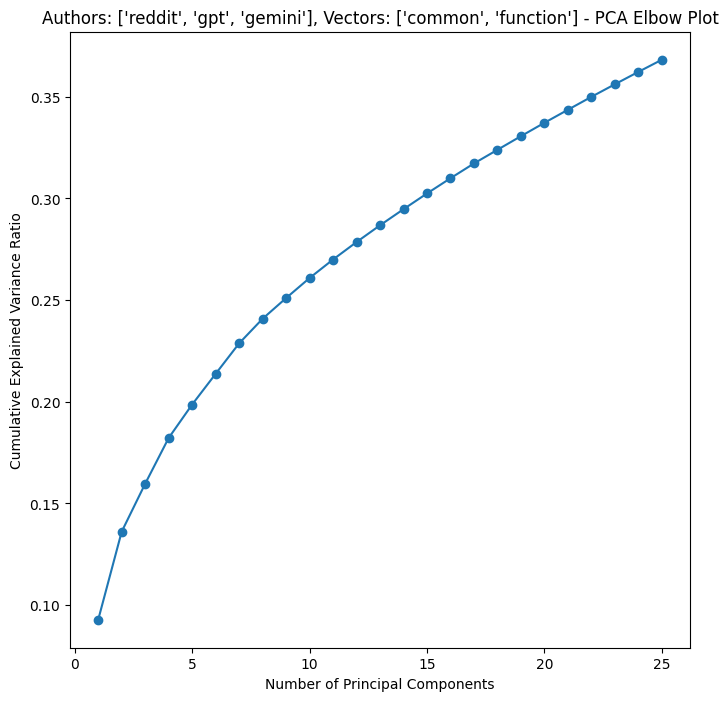

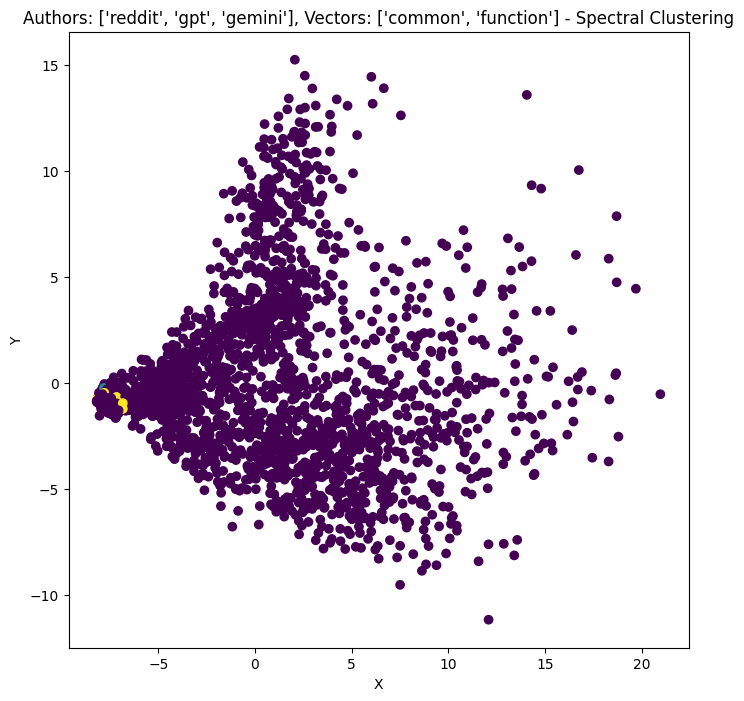

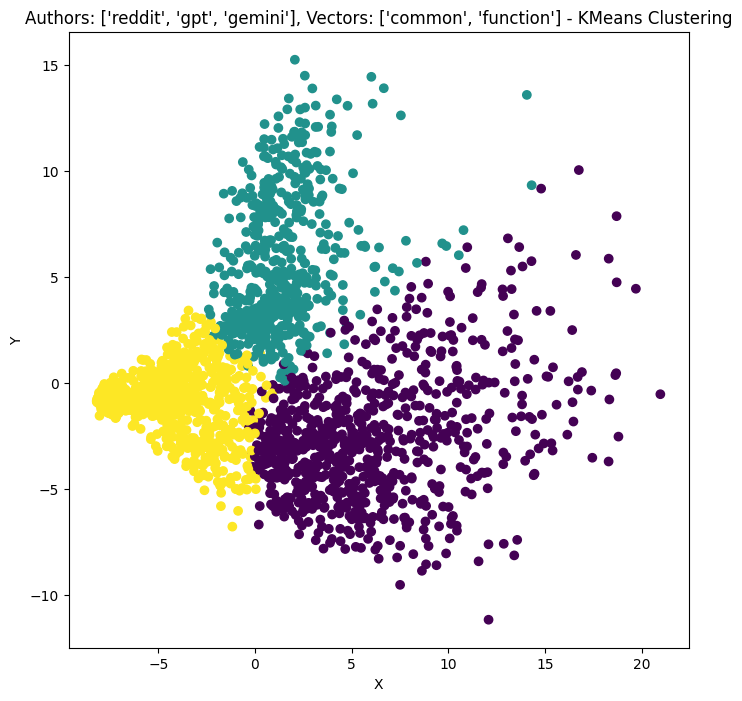

['bert'] scores:
KMeans Adjusted Rand Index: 0.6487325413690197
KMeans Rand Index: 0.8433079755453661
Spectral Clustering Adjusted Rand Index: 0.037376562327941926
Spectral Clustering Rand Index: 0.45642038349312214


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


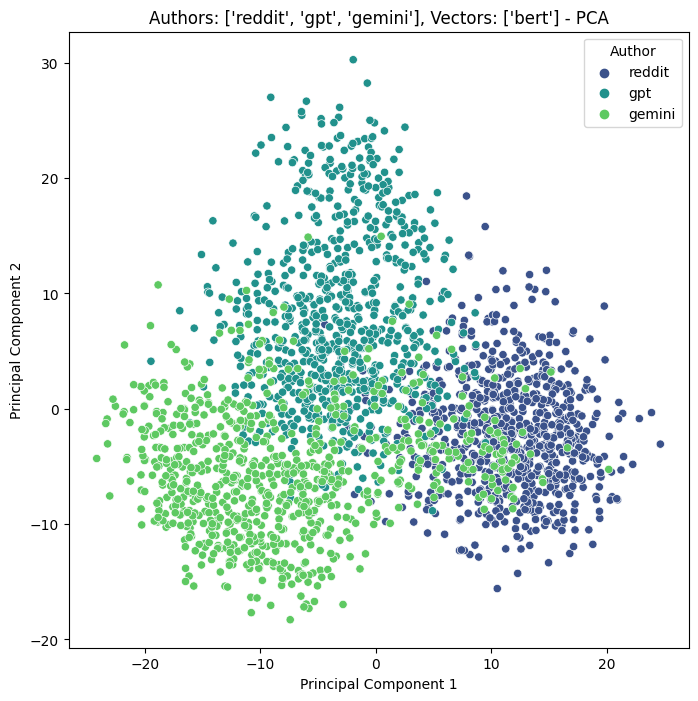

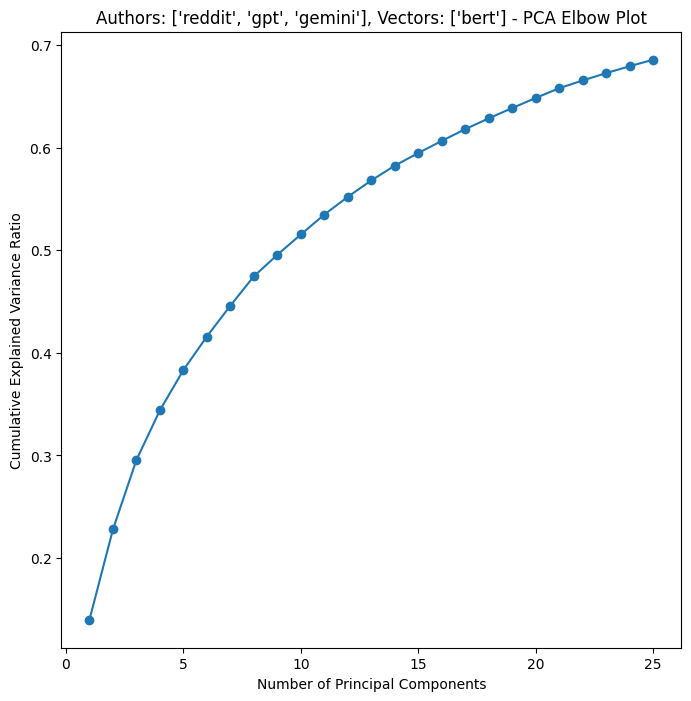

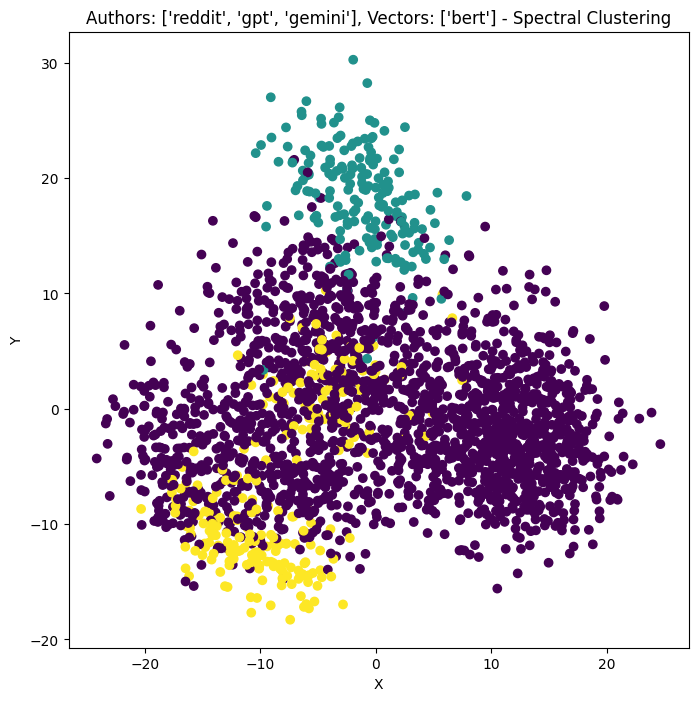

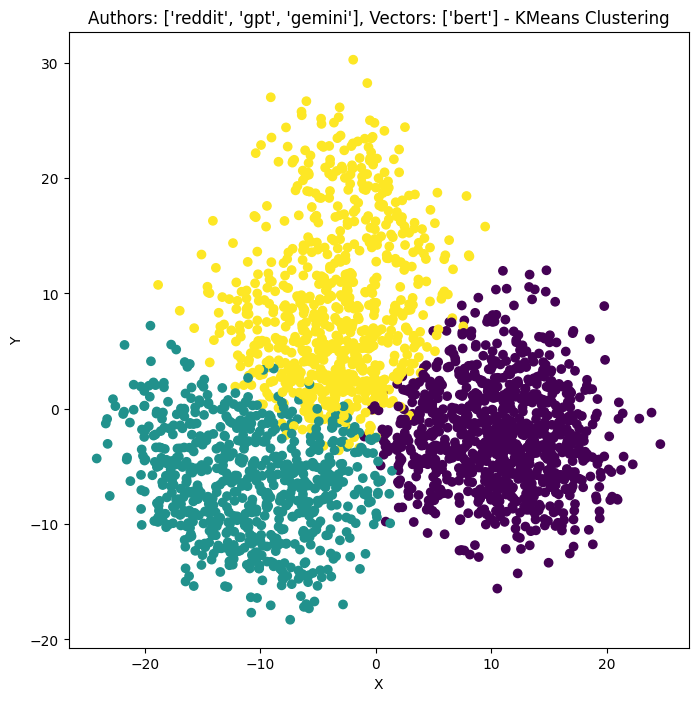

['common', 'function', 'bert'] scores:
KMeans Adjusted Rand Index: 0.7706853506172247
KMeans Rand Index: 0.89782374600528
Spectral Clustering Adjusted Rand Index: 0.032308583542840365
Spectral Clustering Rand Index: 0.4347287064054467


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


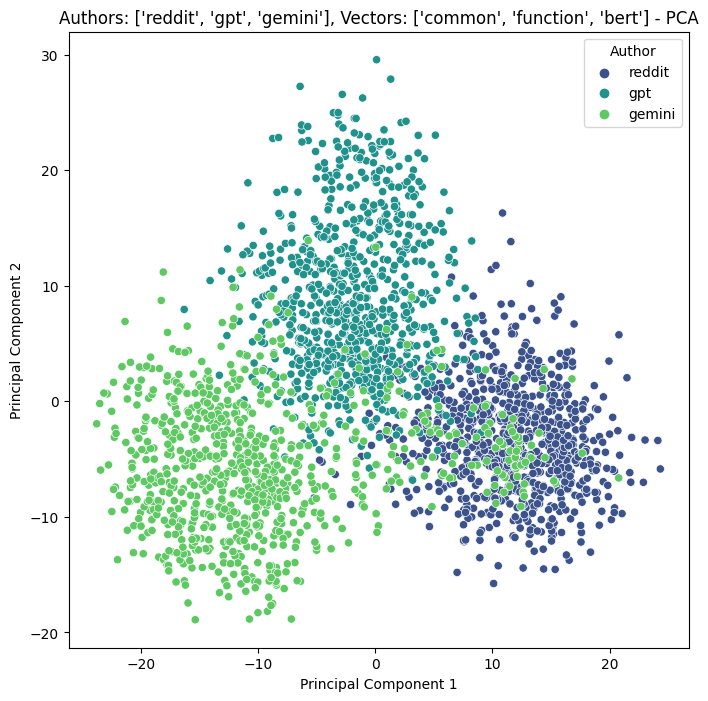

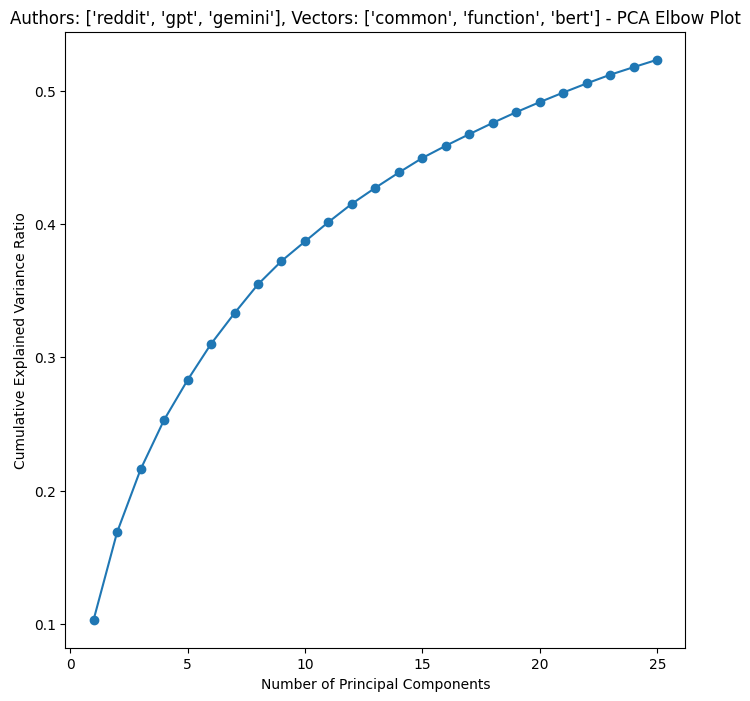

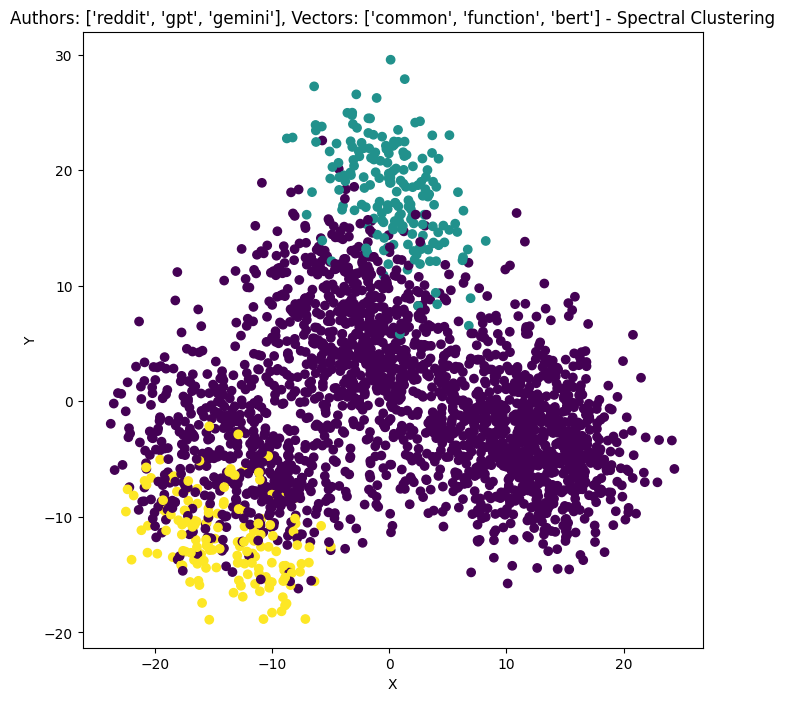

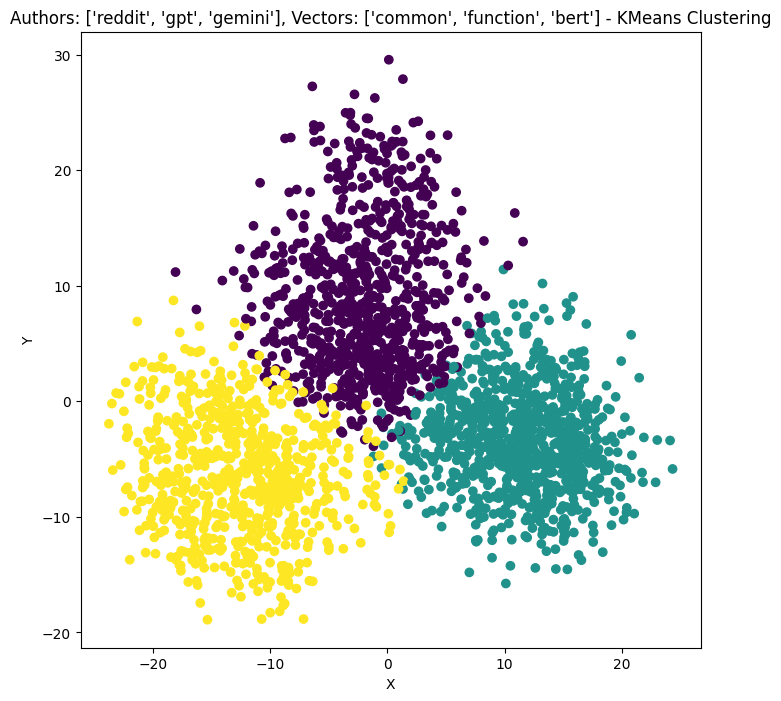

In [12]:
comp = []
for vector_names in list_of_vector_names:
    res = cluster_graph(["reddit", "gpt", "gemini"], vector_names)
    comp.append(res)
results_table.append(comp)

# Reddit vs. Bard vs. Gemini

['common'] scores:
KMeans Adjusted Rand Index: 0.1805284172284321
KMeans Rand Index: 0.6064578991246352
Spectral Clustering Adjusted Rand Index: 0.019317575172783933
Spectral Clustering Rand Index: 0.41050333472280115


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


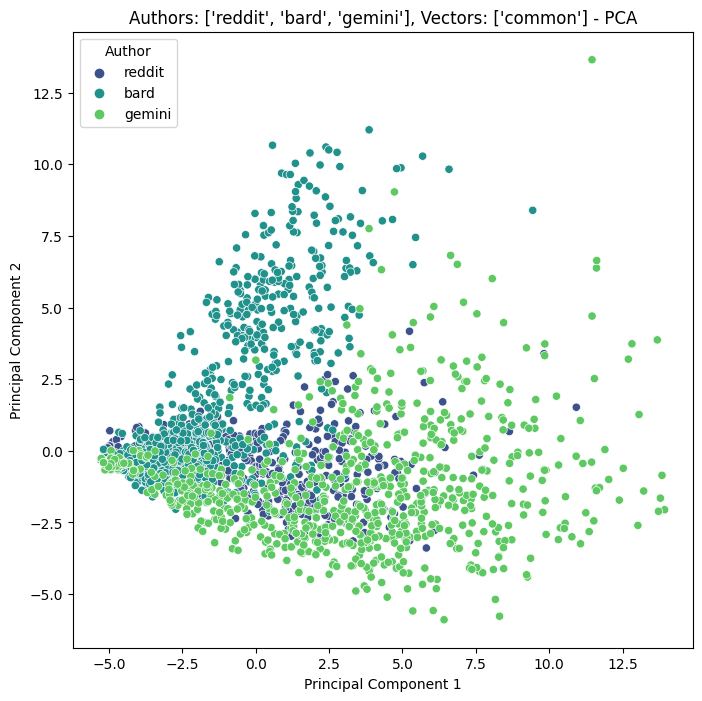

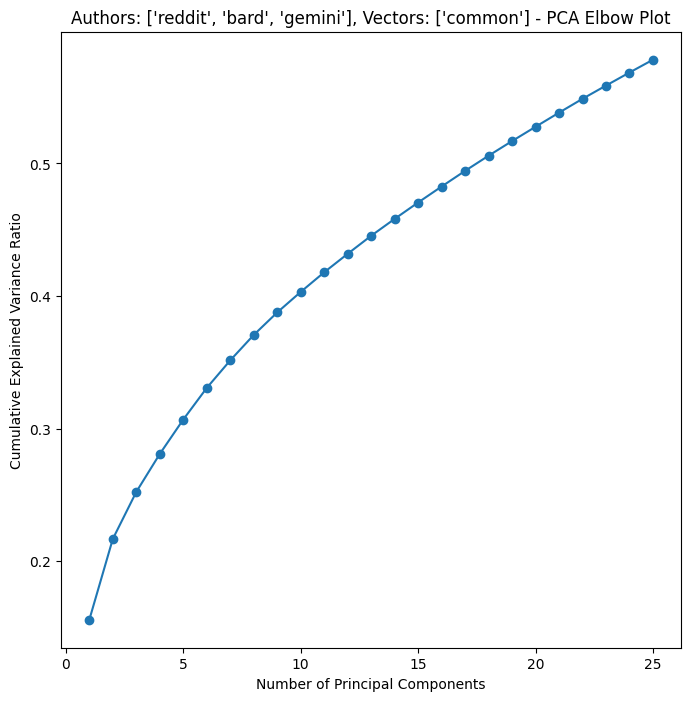

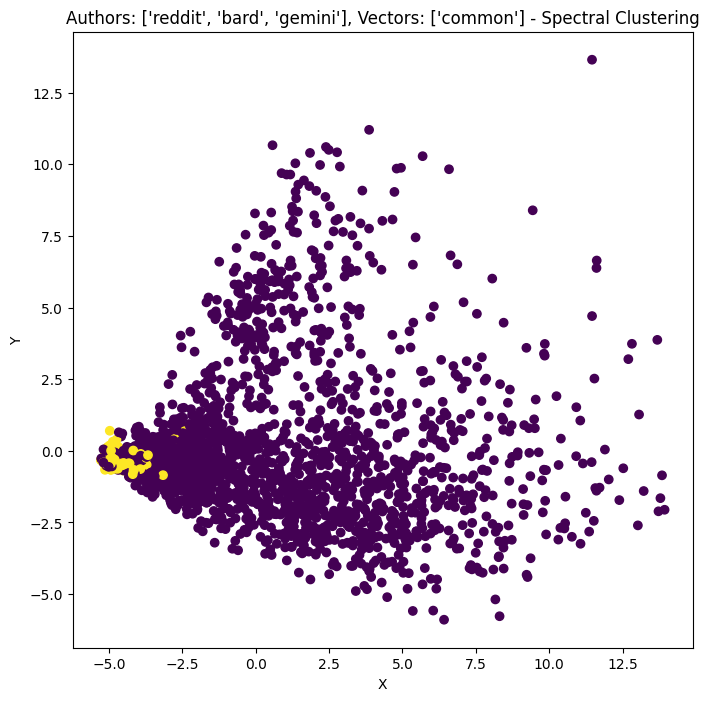

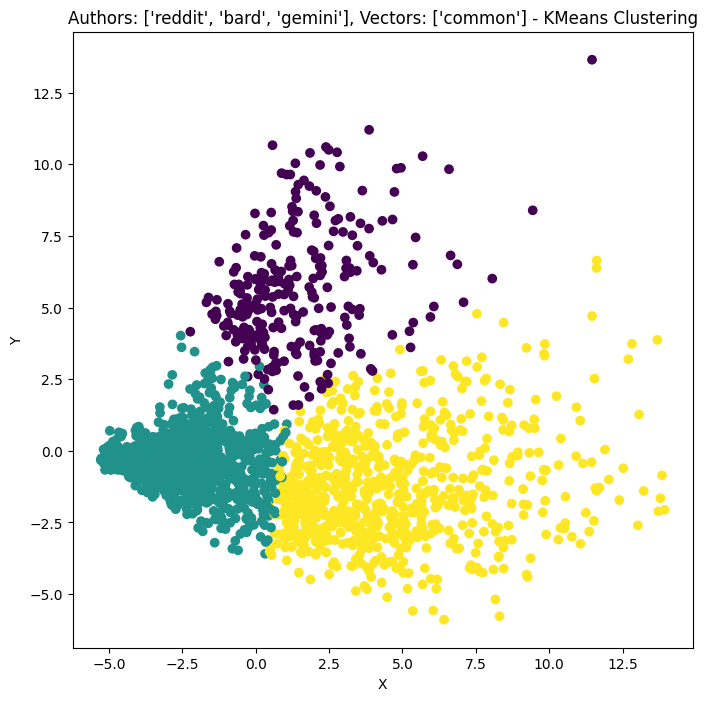

['function'] scores:
KMeans Adjusted Rand Index: 0.16737029948226
KMeans Rand Index: 0.6106825760733638
Spectral Clustering Adjusted Rand Index: 0.001214806065997158
Spectral Clustering Rand Index: 0.3515343198554953


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


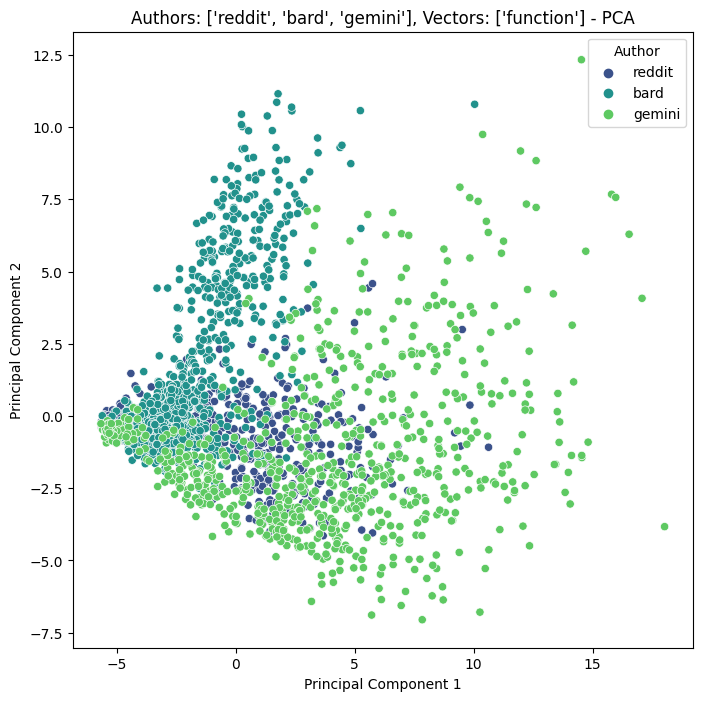

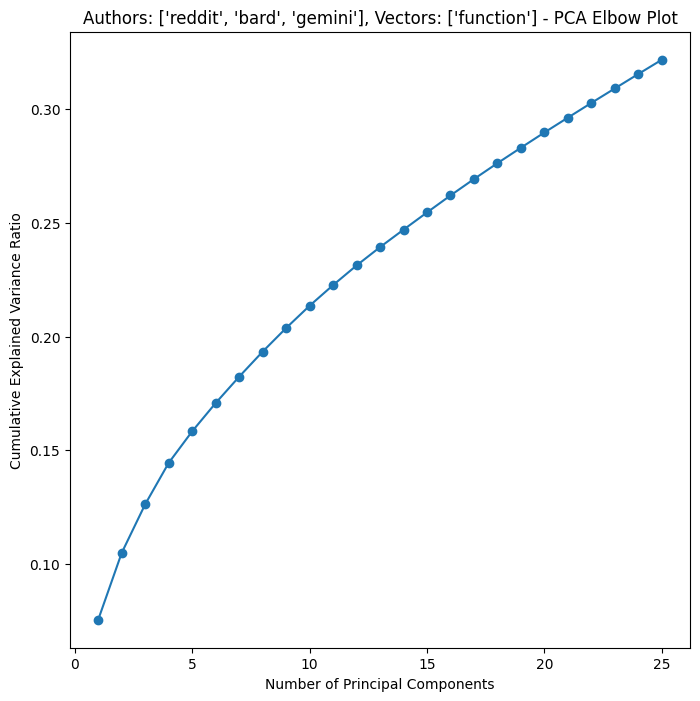

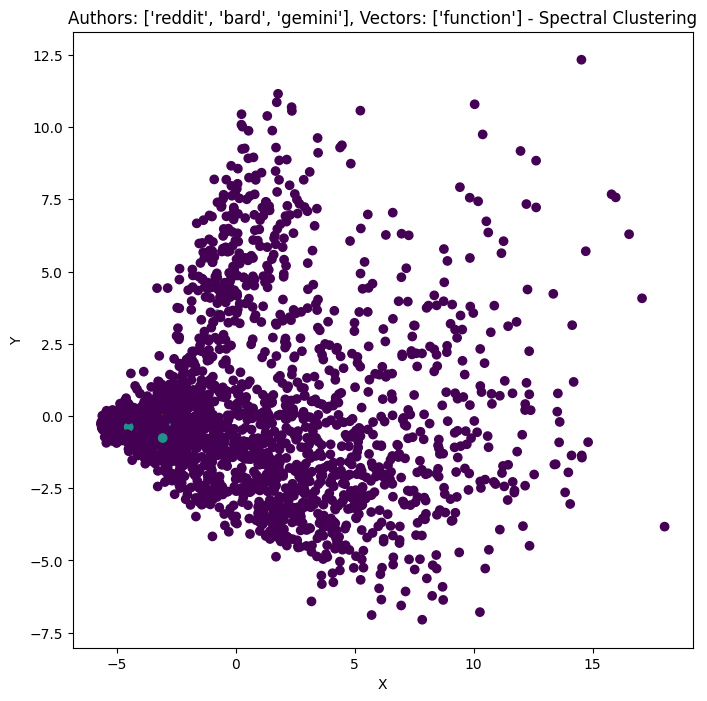

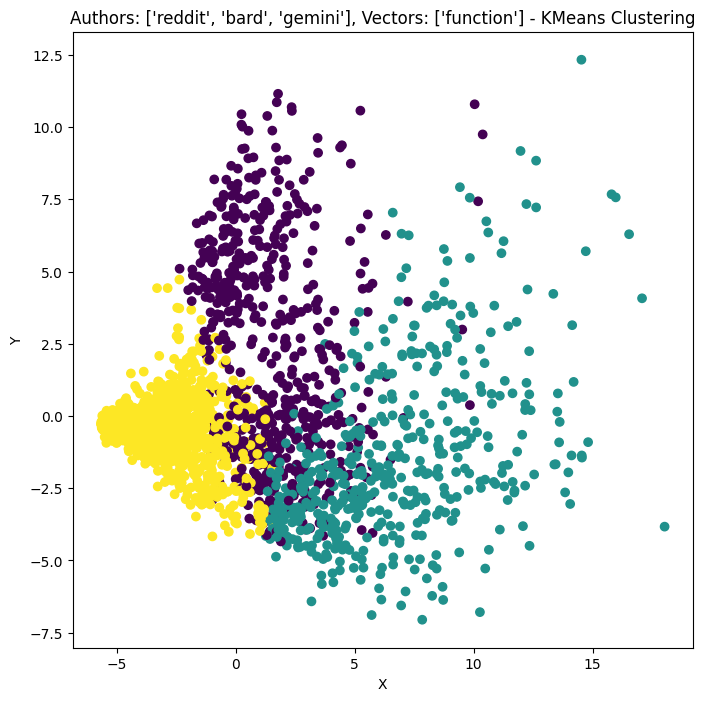

['common', 'function'] scores:
KMeans Adjusted Rand Index: 0.1840867629725621
KMeans Rand Index: 0.6098718215923301
Spectral Clustering Adjusted Rand Index: 0.0017257535322165985
Spectral Clustering Rand Index: 0.3537467000138947


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


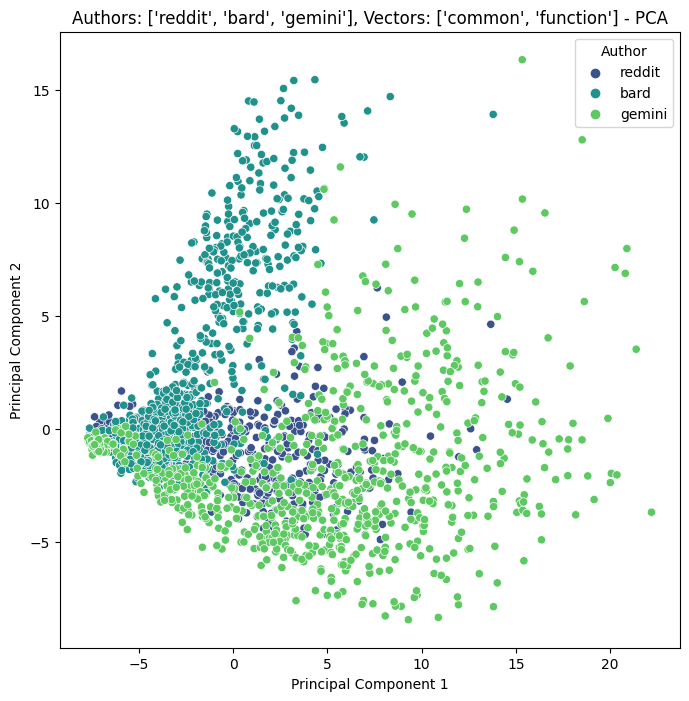

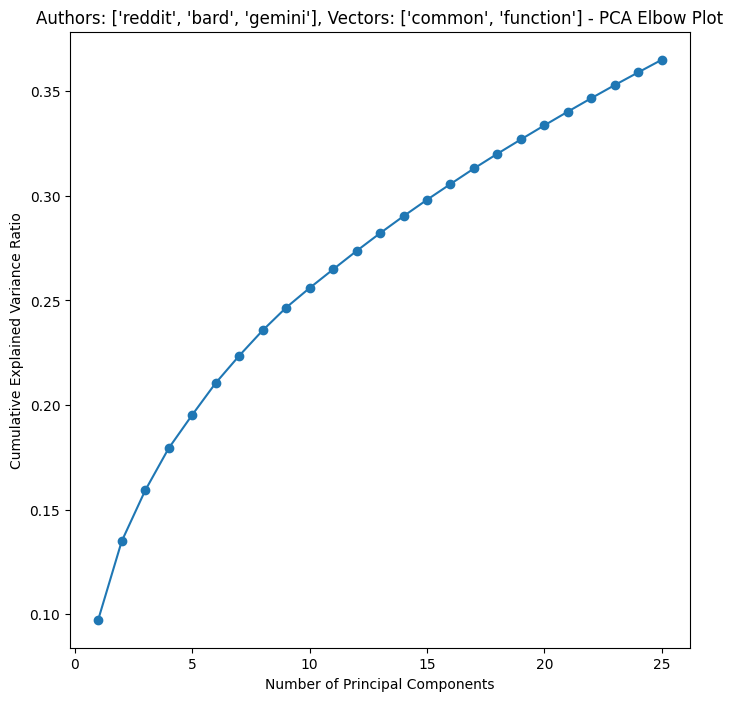

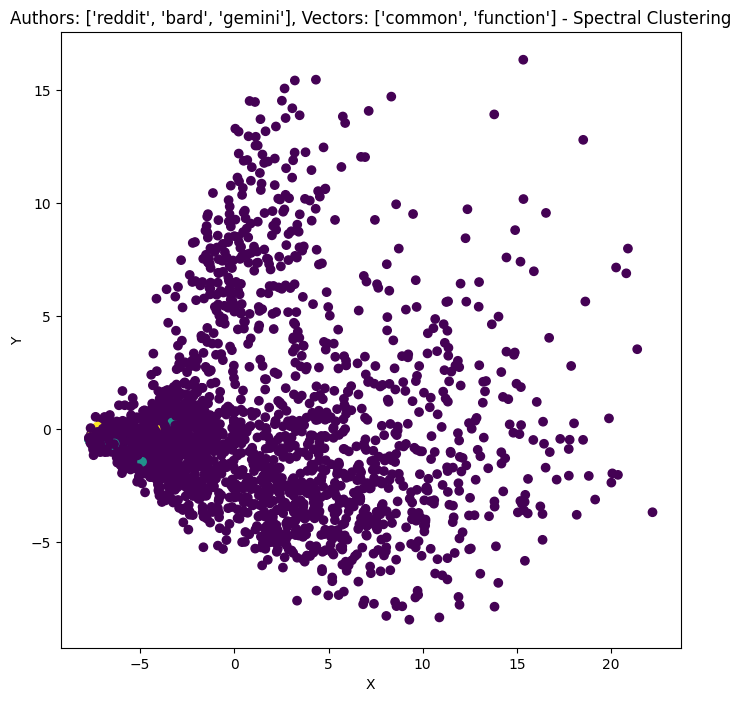

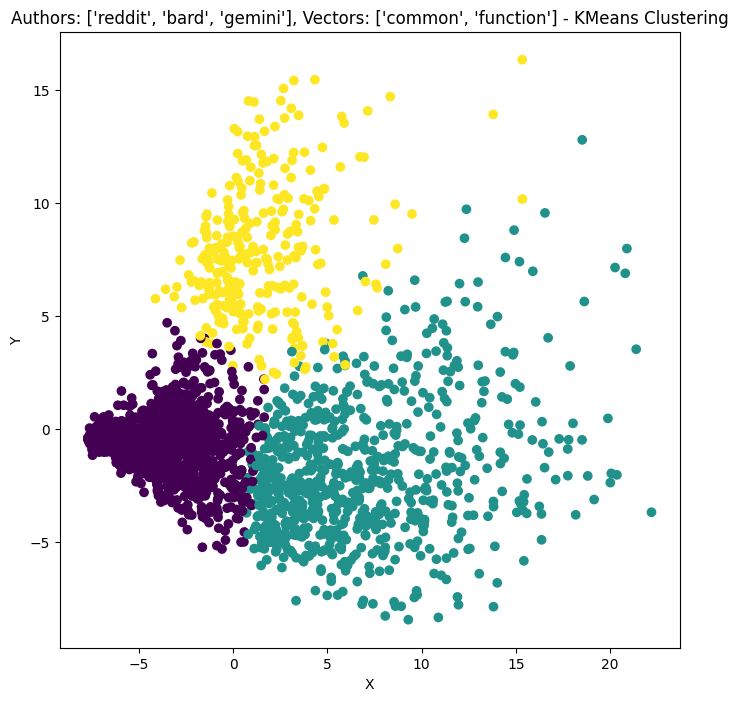

['bert'] scores:
KMeans Adjusted Rand Index: 0.5405948596666964
KMeans Rand Index: 0.7912876893149924
Spectral Clustering Adjusted Rand Index: 0.4213460304531016
Spectral Clustering Rand Index: 0.702970334861748


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


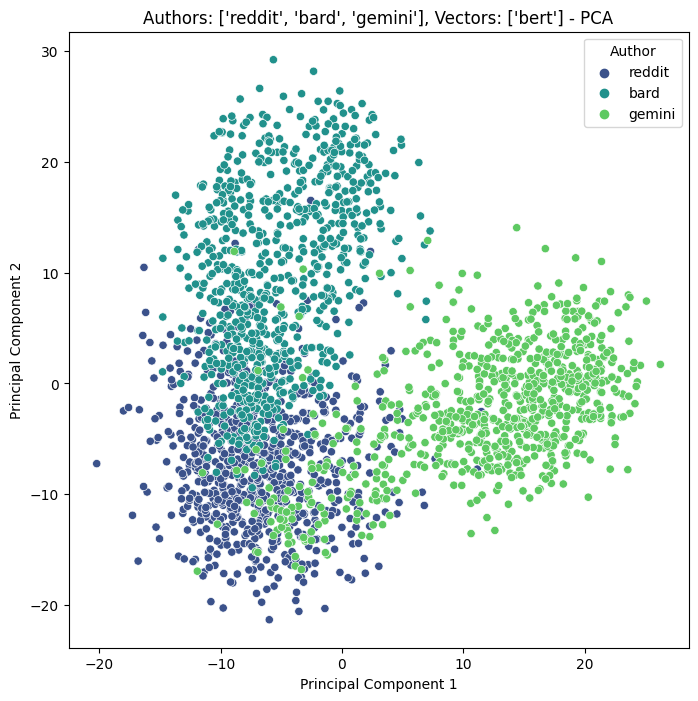

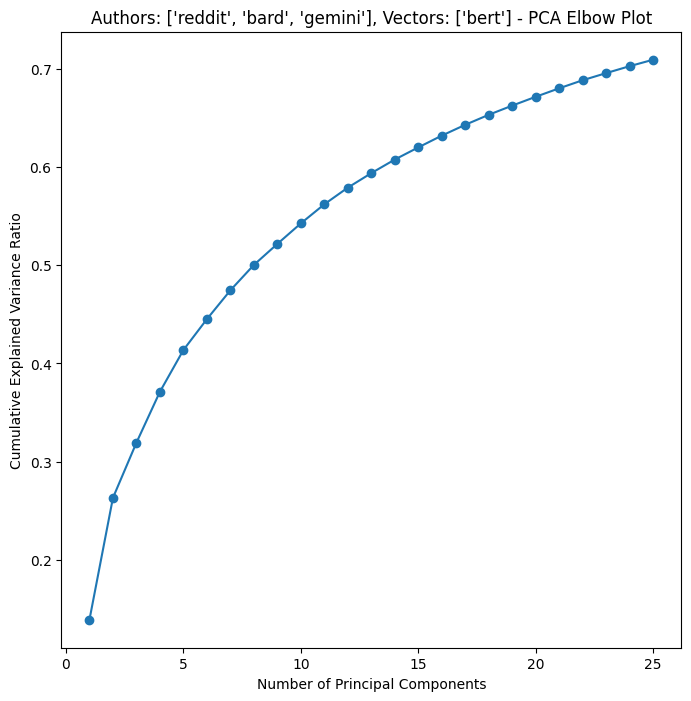

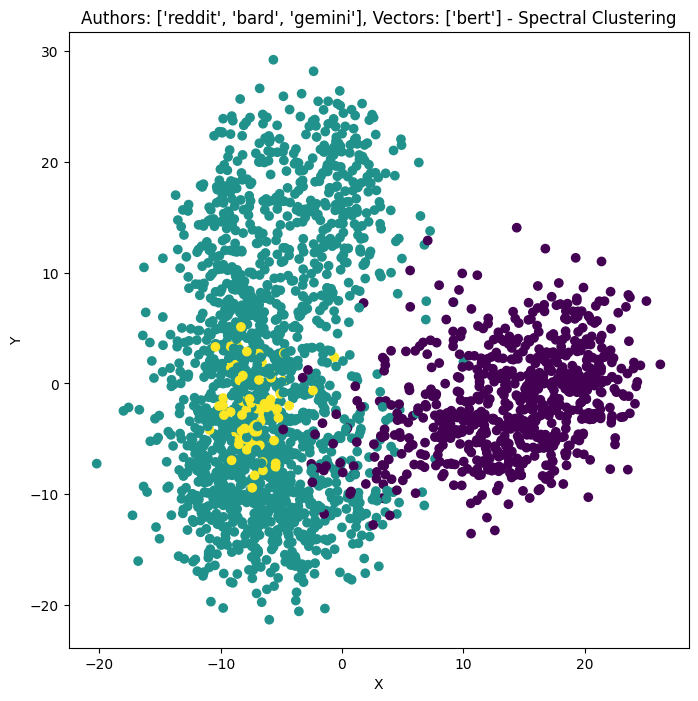

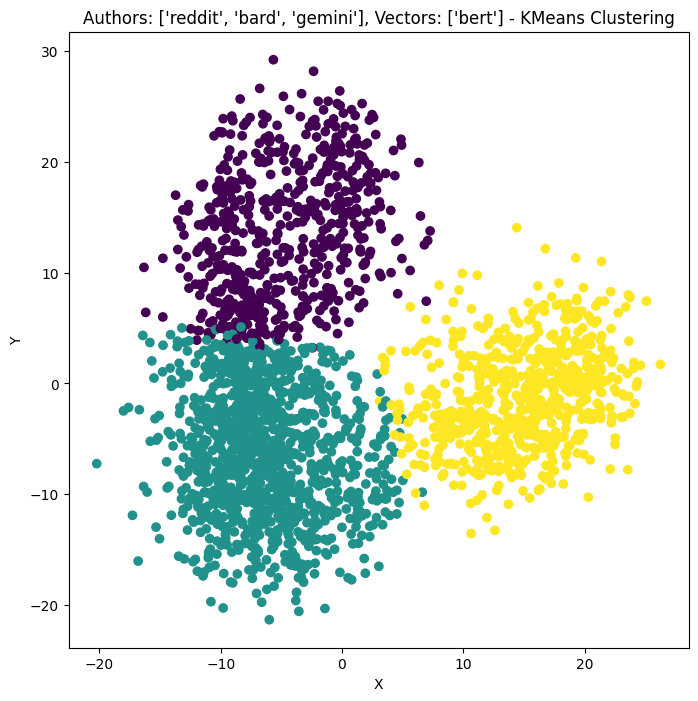

['common', 'function', 'bert'] scores:
KMeans Adjusted Rand Index: 0.5807200565465956
KMeans Rand Index: 0.8100482840072253
Spectral Clustering Adjusted Rand Index: 0.3657705109984904
Spectral Clustering Rand Index: 0.670975059052383


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


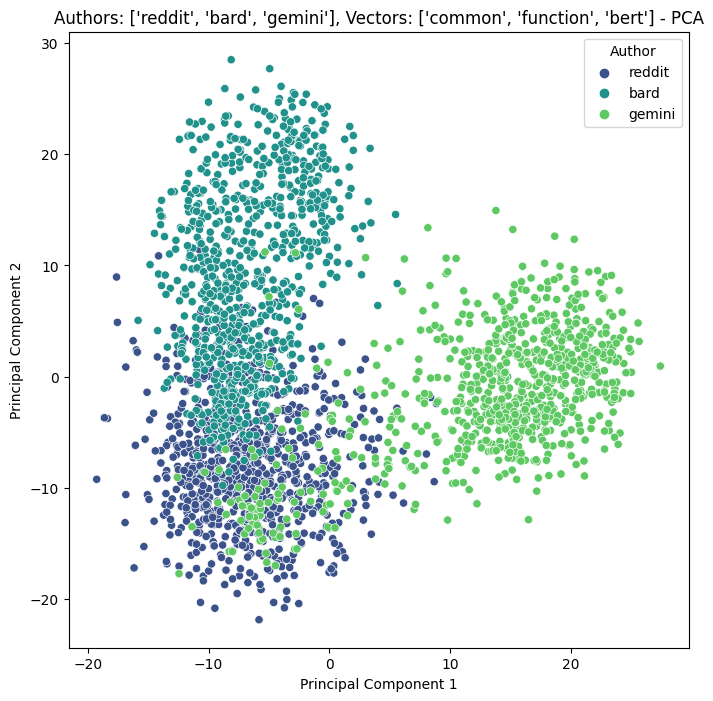

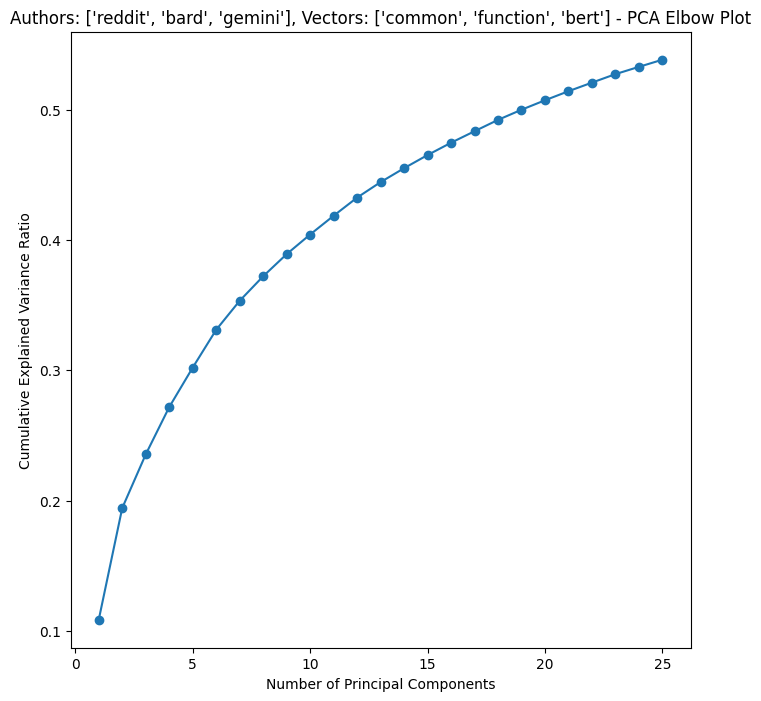

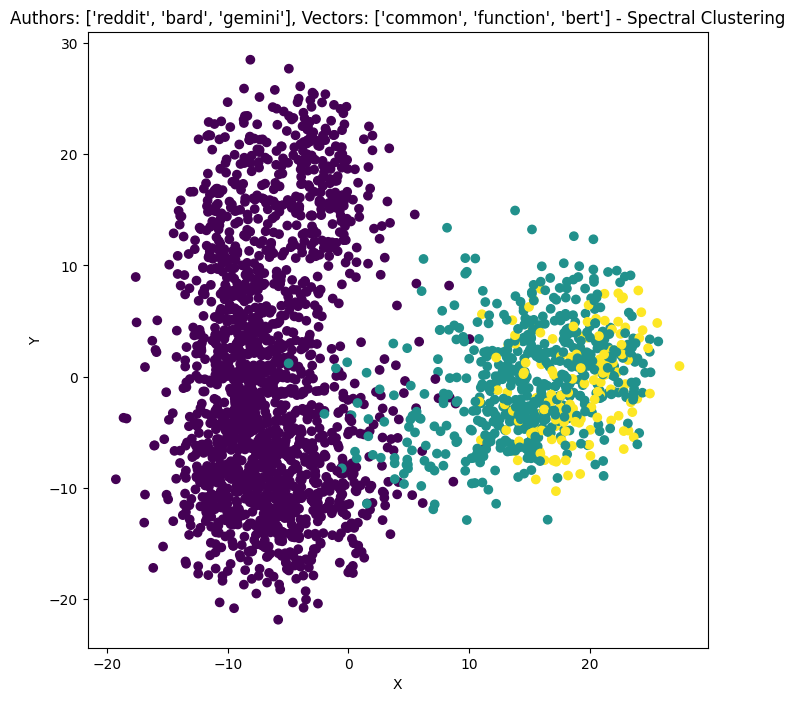

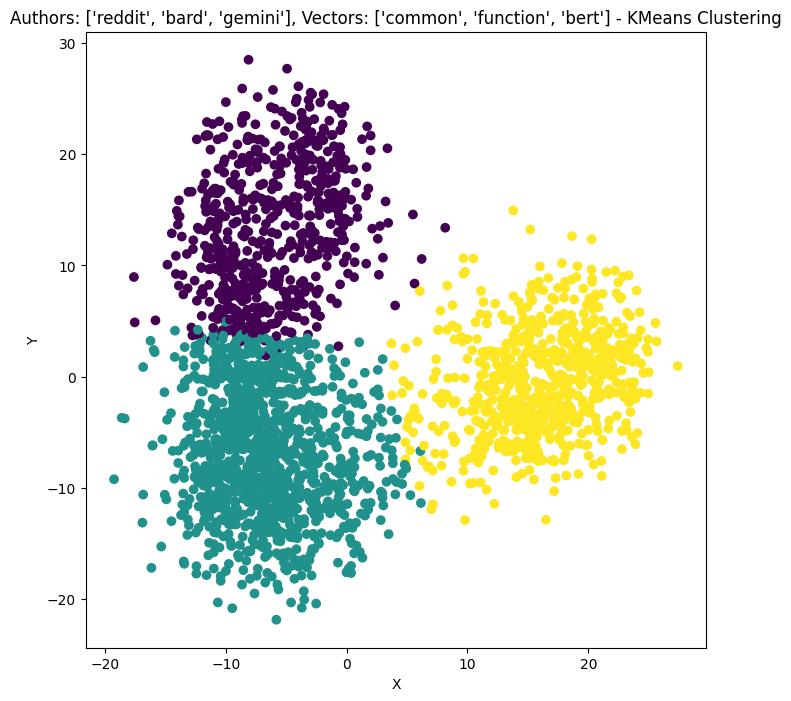

In [13]:
comp = []
for vector_names in list_of_vector_names:
    res = cluster_graph(["reddit", "bard", "gemini"], vector_names)
    comp.append(res)
results_table.append(comp)

# GPT (temp 1.0) vs. Bard vs. Gemini

['common'] scores:
KMeans Adjusted Rand Index: 0.2536592313146016
KMeans Rand Index: 0.6608493122134222
Spectral Clustering Adjusted Rand Index: 0.3126954481546756
Spectral Clustering Rand Index: 0.6527219674864527


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


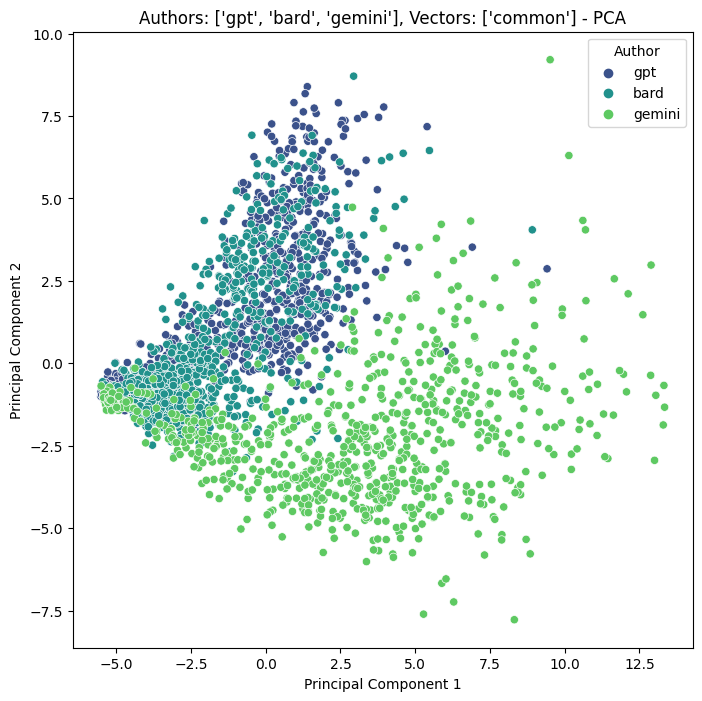

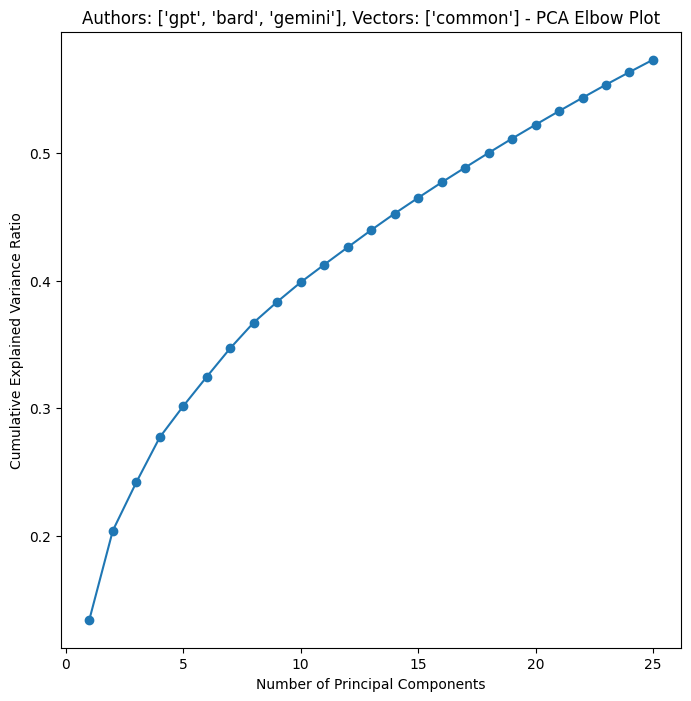

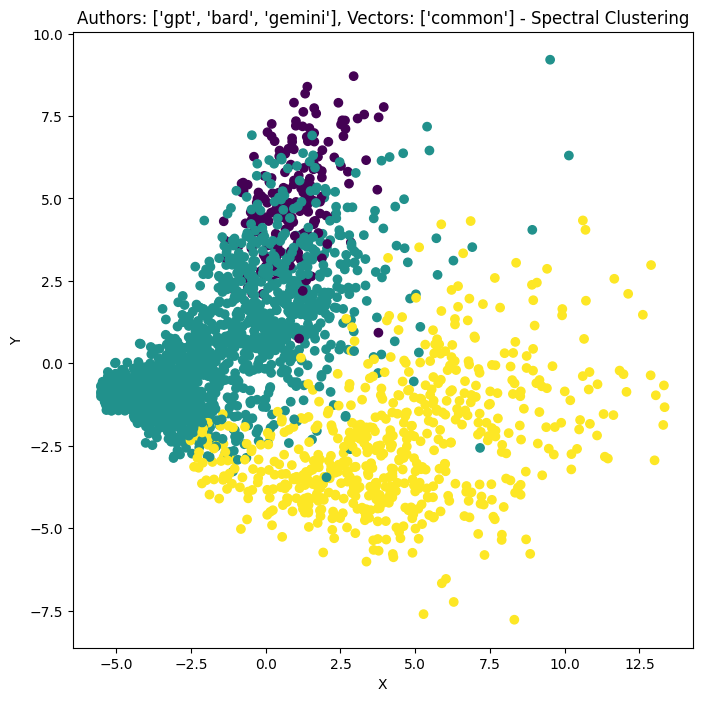

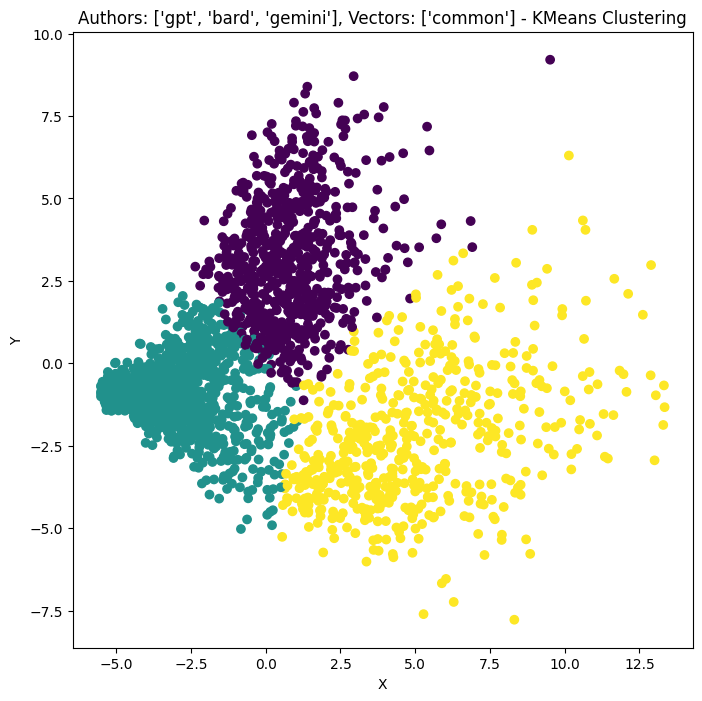

['function'] scores:
KMeans Adjusted Rand Index: 0.28774692093256493
KMeans Rand Index: 0.6776309573433374
Spectral Clustering Adjusted Rand Index: 0.06249698270700463
Spectral Clustering Rand Index: 0.48600632207864386


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


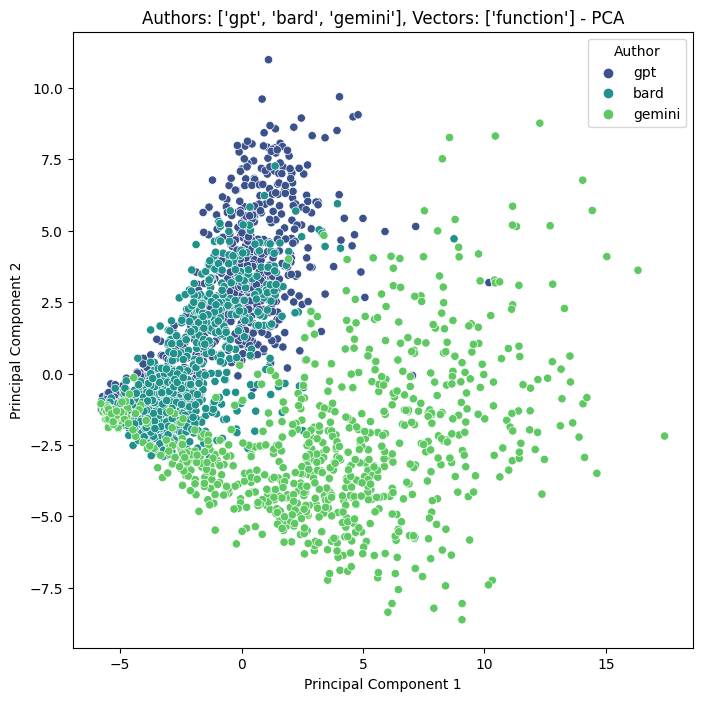

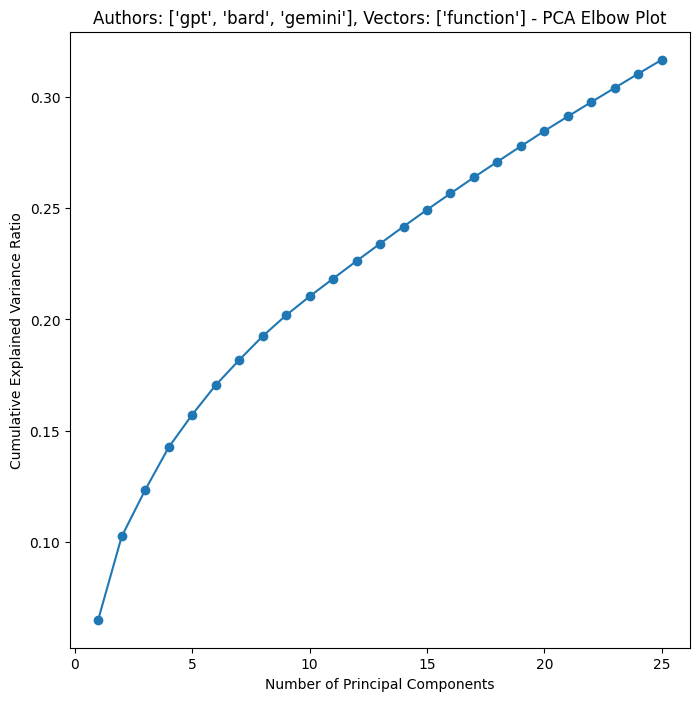

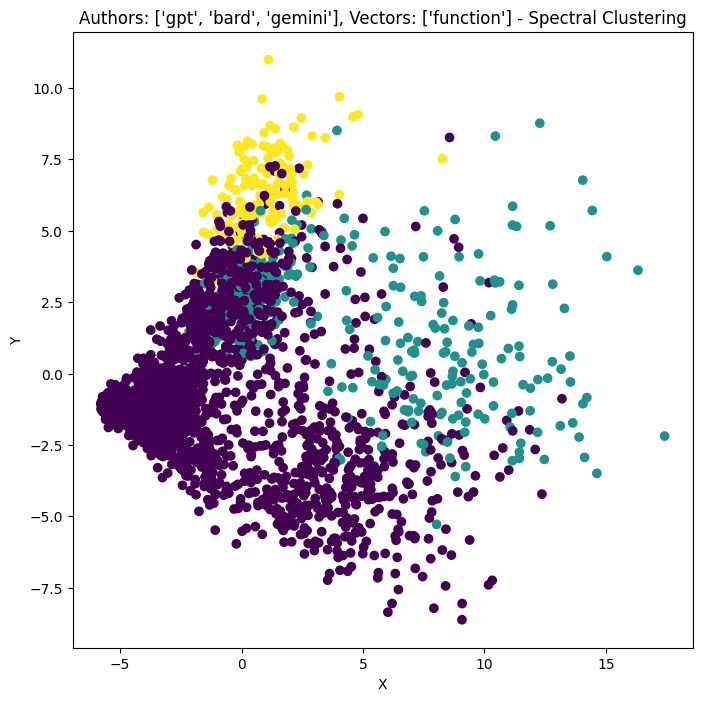

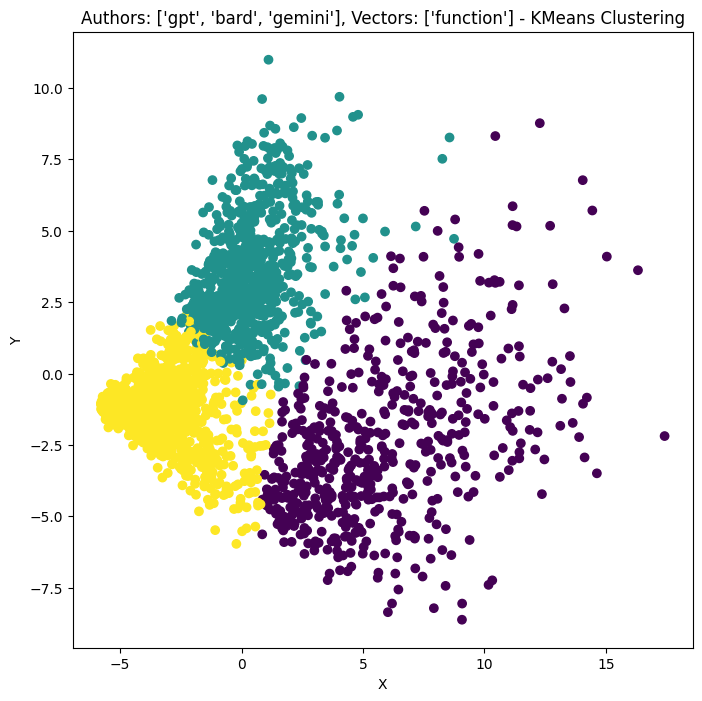

['common', 'function'] scores:
KMeans Adjusted Rand Index: 0.27612532224444625
KMeans Rand Index: 0.6725482840072252
Spectral Clustering Adjusted Rand Index: 0.06649414268901822
Spectral Clustering Rand Index: 0.49330380714186467


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


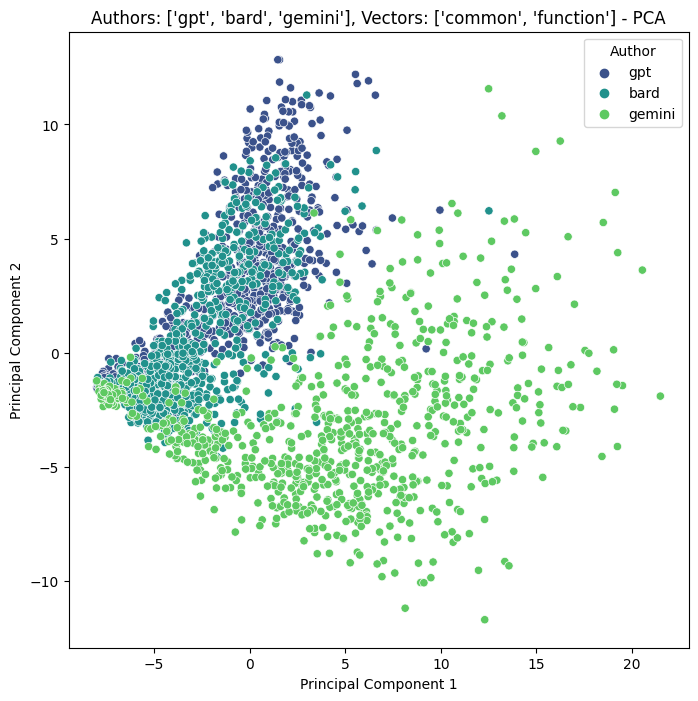

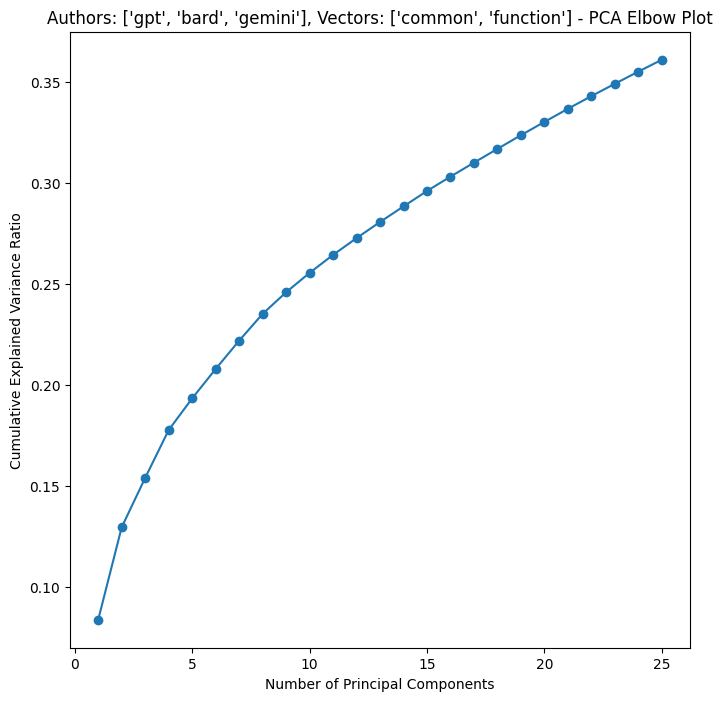

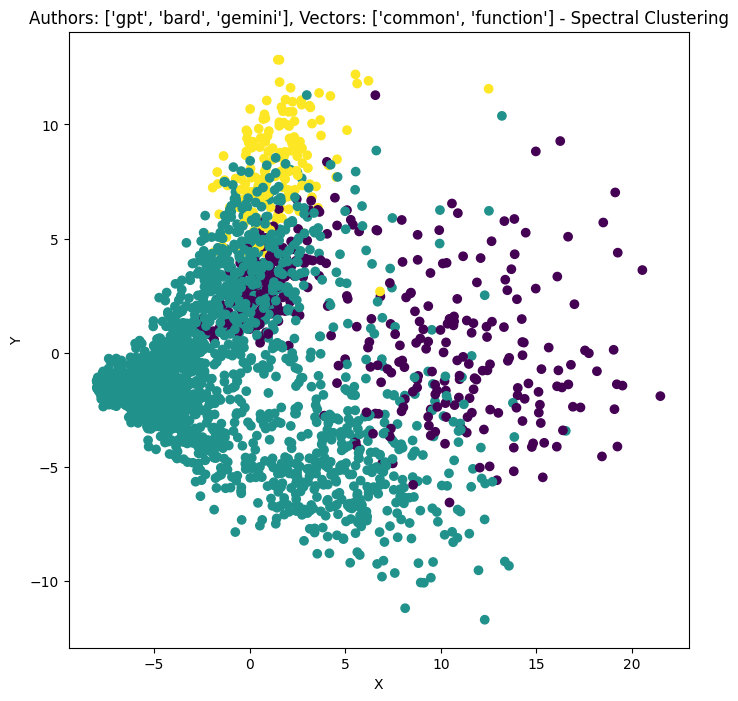

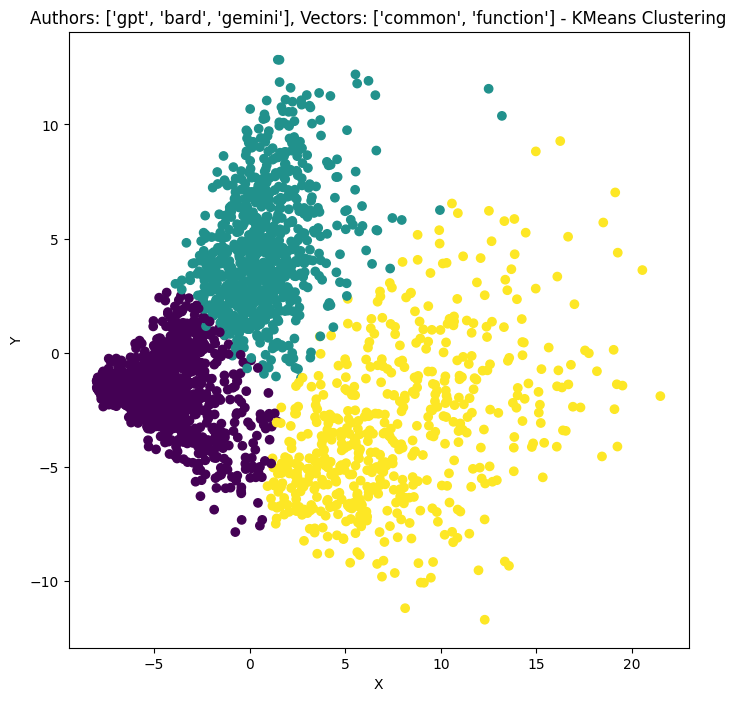

['bert'] scores:
KMeans Adjusted Rand Index: 0.27976805157888845
KMeans Rand Index: 0.6786393636237321
Spectral Clustering Adjusted Rand Index: 0.019400516096120975
Spectral Clustering Rand Index: 0.46224538001945253


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


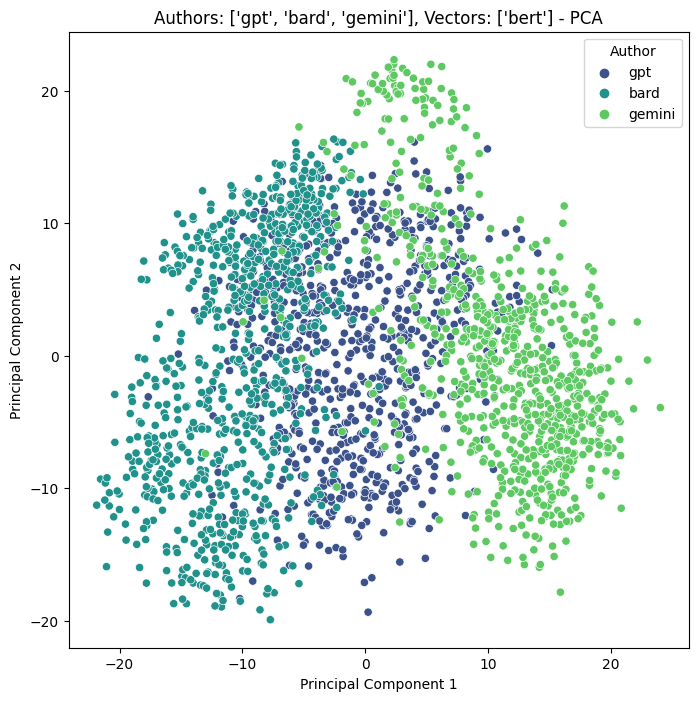

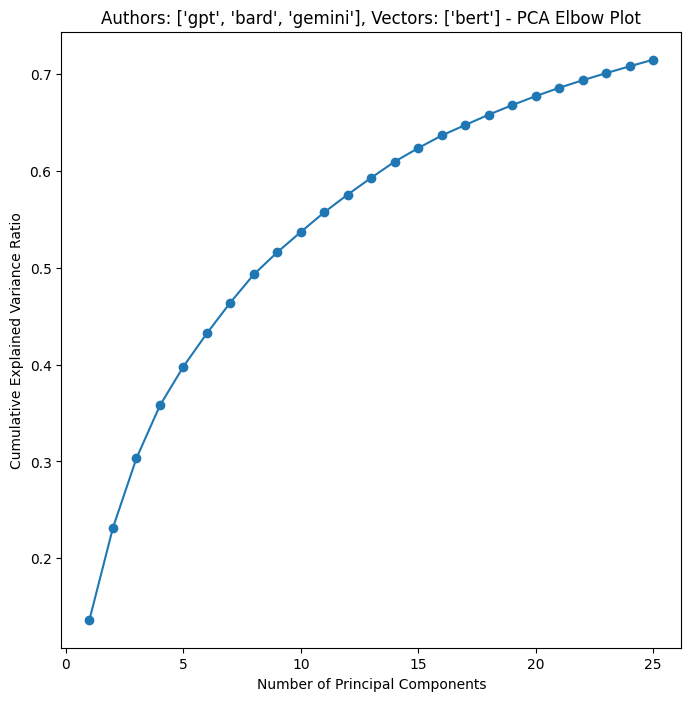

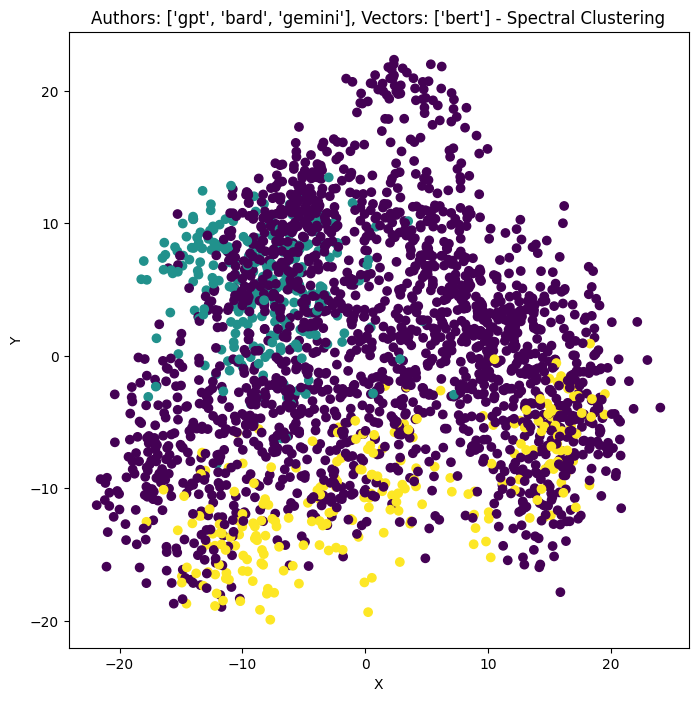

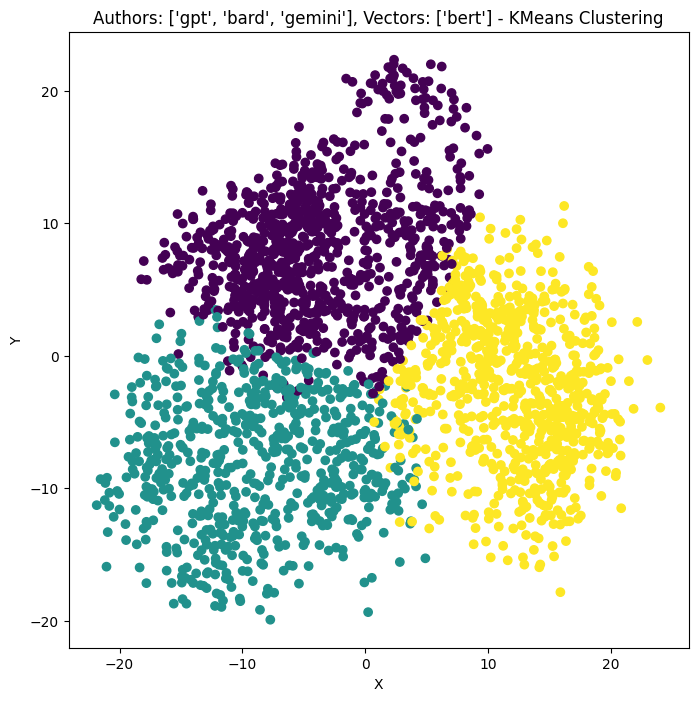

['common', 'function', 'bert'] scores:
KMeans Adjusted Rand Index: 0.3396090520033515
KMeans Rand Index: 0.7041763929415034
Spectral Clustering Adjusted Rand Index: 0.0215767134129181
Spectral Clustering Rand Index: 0.4456464499096846


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


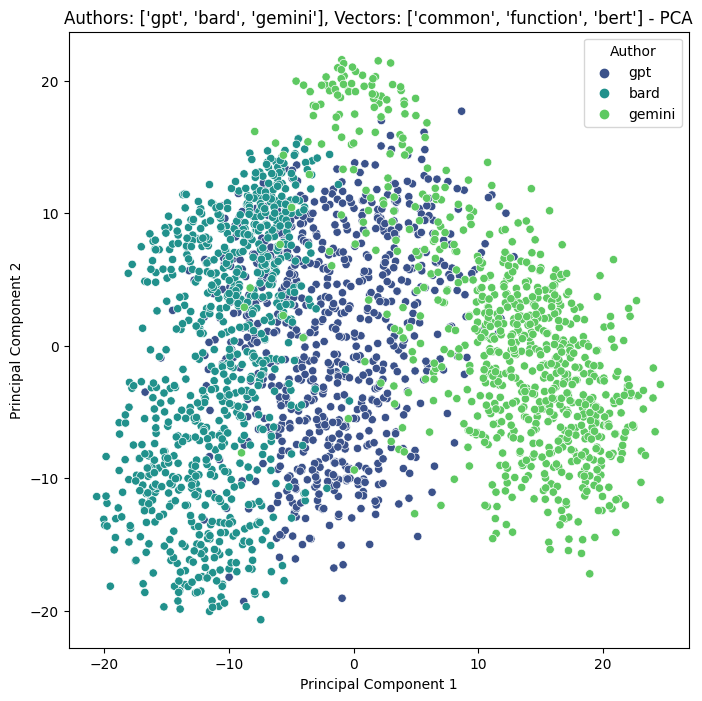

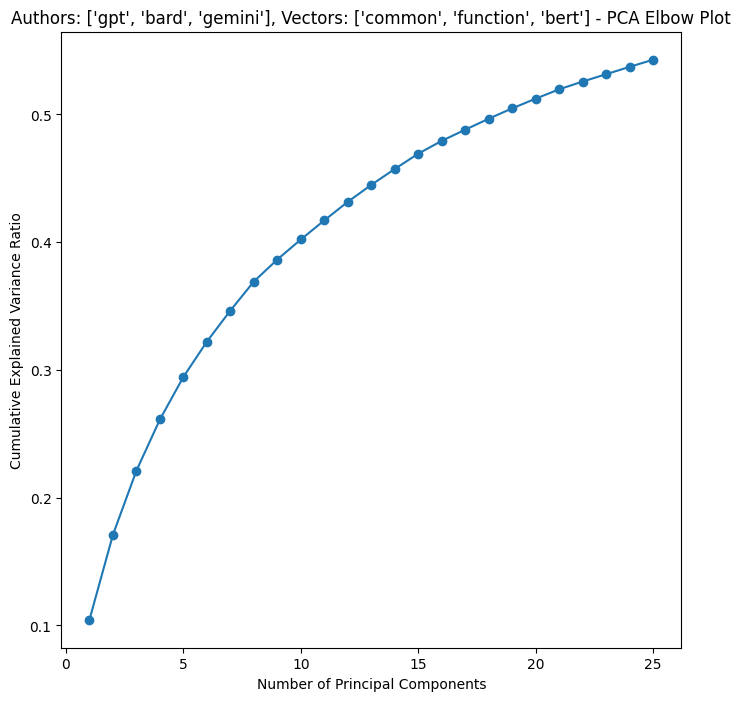

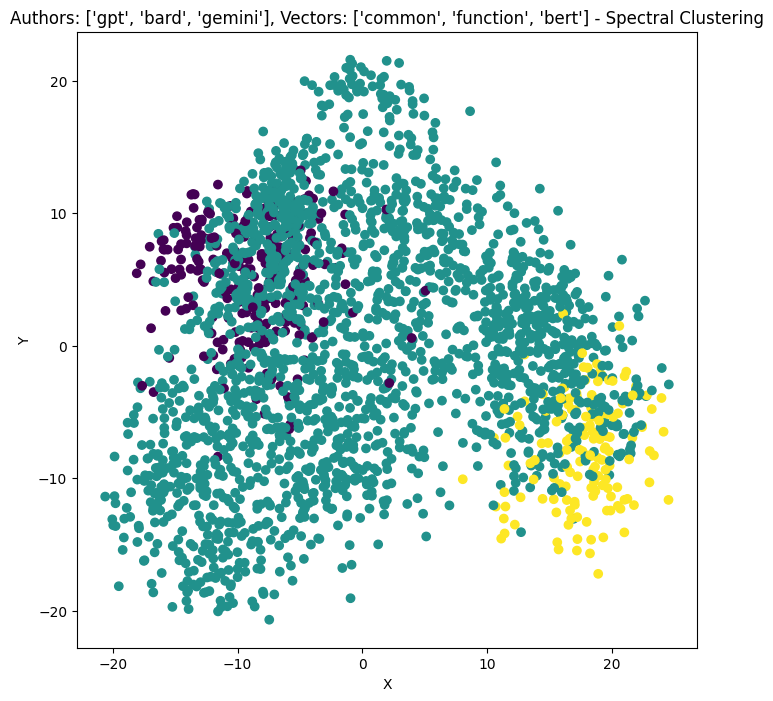

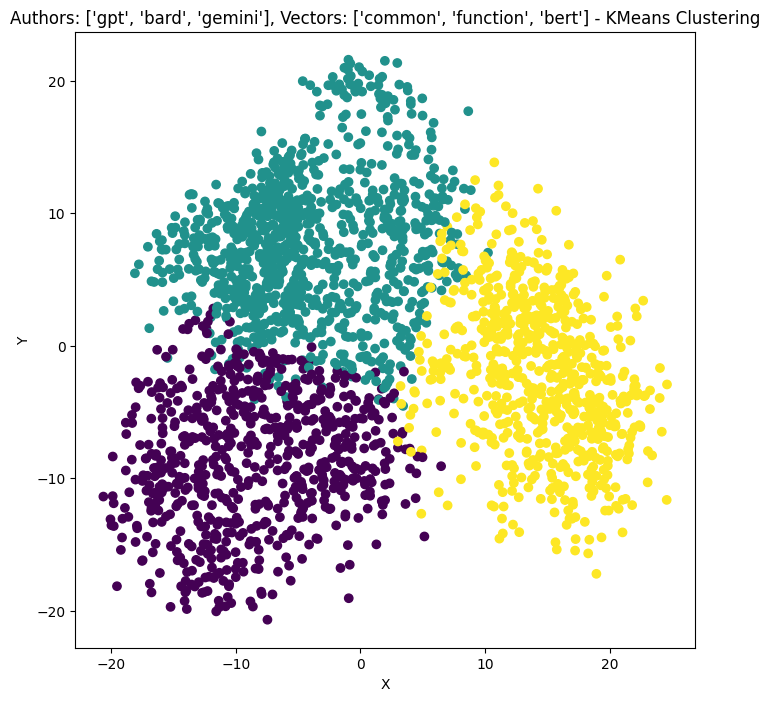

In [14]:
comp = []
for vector_names in list_of_vector_names:
    res = cluster_graph(["gpt", "bard", "gemini"], vector_names)
    comp.append(res)
results_table.append(comp)

# Reddit vs. GPT (temp 1.0) vs. Bard vs. Gemini

['common'] scores:
KMeans Adjusted Rand Index: 0.17211573523618223
KMeans Rand Index: 0.6541757189746796
Spectral Clustering Adjusted Rand Index: 0.02632714111428872
Spectral Clustering Rand Index: 0.4117628555798687


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


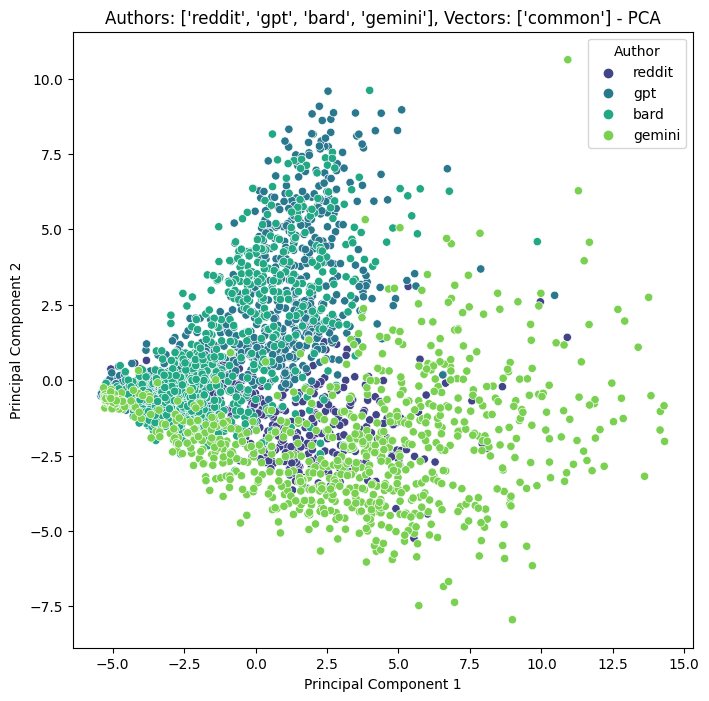

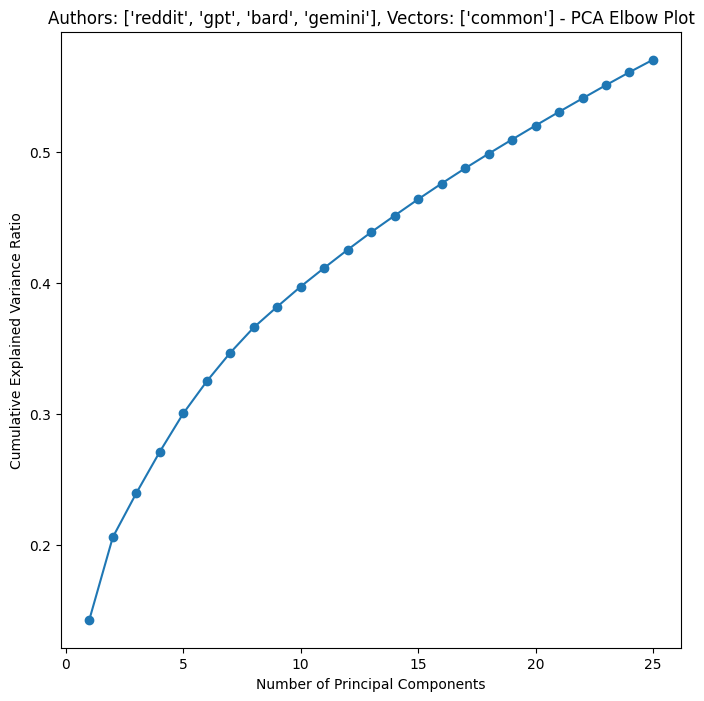

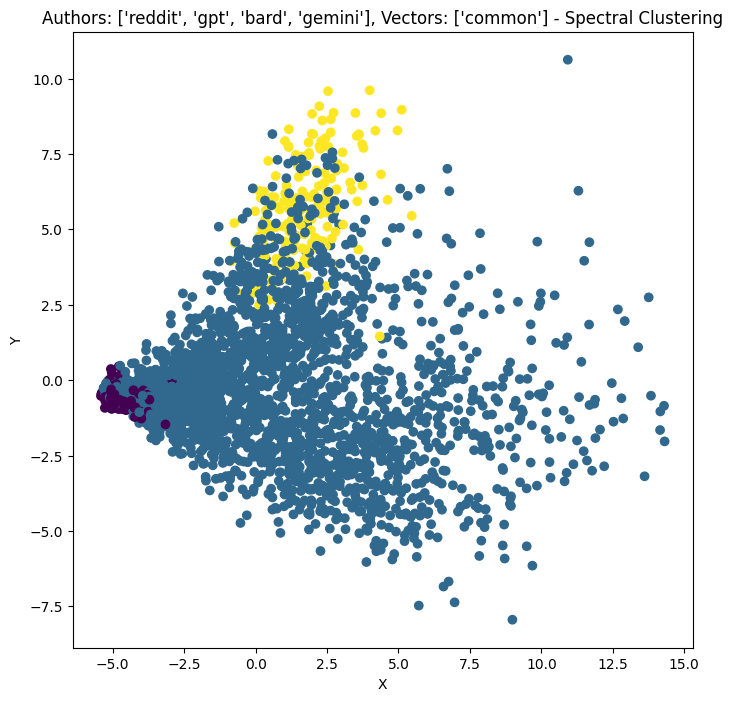

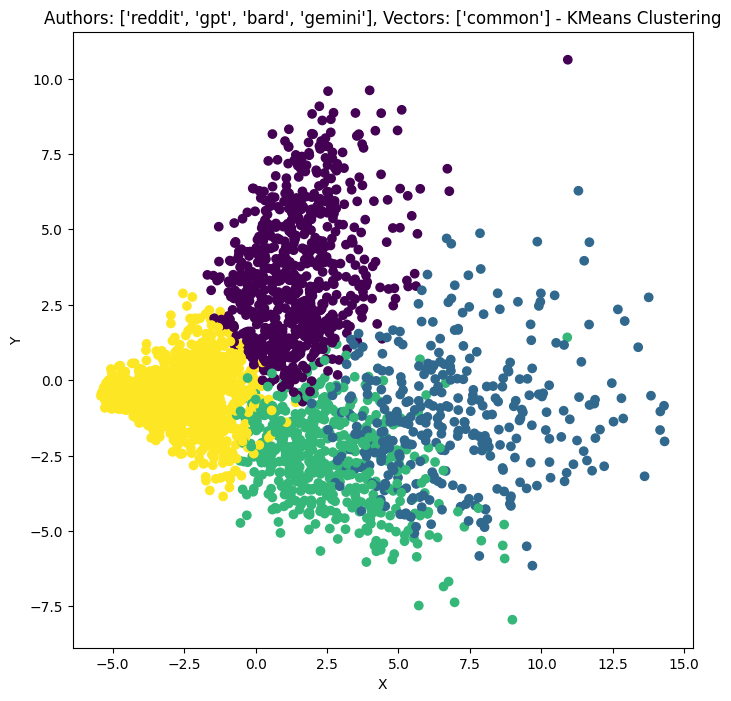

['function'] scores:
KMeans Adjusted Rand Index: 0.17418980902543207
KMeans Rand Index: 0.6508742966552048
Spectral Clustering Adjusted Rand Index: 0.009606290678443595
Spectral Clustering Rand Index: 0.3293695295404814


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


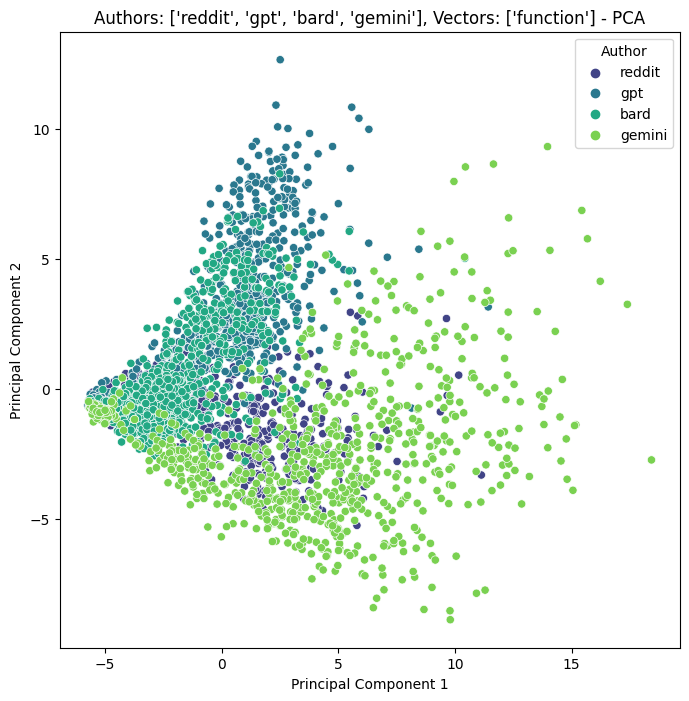

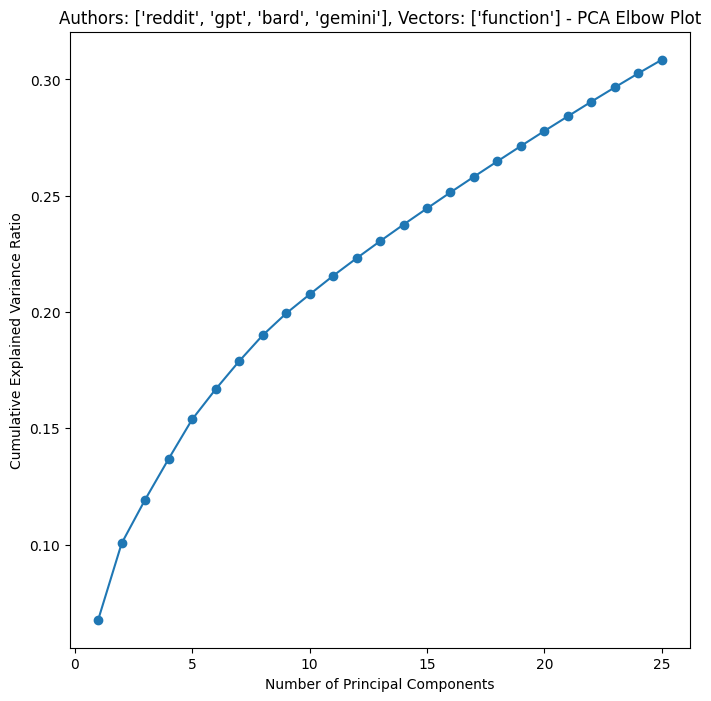

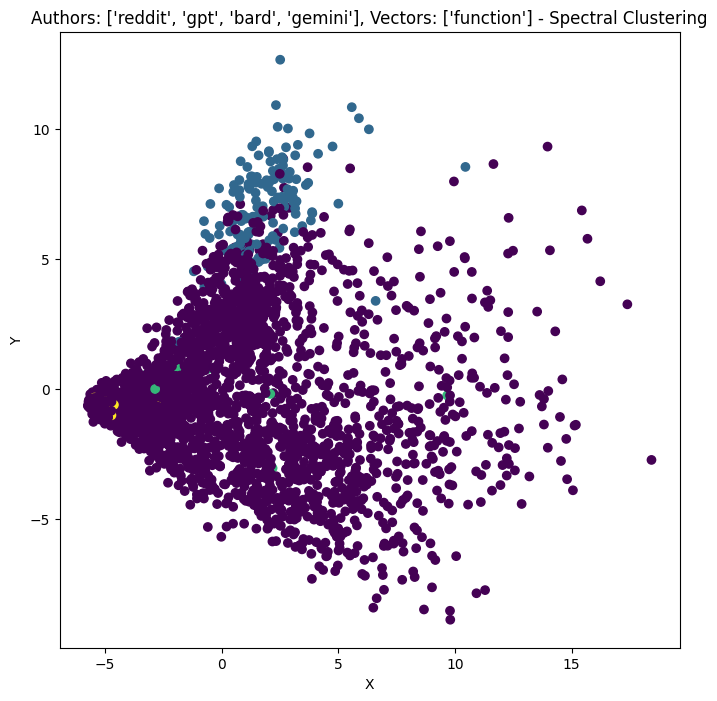

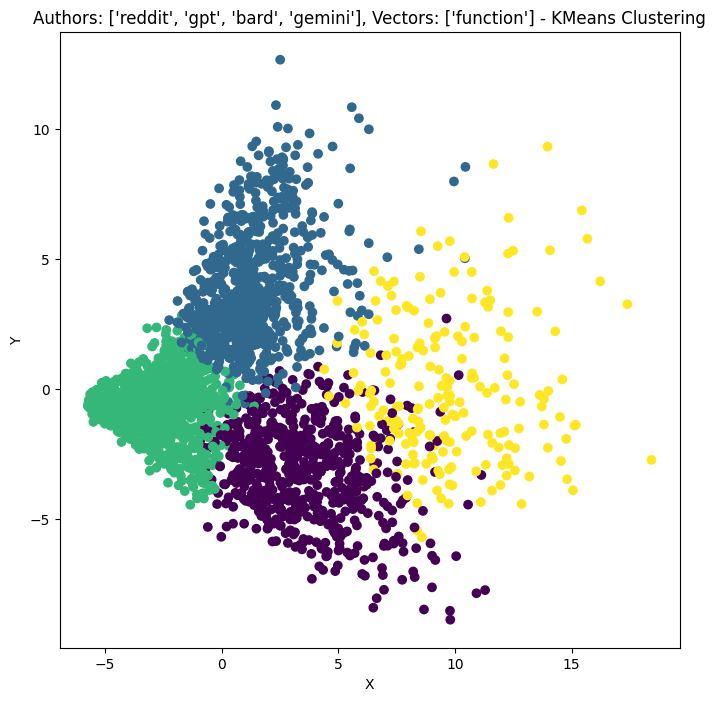

['common', 'function'] scores:
KMeans Adjusted Rand Index: 0.17355284871404741
KMeans Rand Index: 0.6511851359799937
Spectral Clustering Adjusted Rand Index: 0.011125198926604084
Spectral Clustering Rand Index: 0.33322932947796186


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


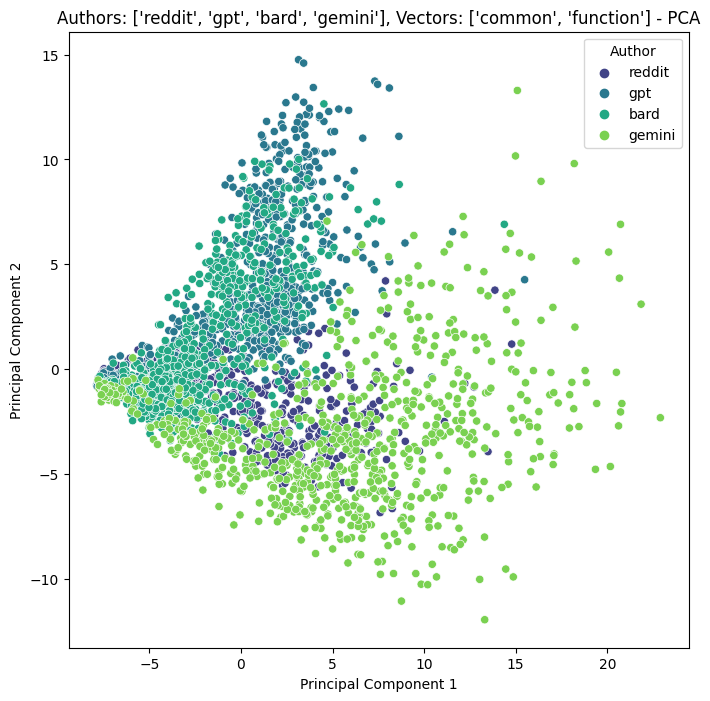

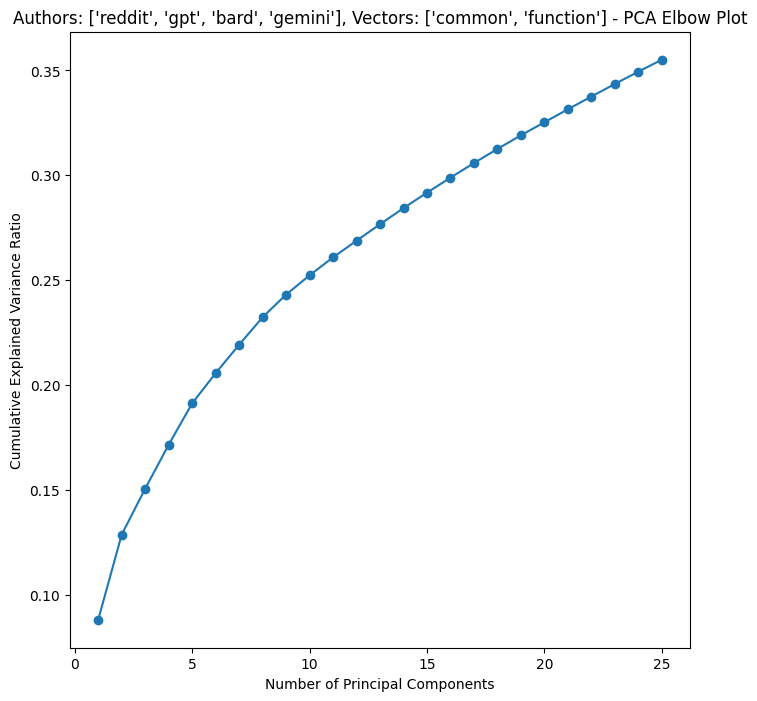

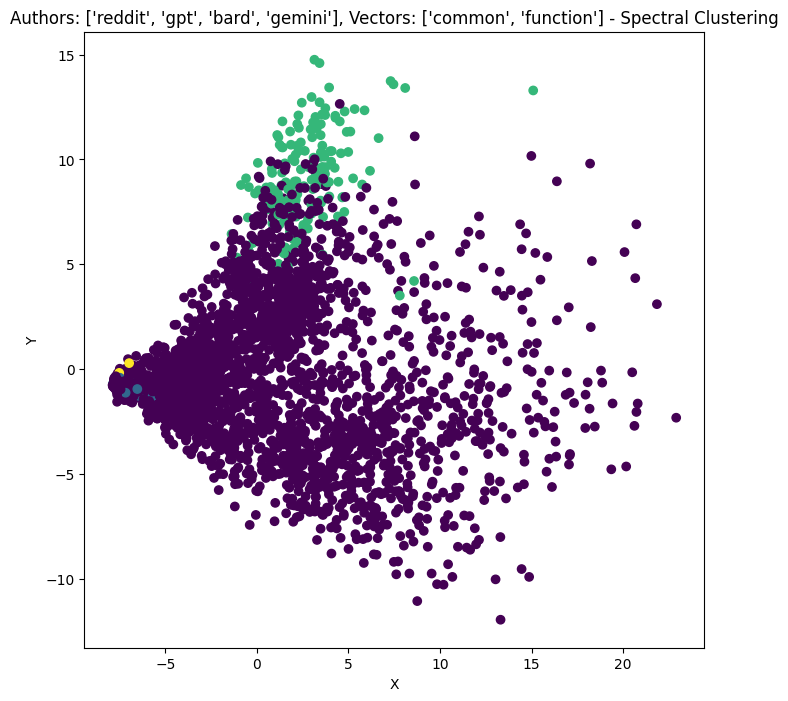

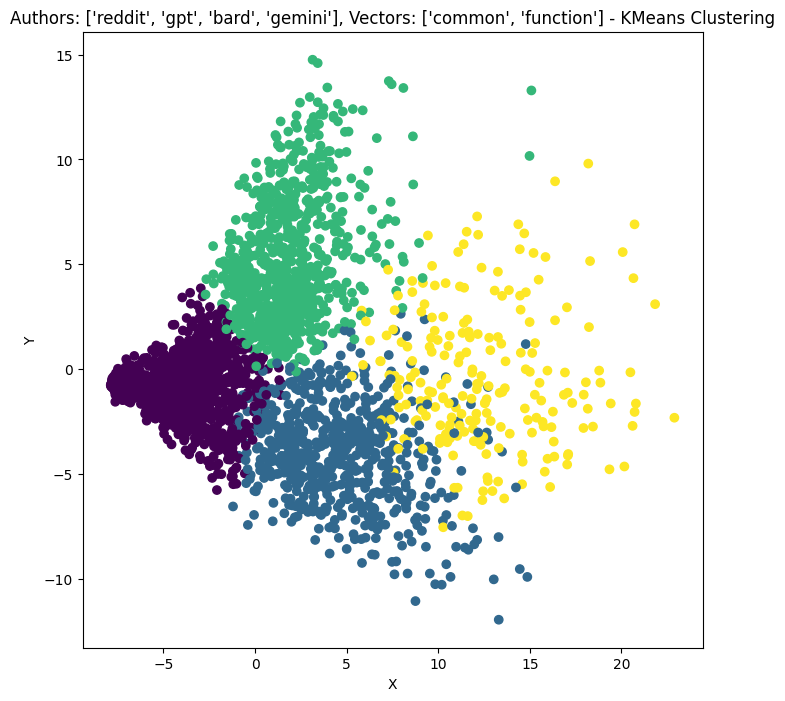

['bert'] scores:
KMeans Adjusted Rand Index: 0.32970353859701673
KMeans Rand Index: 0.7348917630509534
Spectral Clustering Adjusted Rand Index: 0.03032088415361468
Spectral Clustering Rand Index: 0.43278036105032824


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


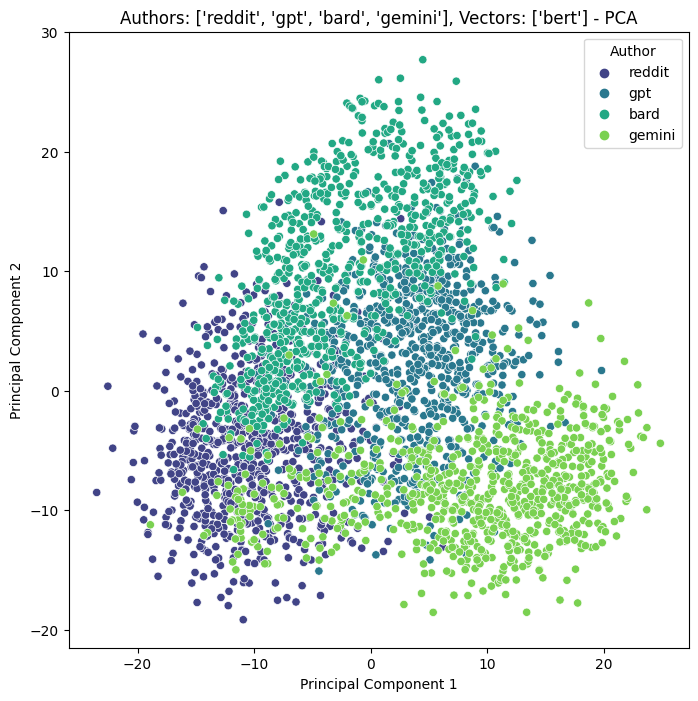

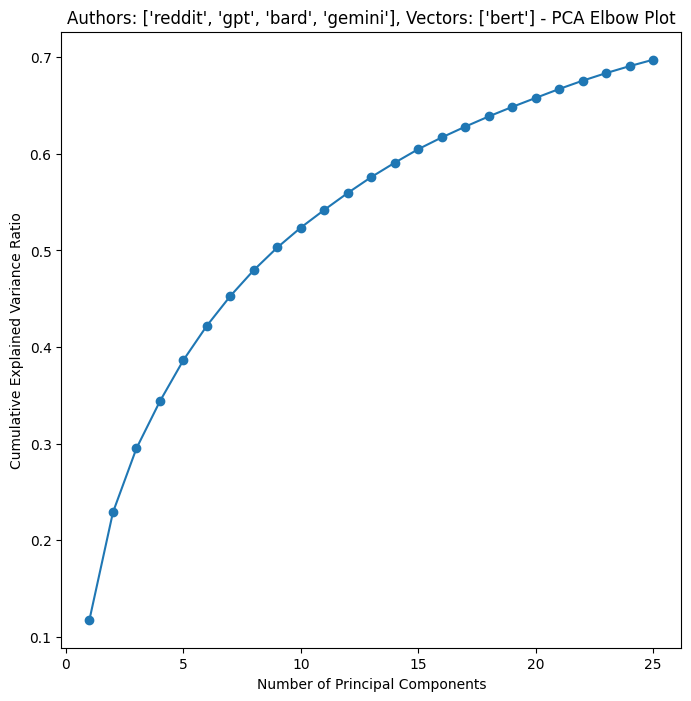

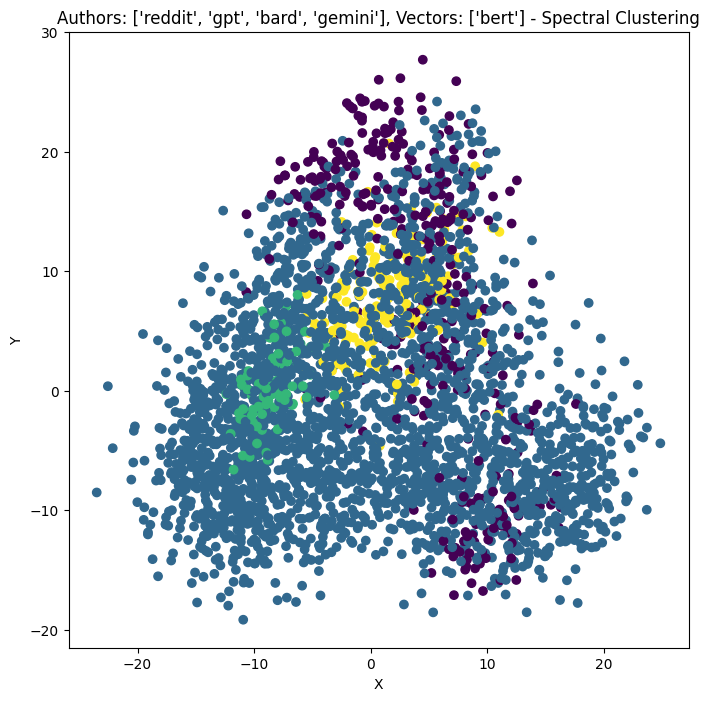

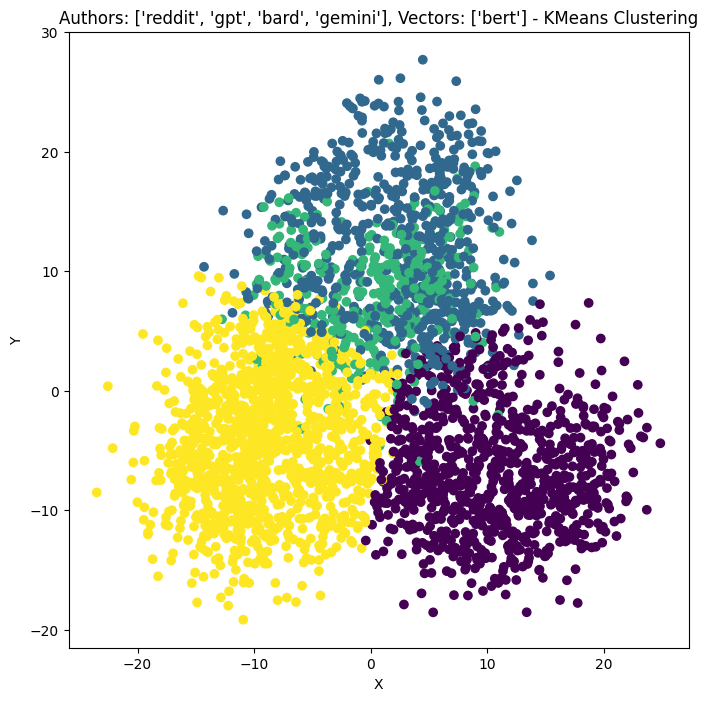

['common', 'function', 'bert'] scores:
KMeans Adjusted Rand Index: 0.4899424003575782
KMeans Rand Index: 0.805605071897468
Spectral Clustering Adjusted Rand Index: 0.01905666237228725
Spectral Clustering Rand Index: 0.39845322757111595


/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/seaborn/_core.py:1225: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


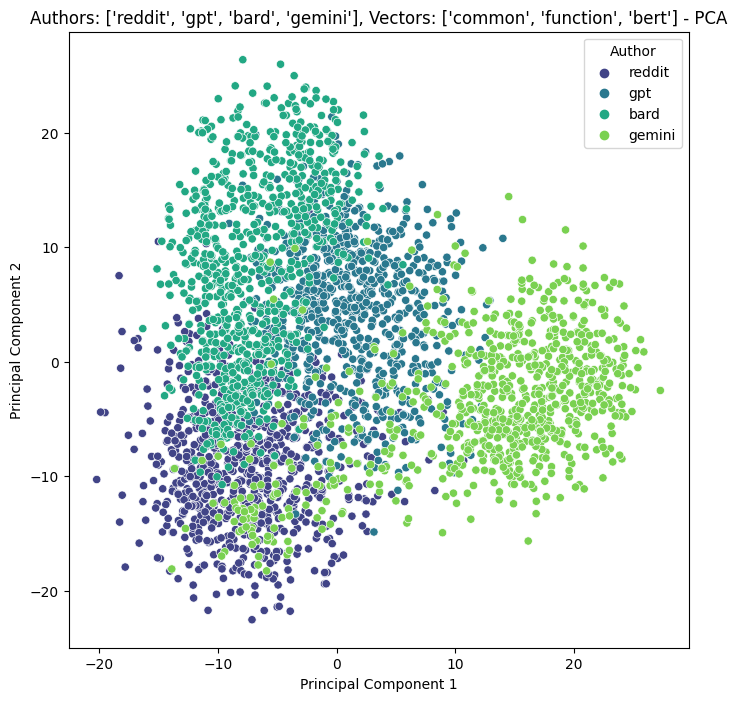

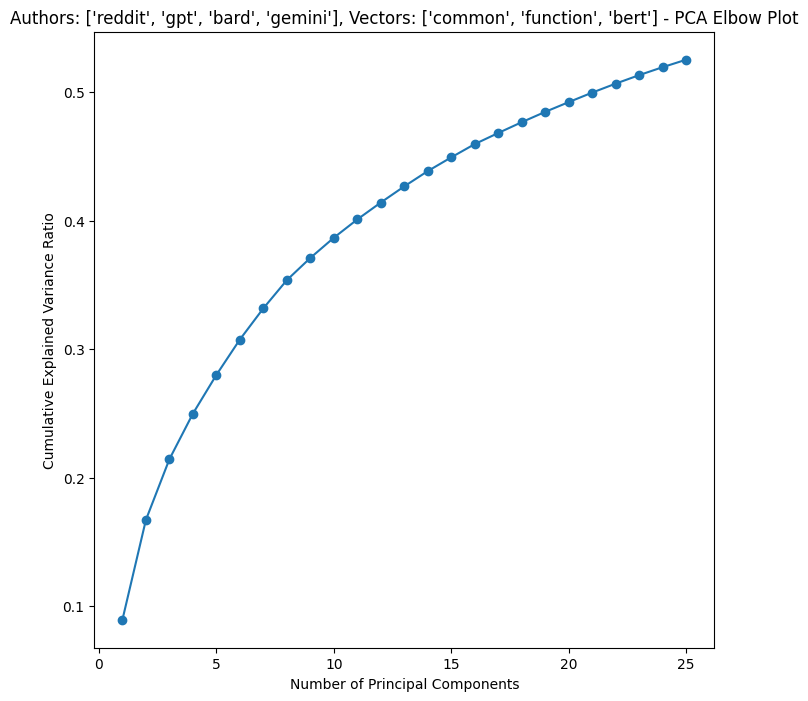

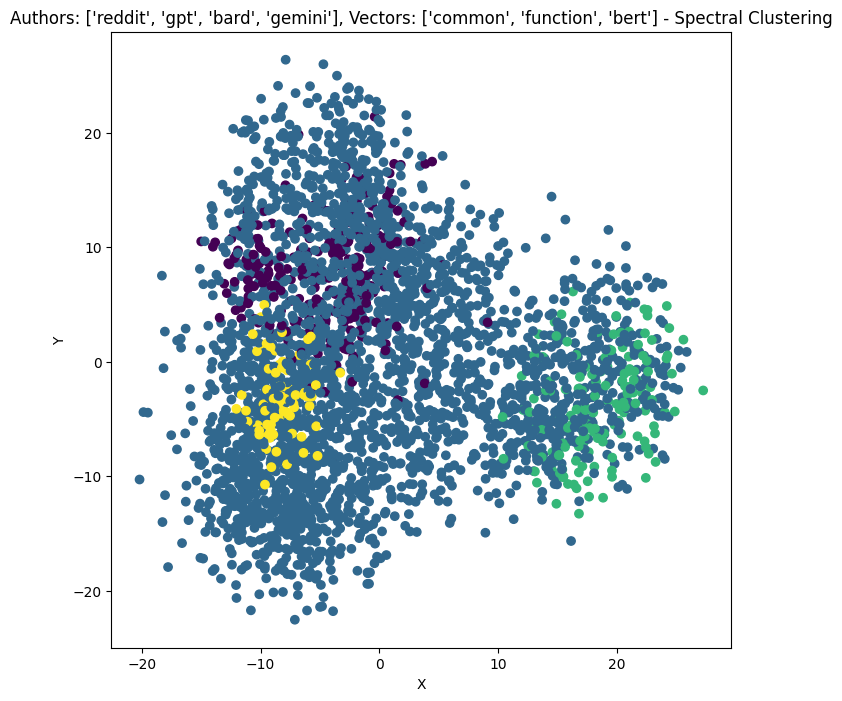

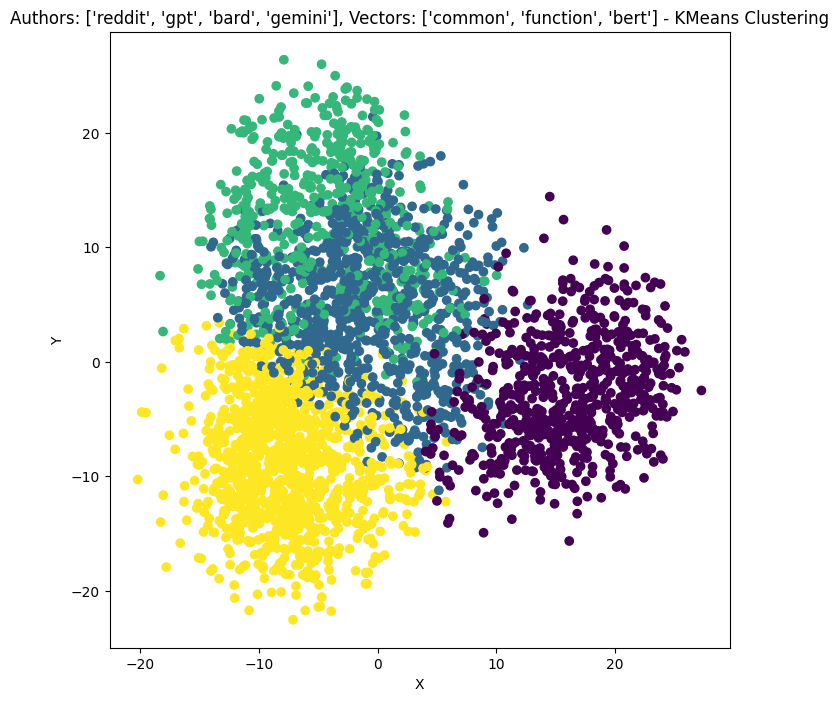

In [25]:
comp = []
for vector_names in list_of_vector_names:
    res = cluster_graph(["reddit", "gpt", "bard", "gemini"], vector_names)
    comp.append(res)
results_table.append(comp)

# GPT Temps

In [15]:
temps = ["0.1", "0.2", "0.3", "0.4", "0.5", "0.6", "0.7", "0.8",
         "0.9", "1.0", "1.1", "1.2", "1.3", "1.4", "1.5"]

# Reddit vs. GPT various temps

/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/sklearn/manifold/_spectral_embedding.py:273: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/sklearn/manifold/_spectral_embedding.py:273: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


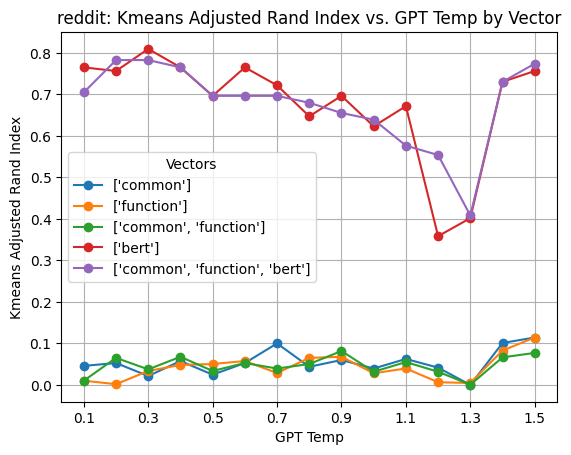

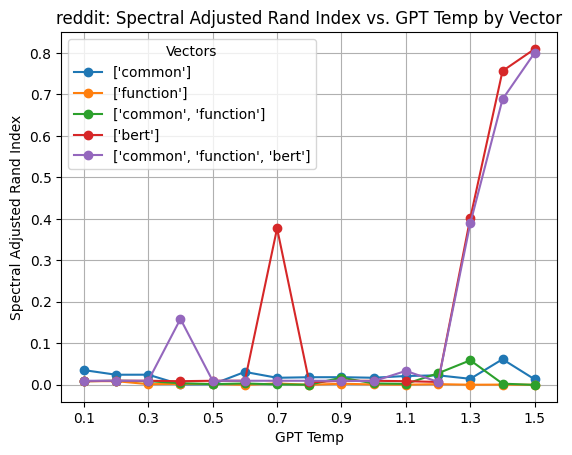

In [16]:
various_temps("reddit")

# Bard vs. GPT various temps

/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/sklearn/manifold/_spectral_embedding.py:273: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/sklearn/manifold/_spectral_embedding.py:273: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/sklearn/manifold/_spectral_embedding.py:273: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


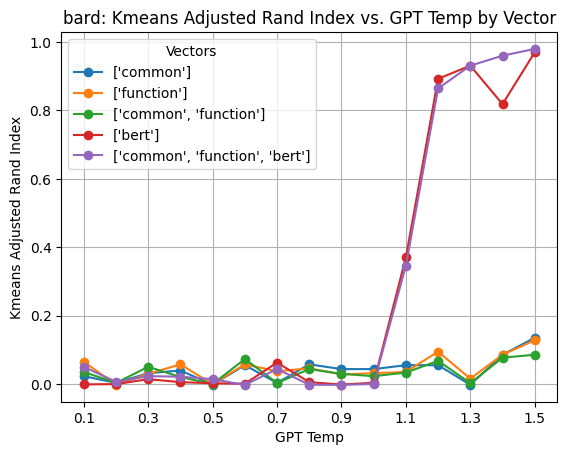

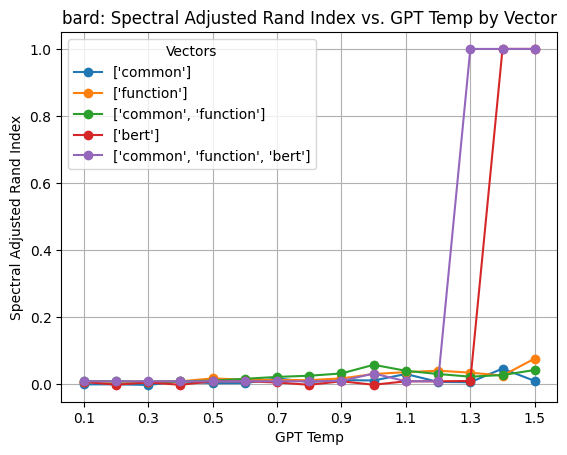

In [17]:
various_temps("bard")

# Gemini vs. GPT various temps

/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/sklearn/manifold/_spectral_embedding.py:273: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/sklearn/manifold/_spectral_embedding.py:273: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/sklearn/manifold/_spectral_embedding.py:273: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(
/Users/benjaminshaman/anaconda3/lib/python3.11/site-packages/sklearn/manifold/_spectral_embedding.py:273: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


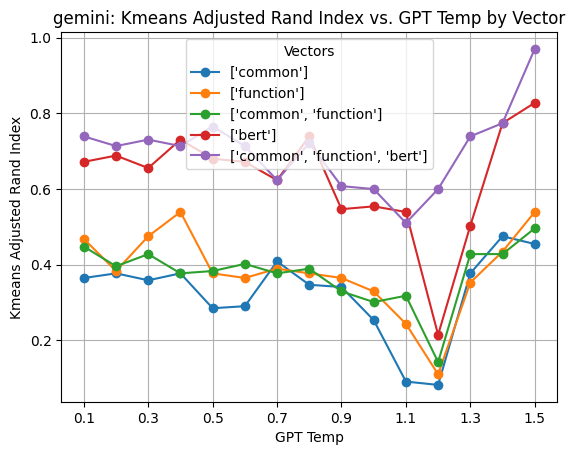

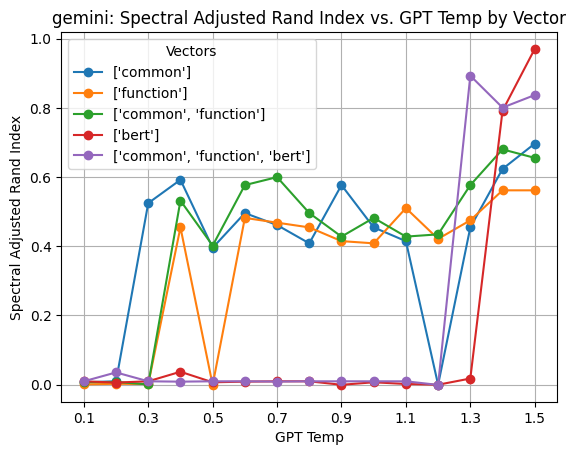

In [18]:
various_temps("gemini")

# Final Results

In [26]:
results_df = pd.DataFrame(results_table)
results_df.columns = [', '.join(map(str, vectors)) for vectors in list_of_vector_names]

stats = [item for item in ["Kmeans Adjusted Rand Index", "Kmeans Rand Index", "Spectral Adjusted Rand Index", "Spectral Rand Index"] for _ in range(11)]
results_df = results_df.explode(["common", "function", "common, function", "bert", "common, function, bert"])
results_df.insert(0, "stat", stats)
results_df.index = ["Reddit vs. GPT (temp 1.0)", "Reddit vs. Bard", "Reddit vs. Gemini",
                   "GPT (temp 1.0) vs. Bard", "GPT (temp 1.0) vs. Gemini", "Bard vs. Gemini",
                   "Reddit vs. GPT (temp 1.0) vs. Bard", "Reddit vs. GPT (temp 1.0) vs. Gemini",
                   "Reddit vs. Bard vs. Gemini", "GPT (temp 1.0) vs. Bard vs. Gemini",
                   "Reddit vs. GPT (temp 1.0) vs. Bard vs. Gemini"] * 4
results_df = results_df.reset_index()
results_df = results_df.rename(columns = {"index" : "authors"})
results_df

,authors,stat,common,function,"common, function",bert,"common, function, bert"
0,Reddit vs. GPT (temp 1.0),Kmeans Adjusted Rand Index,0.082803,0.085979,0.081365,0.839414,0.91197
1,Reddit vs. Bard,Kmeans Adjusted Rand Index,0.541402,0.542859,0.540682,0.919707,0.955985
2,Reddit vs. Gemini,Kmeans Adjusted Rand Index,0.016547,0.00124,0.00163,0.049269,0.049269
3,GPT (temp 1.0) vs. Bard,Kmeans Adjusted Rand Index,0.508143,0.500345,0.500539,0.524456,0.524456
4,GPT (temp 1.0) vs. Gemini,Kmeans Adjusted Rand Index,-0.000346,-0.000543,-0.000539,0.443567,0.472349
5,Bard vs. Gemini,Kmeans Adjusted Rand Index,0.4998,0.499694,0.4997,0.721771,0.736163
6,Reddit vs. GPT (temp 1.0) vs. Bard,Kmeans Adjusted Rand Index,0.045452,0.000241,0.000163,0.008447,0.008678
7,Reddit vs. GPT (temp 1.0) vs. Gemini,Kmeans Adjusted Rand Index,0.522546,0.499819,0.499782,0.503968,0.504085
8,Reddit vs. Bard vs. Gemini,Kmeans Adjusted Rand Index,0.175885,0.182245,0.182245,0.6722,0.73944
9,GPT (temp 1.0) vs. Bard vs. Gemini,Kmeans Adjusted Rand Index,0.587942,0.591123,0.591123,0.836098,0.869719


In [27]:
# Average improvement on BERT from add style vectors
results_df["common, function, bert"].mean() / results_df.bert.mean()

1.085743072720819

In [34]:
# Proportion of cases where adding style vectors caused an improvement
(results_df["common, function, bert"] > results_df.bert).sum() / 44

0.5681818181818182

In [35]:
# Proportion of cases where adding style vectors made no difference
(results_df["common, function, bert"] == results_df.bert).sum() / 44

0.11363636363636363